## Setup, Loading Data and CDFs

In [1]:
DATA_NAME = 'coco-outdoor' 
TRANSFORM = 'learned'
CHANNEL = ''

In [2]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
learned_outdoor_coco.ipynb


In [3]:
import git
from pathlib import Path
import os

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/brandonmarks/Desktop/hierarchical-bayesian-model-validation/results/case-studies/coco/outdoor/learned'

In [4]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [5]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))
nonskewed_df = pd.read_csv(os.path.join(ROOT_DIR, 'learned-filters', 'nonskewed_filter_idxs_df.csv')).set_index(['dataset', 'num_images', 'num_bootstrap'])
nonskewed_filter_idxs = eval(nonskewed_df.loc[DATA_NAME].sort_values('num_images', ascending=False)['nonskewed_filter_idxs'].iloc[0])
filter_group_map = pd.read_pickle(os.path.join(ROOT_DIR, 'learned-filters', 'filter_group_map.pickle'))

In [6]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 196608000,
 1: 196608000,
 2: 196608000,
 3: 196608000,
 4: 196608000,
 5: 196608000,
 6: 196608000,
 7: 196608000,
 8: 196608000,
 9: 196608000,
 10: 196608000,
 11: 196608000,
 12: 196608000,
 13: 196608000,
 14: 196608000,
 15: 196608000,
 16: 196608000,
 17: 196608000,
 18: 196608000,
 19: 196608000,
 20: 196608000,
 21: 196608000,
 22: 196608000,
 23: 196608000,
 24: 196608000,
 25: 196608000,
 26: 196608000,
 27: 196608000,
 28: 196608000,
 29: 196608000,
 30: 196608000,
 31: 196608000,
 32: 196608000,
 33: 196608000,
 34: 196608000,
 35: 196608000,
 36: 196608000,
 37: 196608000,
 38: 196608000,
 39: 196608000,
 40: 196608000,
 41: 196608000,
 42: 196608000,
 43: 196608000,
 44: 196608000,
 45: 196608000,
 46: 196608000,
 47: 196608000,
 48: 196608000,
 49: 196608000,
 50: 196608000,
 51: 196608000,
 52: 196608000,
 53: 196608000,
 54: 196608000,
 55: 196608000,
 56: 196608000,
 57: 196608000,
 58: 196608000,
 59: 196608000,
 60: 196608000,
 61: 196608000,
 62: 196608000,
 6

Running 12760 CDFs


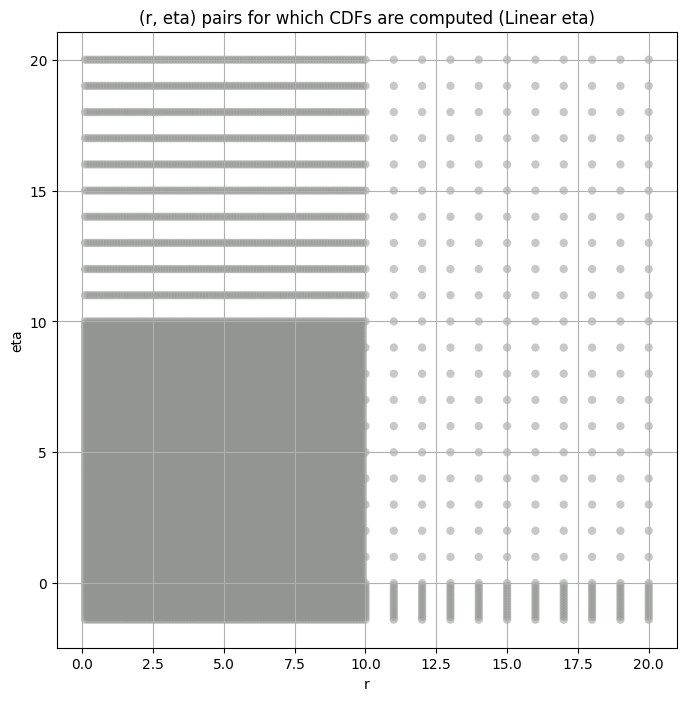

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [7]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [8]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [9]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = filter_group_map[group]

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 1


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 19


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 21


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 35


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 36


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 37


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 42


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 43


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 44


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 45


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 46


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 47


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 48


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 49


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 50


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 51


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 52


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 53


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 54


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 55


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 56


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 57


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 58


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 59


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 60


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 61


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 62


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 63


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,5.587389,3.885470,13.307504,43.956472,5.678748,345.988257,196608000.0,dual_color
1,6.543445,5.507461,8.010498,2.258367,0.206318,46.515398,196608000.0,misc
2,6.842030,4.740584,16.758177,50.019856,7.108069,371.586526,196608000.0,dual_color
3,4.693403,3.106138,13.014913,80.960090,7.116940,401.350471,196608000.0,single_edge
4,8.801267,6.170591,16.023569,23.755599,7.612705,220.589878,196608000.0,dual_color
...,...,...,...,...,...,...,...,...
59,6.993168,5.147639,11.589897,17.092017,4.888674,185.352867,196608000.0,dual_color
60,0.895371,0.619209,2.922394,107.248915,6.033080,506.367796,196608000.0,misc
61,2.702530,1.776317,5.629499,40.835927,7.272000,295.428482,196608000.0,misc


## Initial Grid Search and Hypothesis Test Plots

In [10]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [11]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,5.587389,5.587389,5.077972,4.849297,4.509546
1,6.543445,6.543445,6.359779,6.260551,6.106514
2,6.842030,6.842030,6.134035,5.808119,5.330753
3,4.693403,4.693403,4.096177,3.870382,3.552222
4,8.801267,8.801267,8.143811,7.788591,7.231174
...,...,...,...,...,...
59,6.993168,6.993168,6.523877,6.277028,5.899923
60,0.895371,0.895371,0.787549,0.749987,0.696523
61,2.702530,2.702530,2.414911,2.278946,2.085211


####
Filter_idx  0


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.012192878677725338 5.587389215930188


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.011996797347835486 5.077971933818975


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.012168208194356378 4.849297056899367


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.012551995442041095 4.509545854466201
Number of samples: 100000, Without approximation : 196608000.0


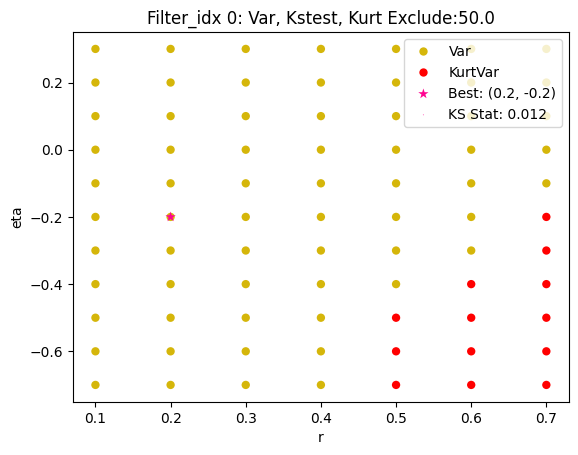

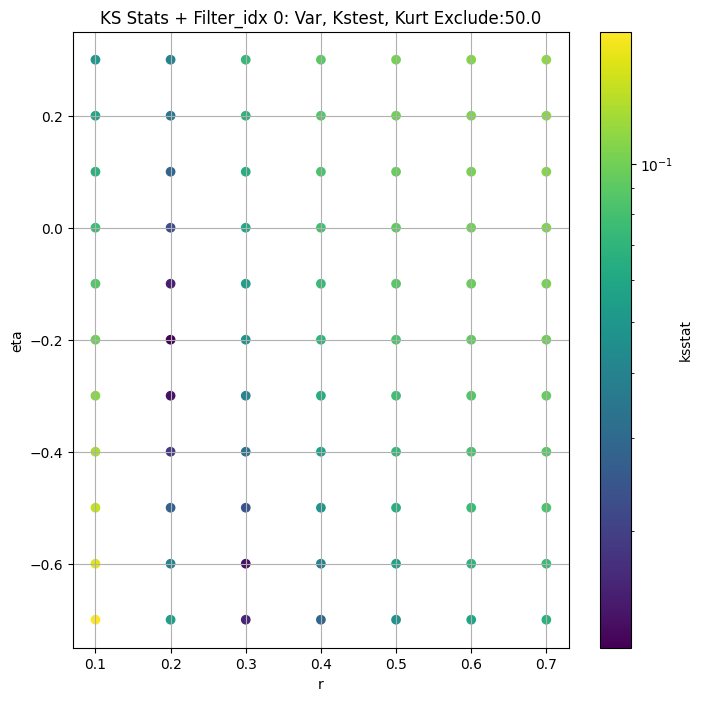

####
Filter_idx  1


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 0 0.011271216834734754 6.54344462754433


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 50 0.012278736666240603 6.359779017313924


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 100 0.012895263194933587 6.260551298677809


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 200 0.014138637977978541 6.106513527914319
Number of samples: 100000, Without approximation : 196608000.0


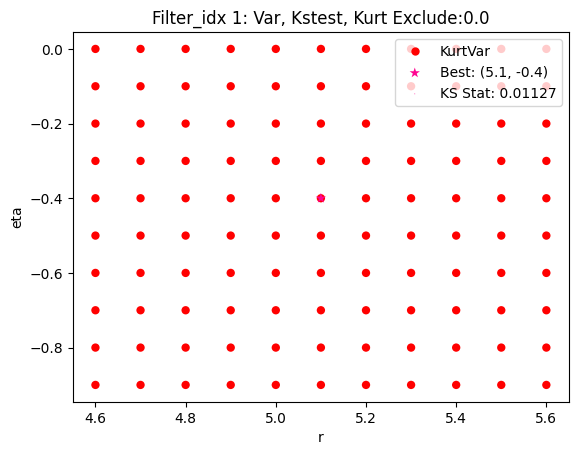

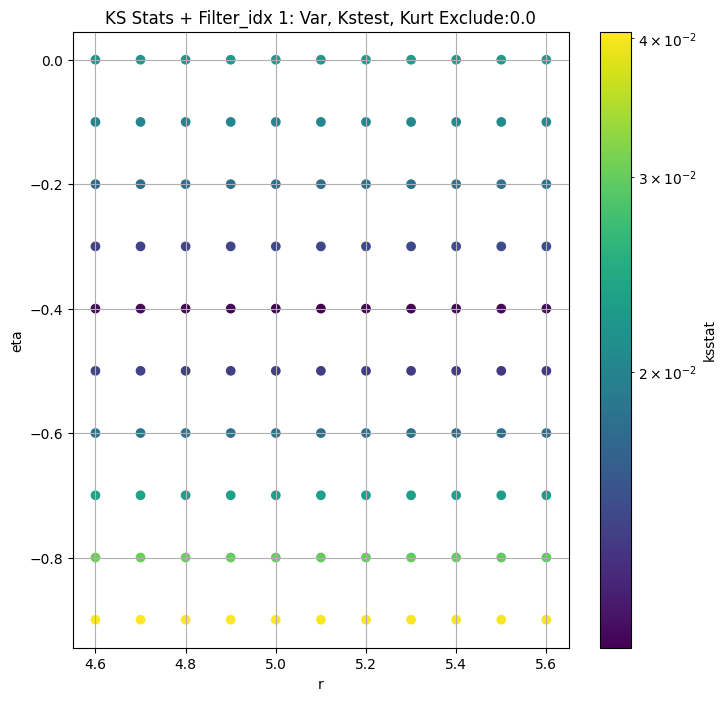

####
Filter_idx  2


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.008743294330837426 6.8420296859164695


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.010047434896778562 6.134035465525453


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.010125446806861671 5.80811925918025


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.010285799915741967 5.33075339354743
Number of samples: 100000, Without approximation : 196608000.0


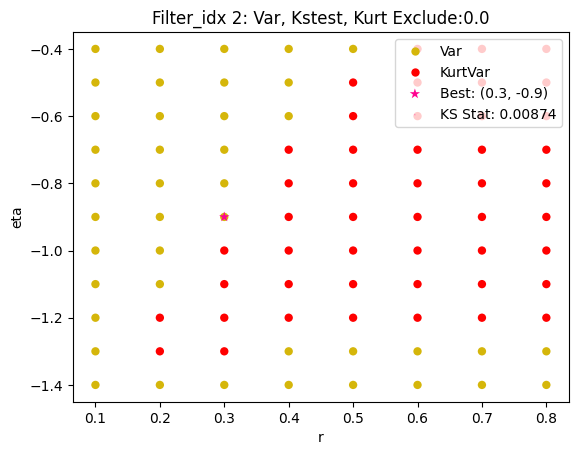

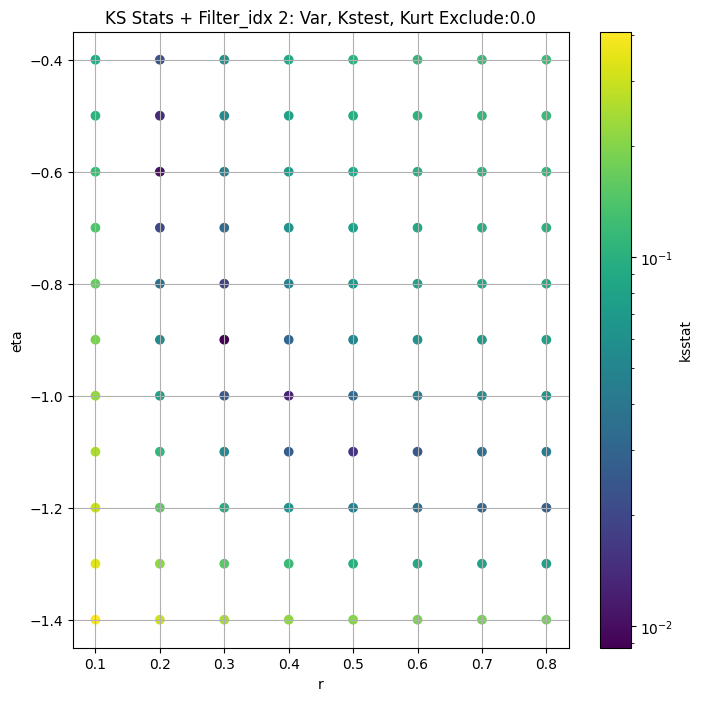

####
Filter_idx  3


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.010002884458544248 4.693403406530854


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.009956239710665948 4.096177312069258


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.008430467580461398 3.8703824255623753


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.010156551076842157 3.5522222533872654
Number of samples: 100000, Without approximation : 196608000.0


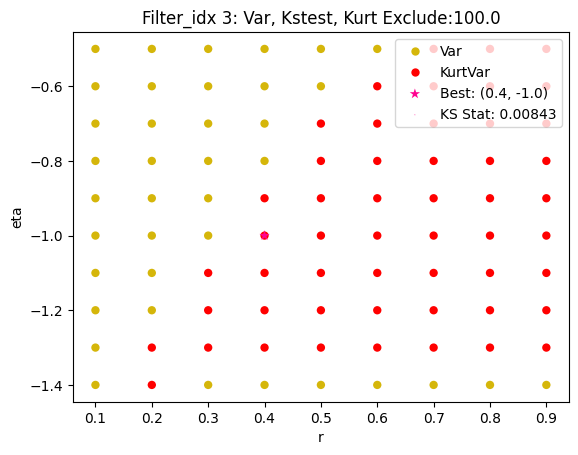

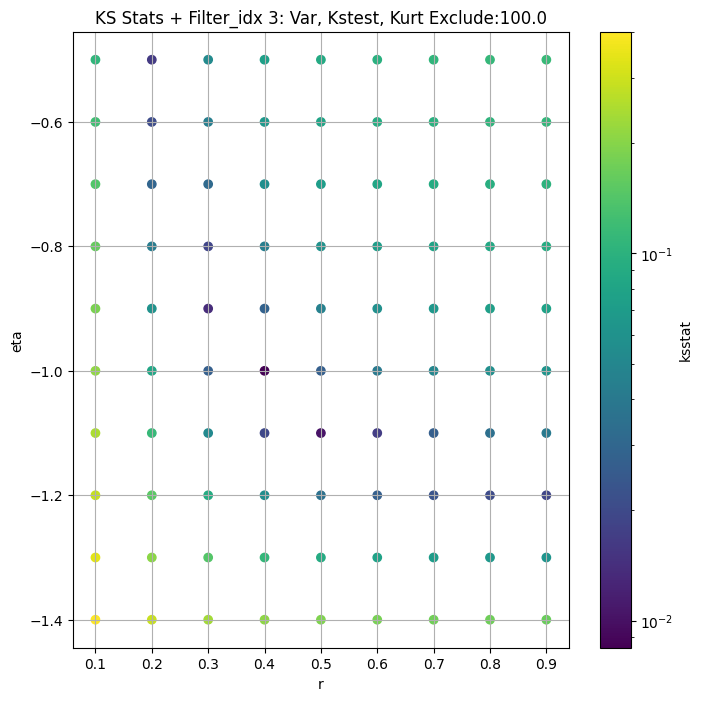

####
Filter_idx  4


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.013567508946098705 8.801267447485516


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.01283387672941172 8.143811124854903


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.010901756863743617 7.788591074141813


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.012584715992090767 7.231173735014925
Number of samples: 100000, Without approximation : 196608000.0


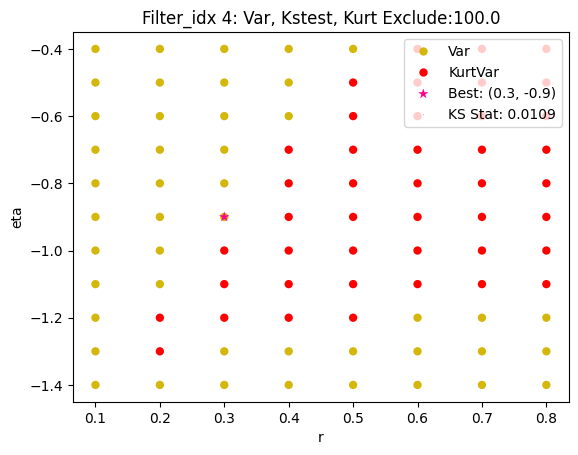

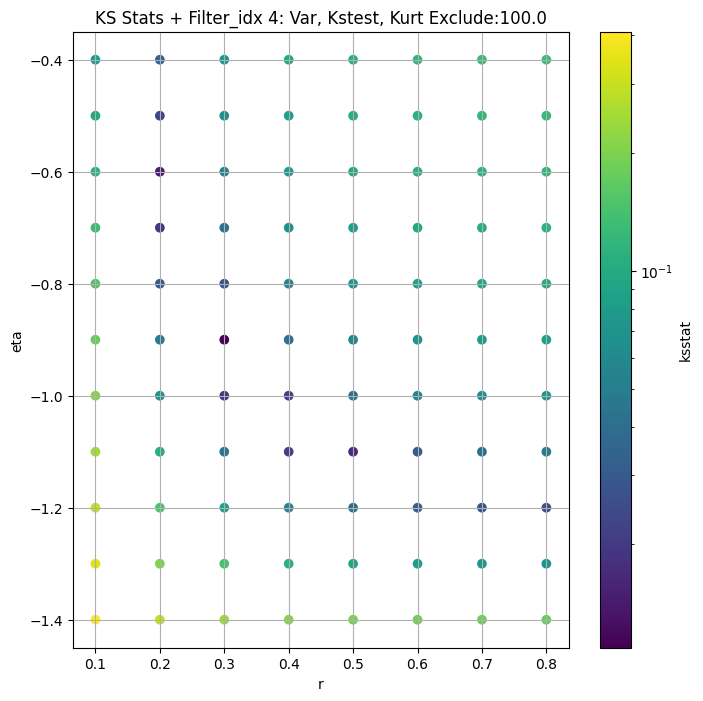

####
Filter_idx  5


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.015668137039559826 5.643842373468628


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.015261226969941588 5.268535223583838


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.01546233969887617 5.070979136279664


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.01712442607045883 4.762041908358303
Number of samples: 100000, Without approximation : 196608000.0


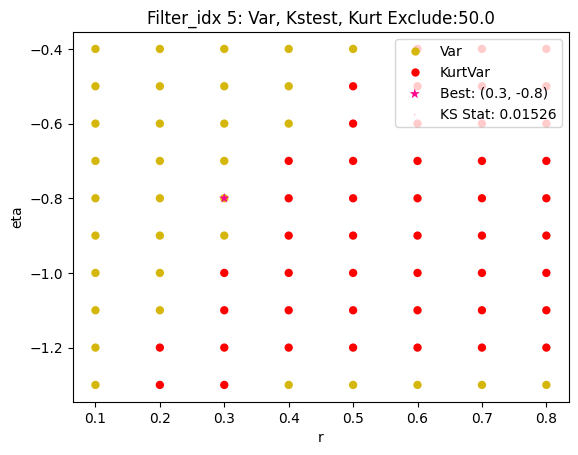

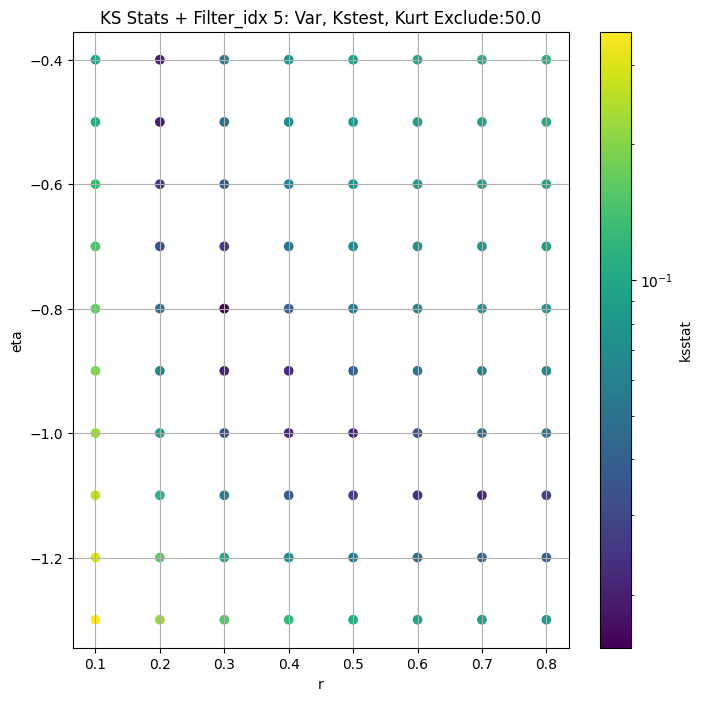

####
Filter_idx  6


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.00851132462548132 2.878008310835161


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.00741539122201107 2.575842760618245


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.00938603109862457 2.4541745659327416


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.008546670621472297 2.279369018987412
Number of samples: 100000, Without approximation : 196608000.0


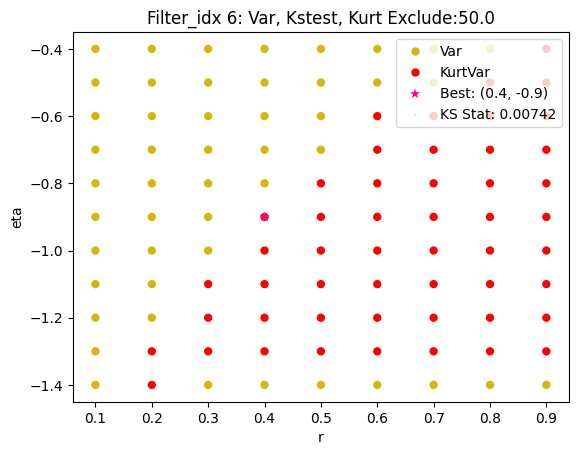

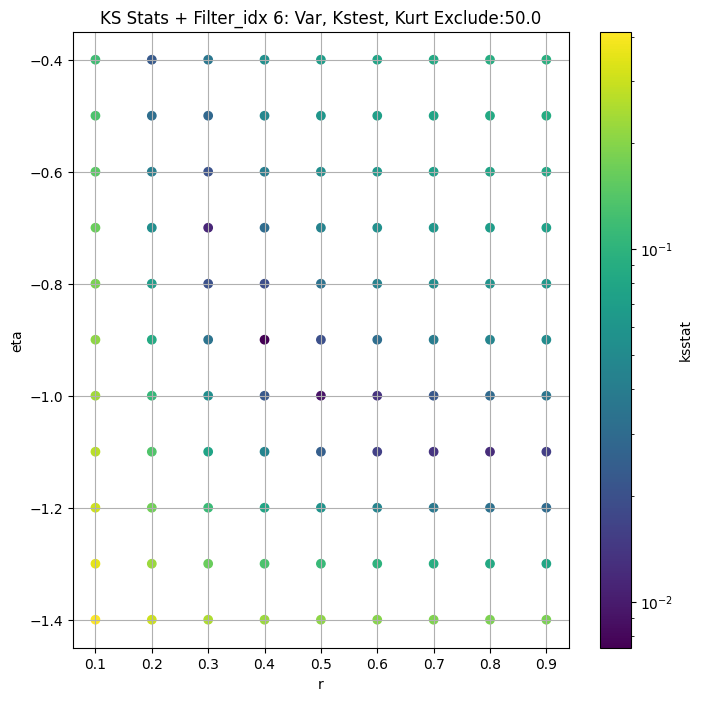

####
Filter_idx  7


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.010127088399399908 3.4521114675605724


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.010126921811231093 3.3129633900626403


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.01012718169714516 3.2472362599907196


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.010126984299733133 3.145822476931141
Number of samples: 100000, Without approximation : 196608000.0


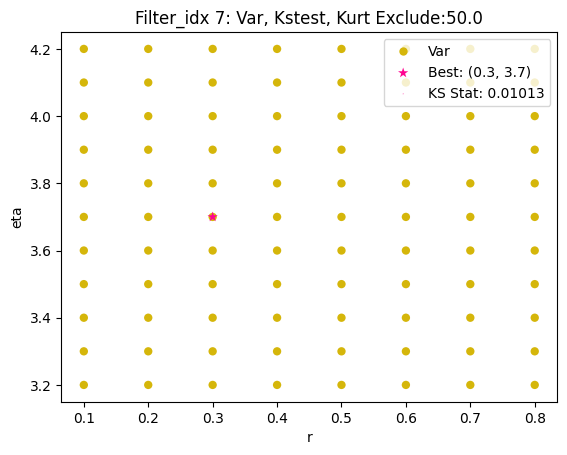

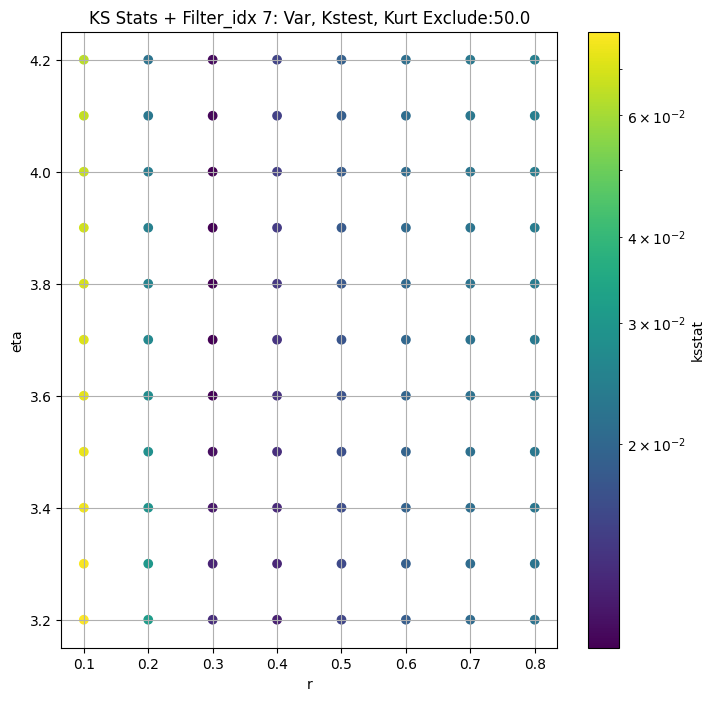

####
Filter_idx  8


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.008650524138450022 0.4191771402520714


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.007122007603720934 0.3658933975876729


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.007918037520554803 0.3497388556388851


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.008782949587229007 0.3265009567991746
Number of samples: 100000, Without approximation : 196608000.0


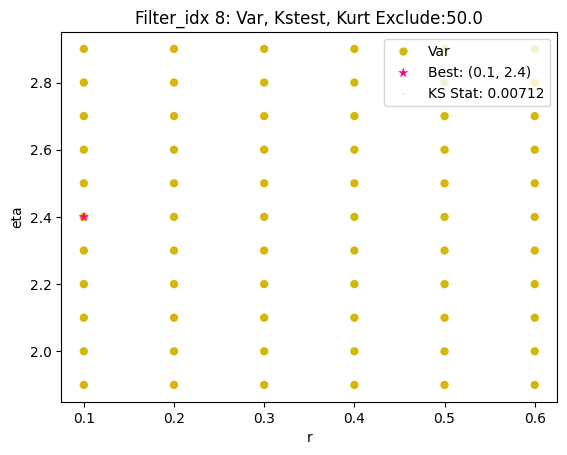

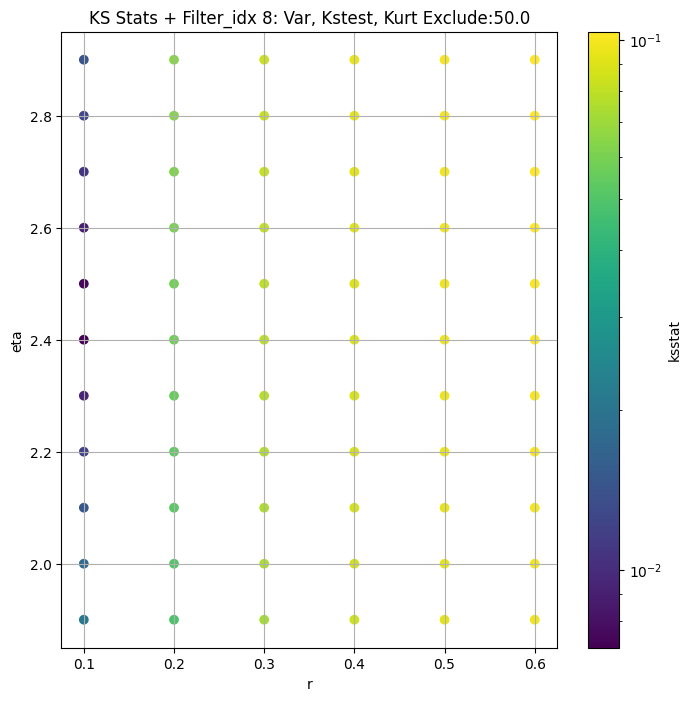

####
Filter_idx  9


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.016353162891614592 2.967988228683067


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.0129467240826589 2.5499188643951003


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.011566548506654839 2.3888317693321537


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.01455748631908134 2.170125451683052
Number of samples: 100000, Without approximation : 196608000.0


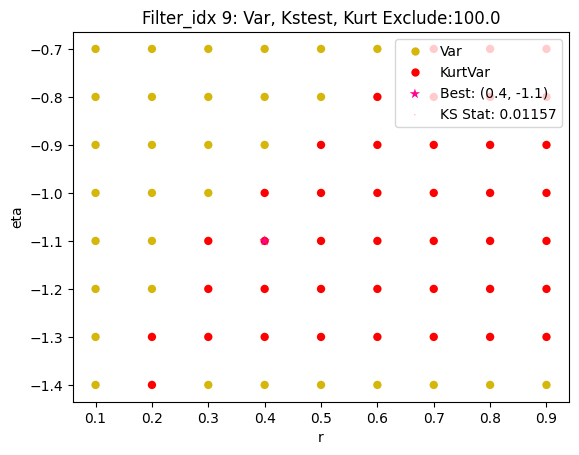

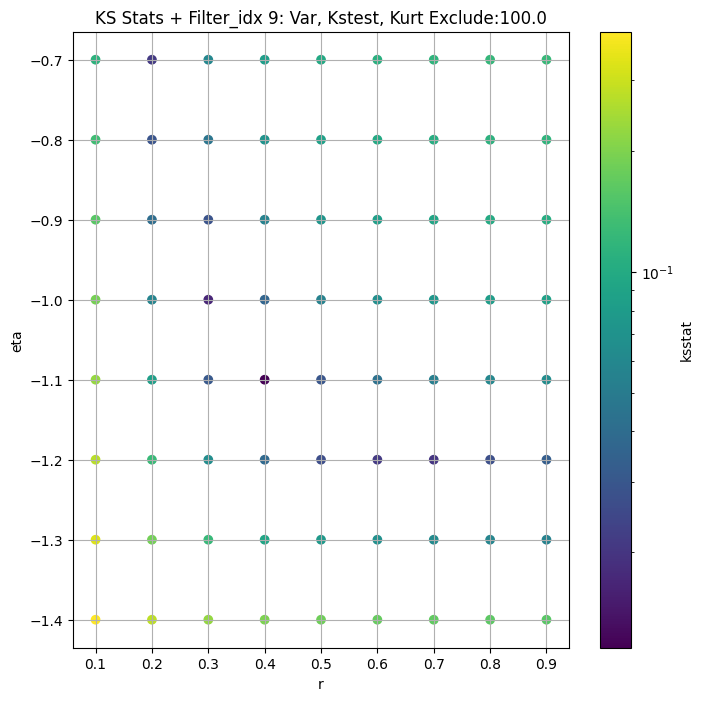

####
Filter_idx  10


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.007762699583879651 3.462142868504575


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.009293116611684749 3.093672665495139


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.008054436608948112 2.9508876037448193


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.008255859021719936 2.74301690798585
Number of samples: 100000, Without approximation : 196608000.0


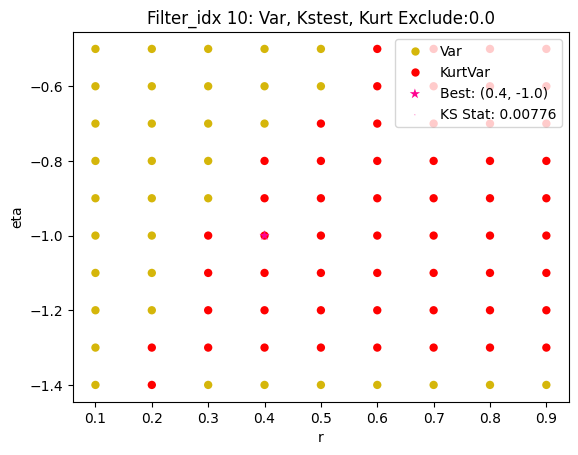

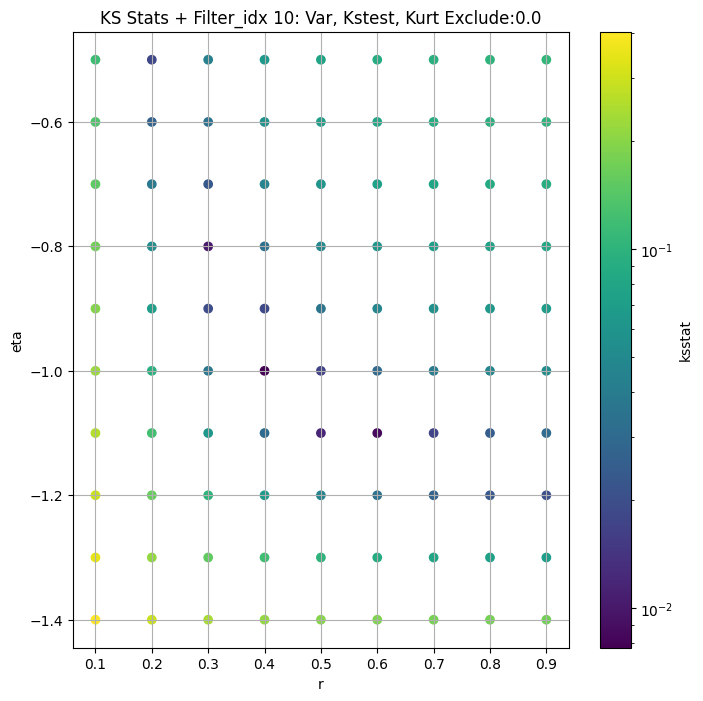

####
Filter_idx  11


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.012362982191430116 2.6180513327338337


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.012035714039821288 2.2776301718627687


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.012574828206015187 2.1496103011612533


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.013512801688917386 1.968415678977717
Number of samples: 100000, Without approximation : 196608000.0


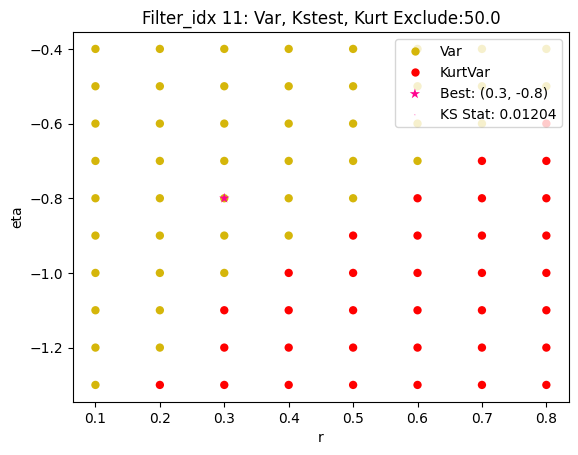

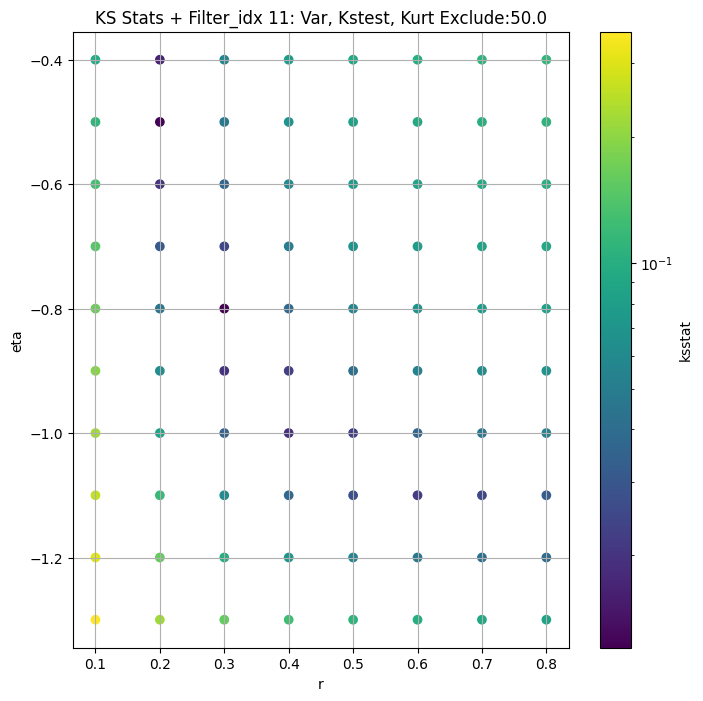

####
Filter_idx  12


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.014617404334352324 2.6971958642966394


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.013320025842754213 2.3434489126074722


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.01430514291432039 2.206240945078547


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.014795012642254968 2.017172926704872
Number of samples: 100000, Without approximation : 196608000.0


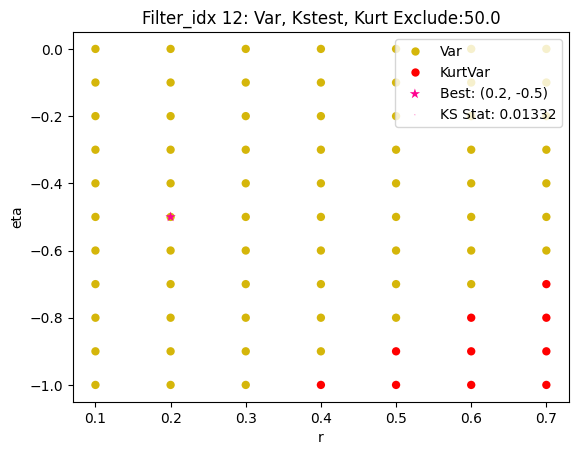

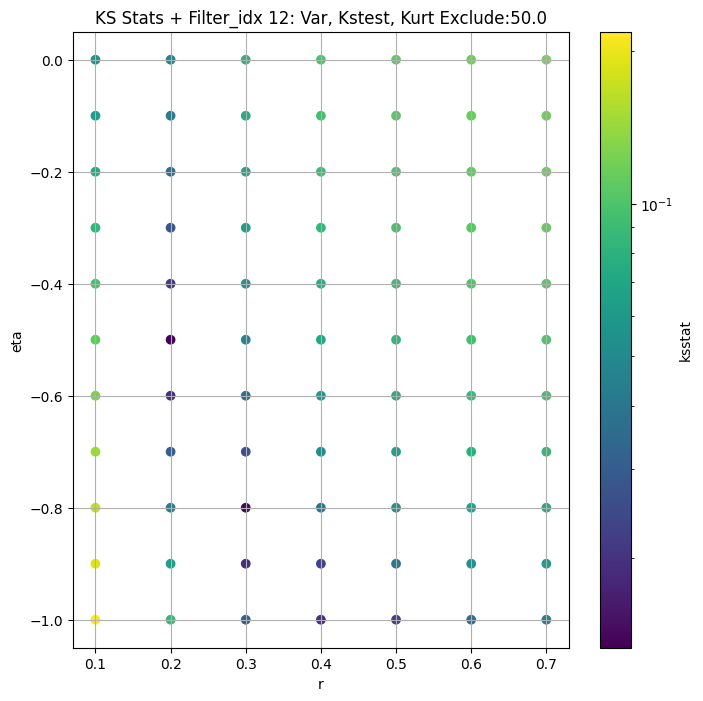

####
Filter_idx  13


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.011509556252332631 3.838628539685919


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.011959216758128832 3.4293016558394


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.012816453494973457 3.2569229287372927


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.012274185055306752 3.010504159298106
Number of samples: 100000, Without approximation : 196608000.0


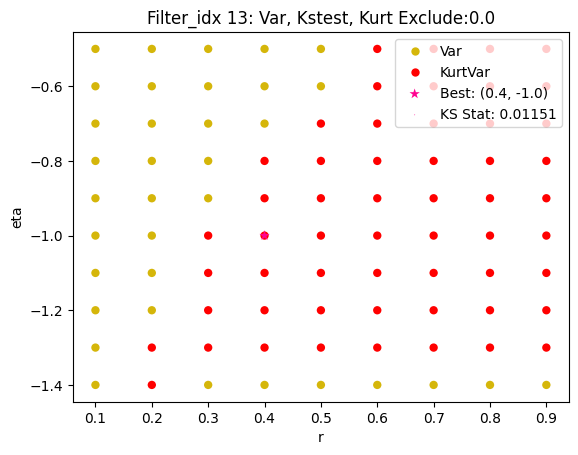

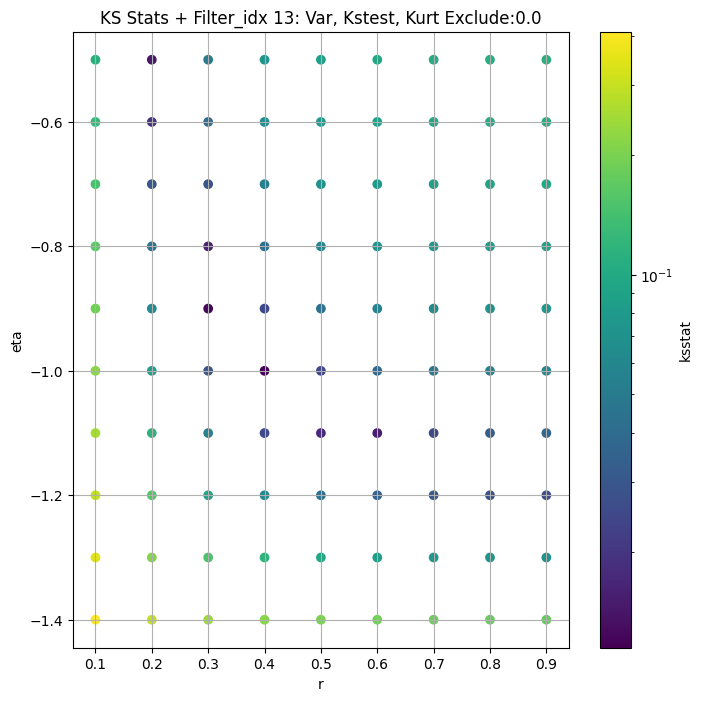

####
Filter_idx  14


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.00796683035967194 4.181247032003472


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.007561053842026322 3.7665758382955703


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.007798969593592164 3.57979082980569


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.011216257969120402 3.308739004580426
Number of samples: 100000, Without approximation : 196608000.0


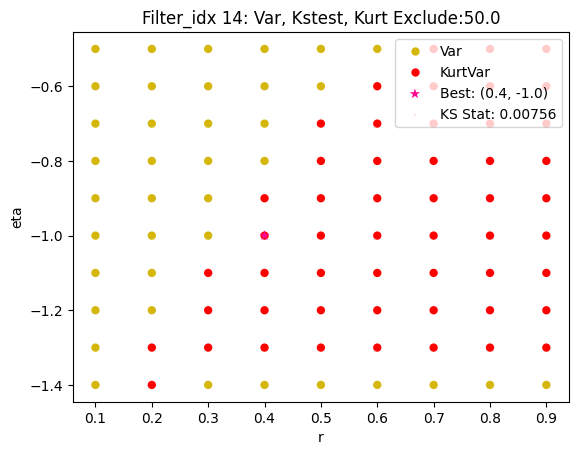

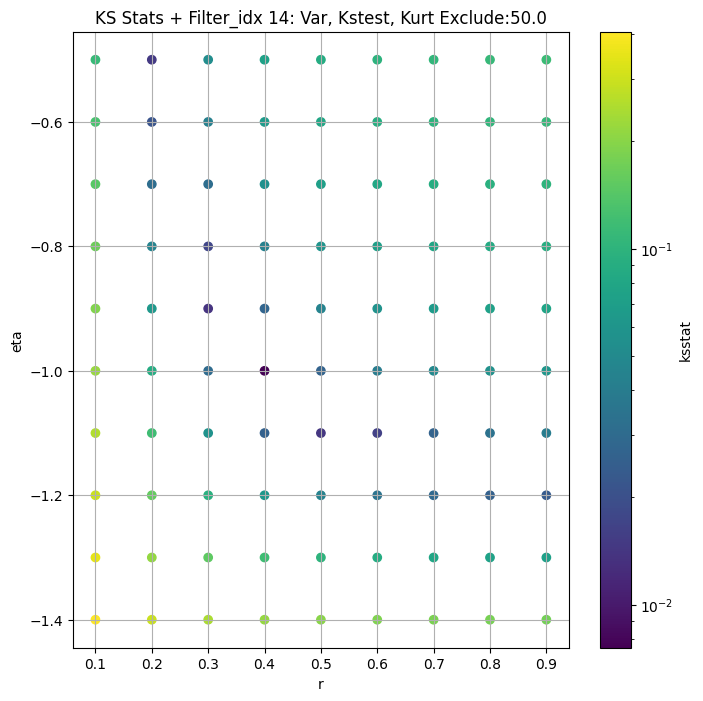

####
Filter_idx  15


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.023237809932341535 5.5225500059617545


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.023237763961530045 5.352010100759441


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.023237756175478796 5.266057426154343


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.02323742259726086 5.132016497091577
Number of samples: 100000, Without approximation : 196608000.0


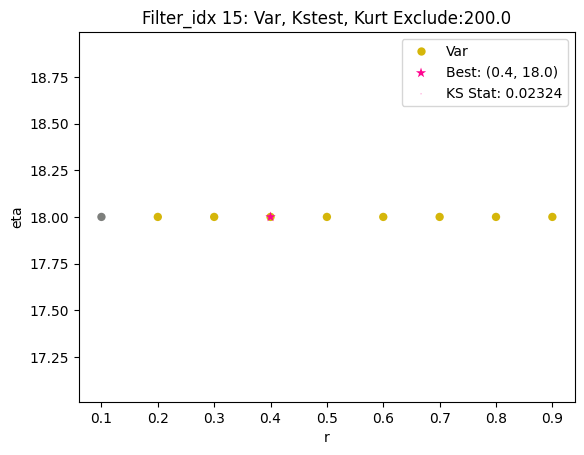

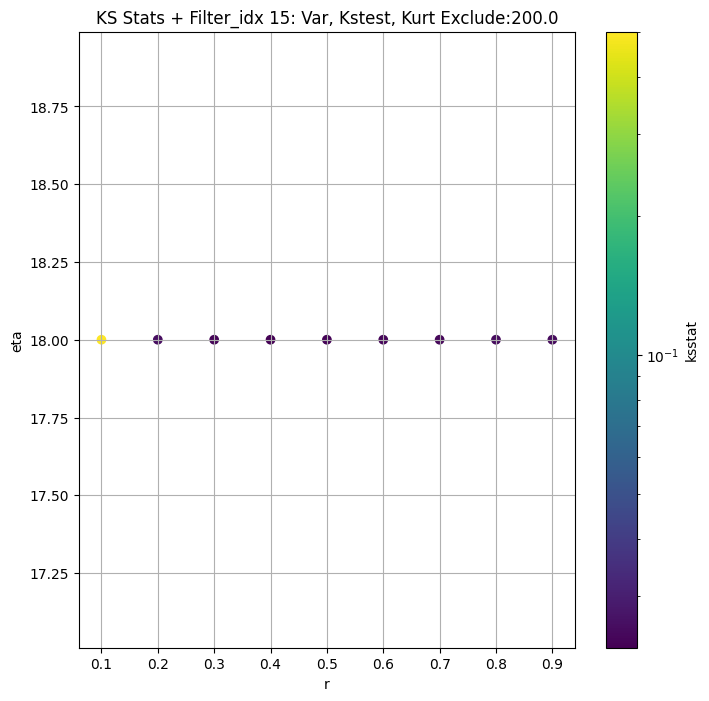

####
Filter_idx  16


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.013000334770096655 3.5985721945619096


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.014490909404995422 3.1648502881488136


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.014954799019559206 2.9954752459244163


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.015356035357011272 2.759375082712511
Number of samples: 100000, Without approximation : 196608000.0


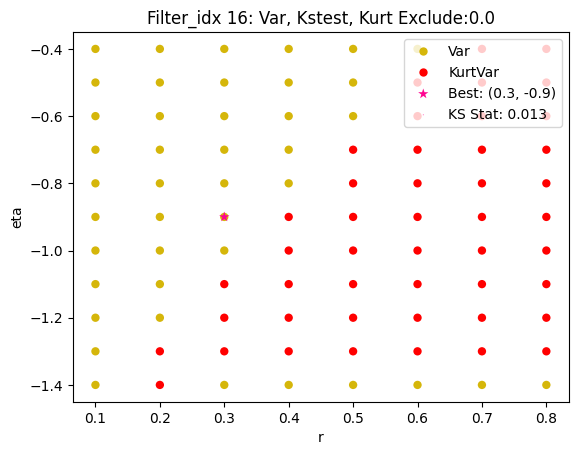

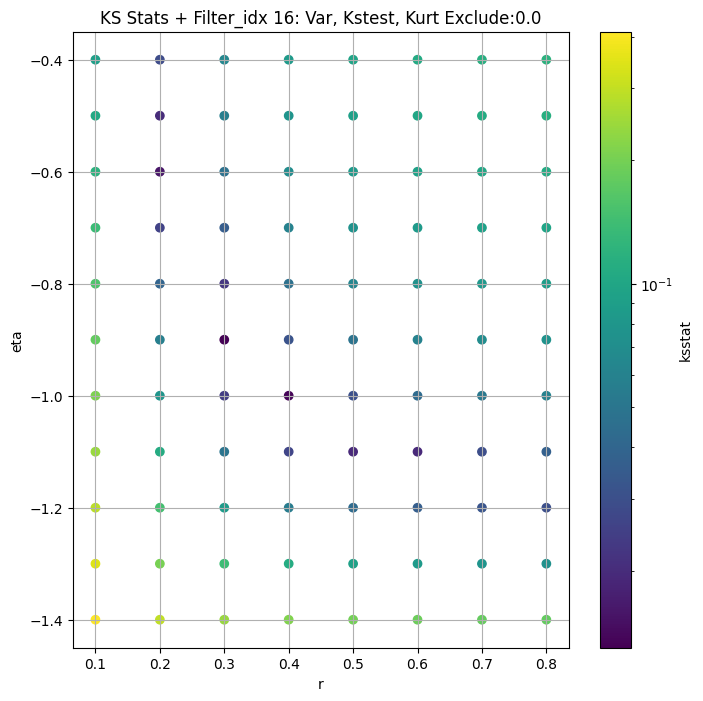

####
Filter_idx  17


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.01872064078355734 5.323275559639544


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.02066548337153111 4.95709786412702


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.02168643958247407 4.749873242732722


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.0193547581670217 4.428775328241799
Number of samples: 100000, Without approximation : 196608000.0


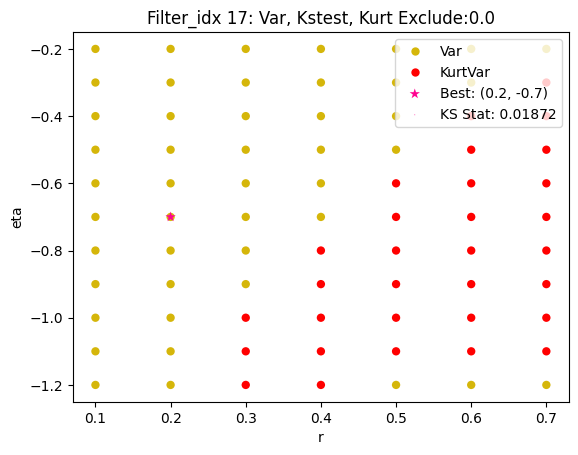

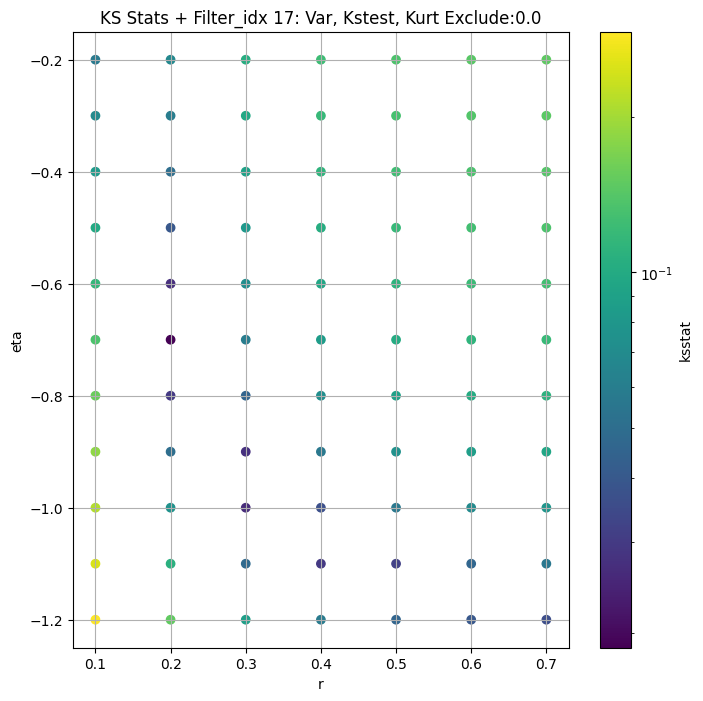

####
Filter_idx  18


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.0130395570231146 2.7741612915174576


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.008074396094613842 2.3604795235307856


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.010105285085527549 2.21392178636609


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.00859135418594452 2.0154109901265747
Number of samples: 100000, Without approximation : 196608000.0


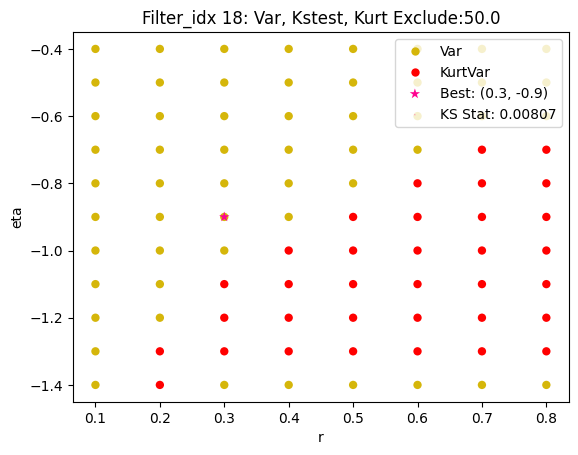

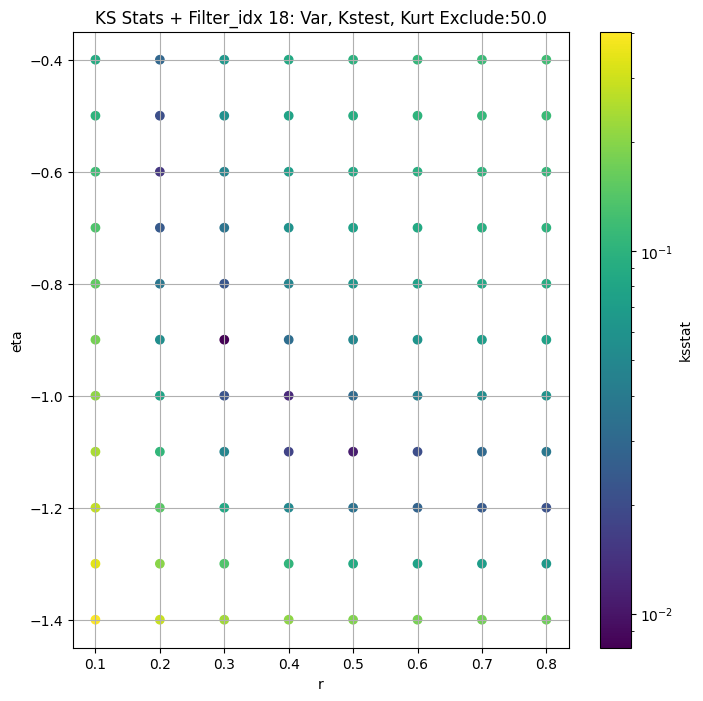

####
Filter_idx  19


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 0 0.009119550713769353 8.659423679035976


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 50 0.010875842890773257 8.425055709559455


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 100 0.011599993076526038 8.295157986654898


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 200 0.0129205631189937 8.089120795218513
Number of samples: 100000, Without approximation : 196608000.0


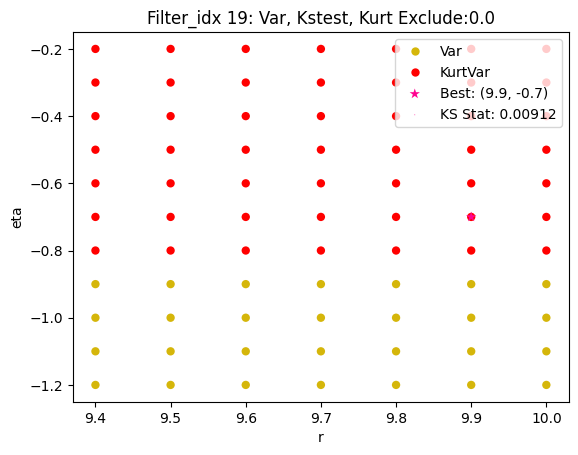

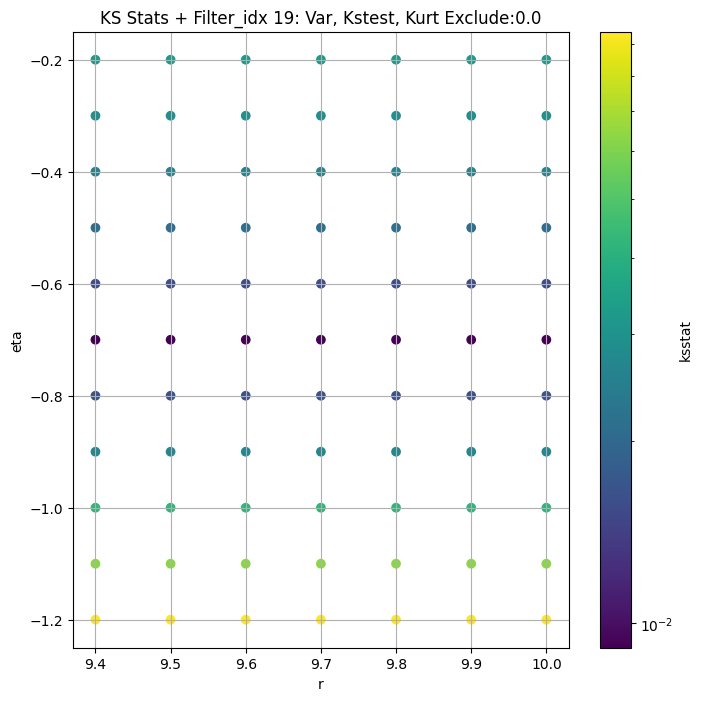

####
Filter_idx  20


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.007096698386724276 6.255223206781173


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.008467658266484934 5.686483624701109


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.007591802295745187 5.408907342083898


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.008078737399375147 4.9980384297243425
Number of samples: 100000, Without approximation : 196608000.0


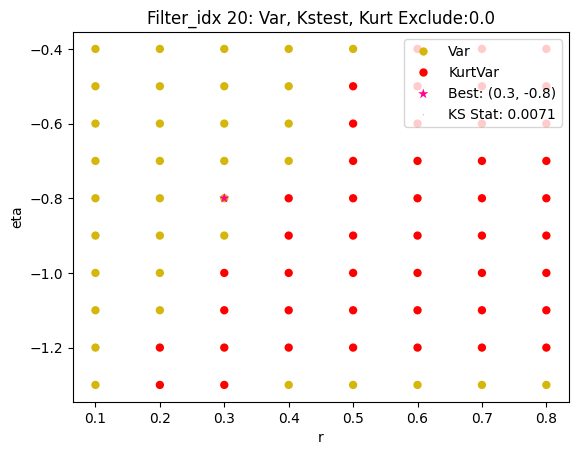

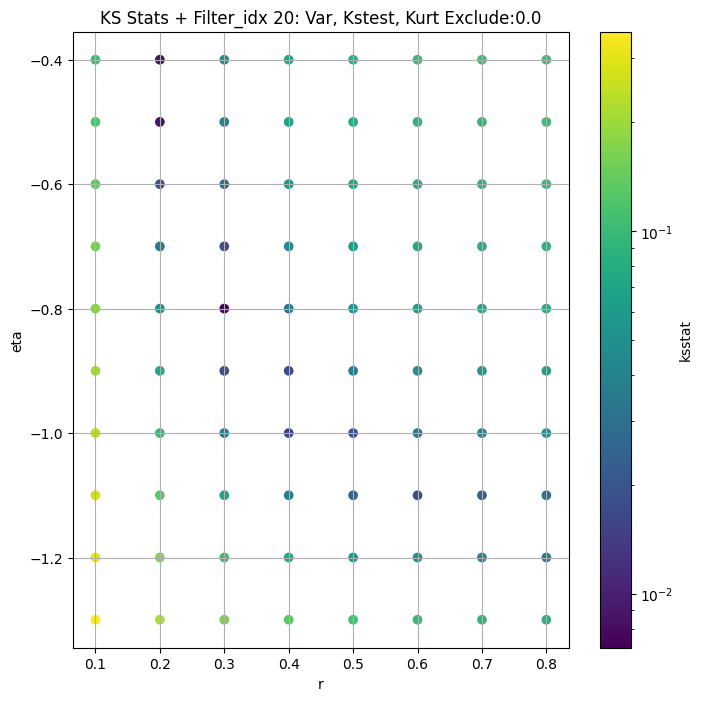

####
Filter_idx  21


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 0 0.02344375520863423 16.531827341102726


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 50 0.023701587261804824 16.010718766270852


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 100 0.024003886842756006 15.737610274559708


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 200 0.026494982619147844 15.31400206335446
Number of samples: 100000, Without approximation : 196608000.0


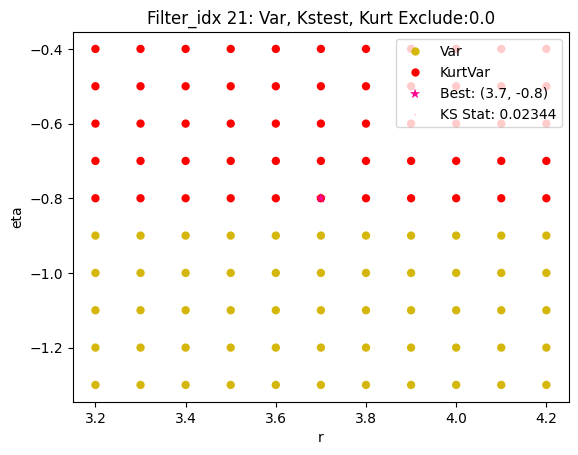

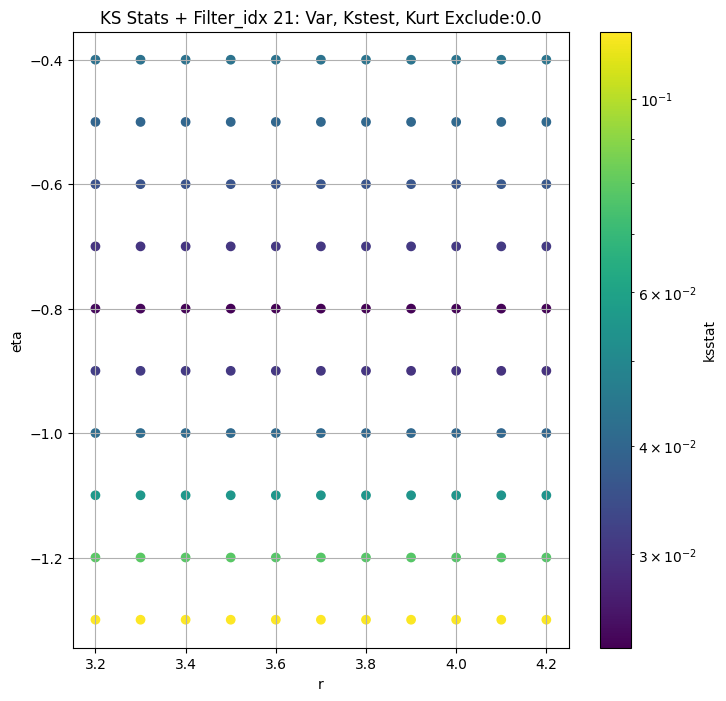

####
Filter_idx  22


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.009219649160002868 3.9729341732160117


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.0068599602031992335 3.563897373494704


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.009330868798774053 3.380650767686097


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.010264046079803024 3.1200747741238053
Number of samples: 100000, Without approximation : 196608000.0


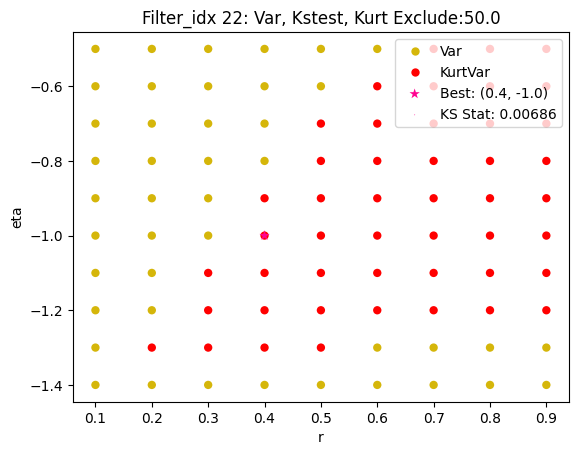

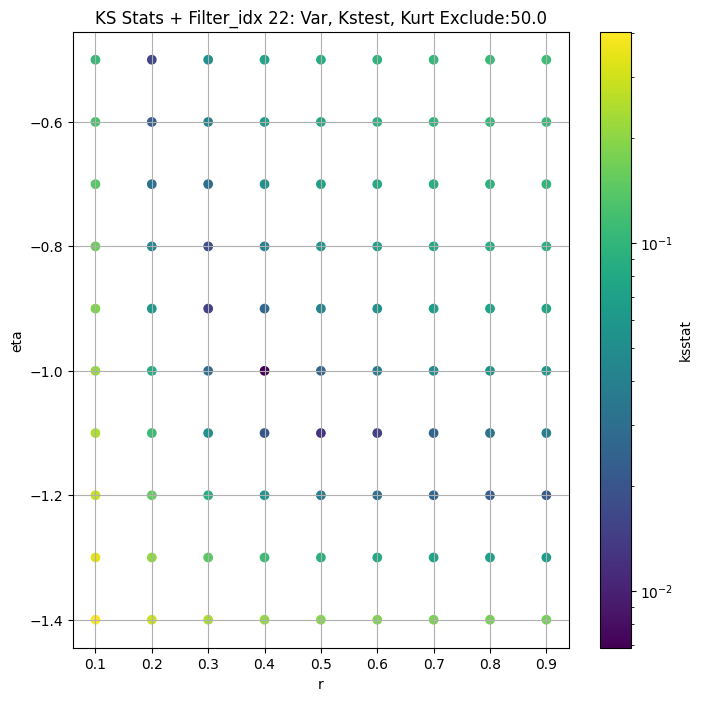

####
Filter_idx  23


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.009584895937902349 3.1141481428458326


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.010487627337768285 2.8211467018748957


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.010257170425646334 2.681832006695198


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.010207691136761739 2.4799148789015844
Number of samples: 100000, Without approximation : 196608000.0


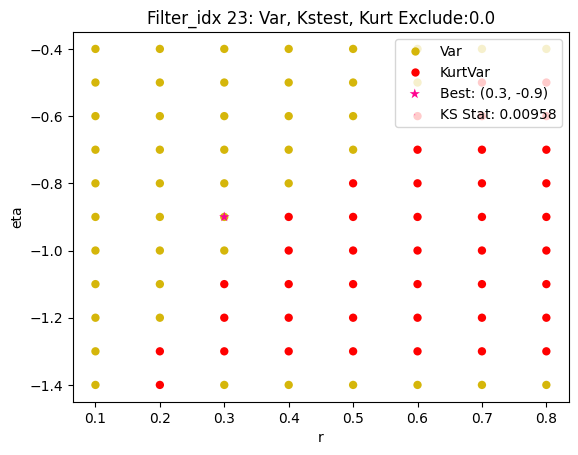

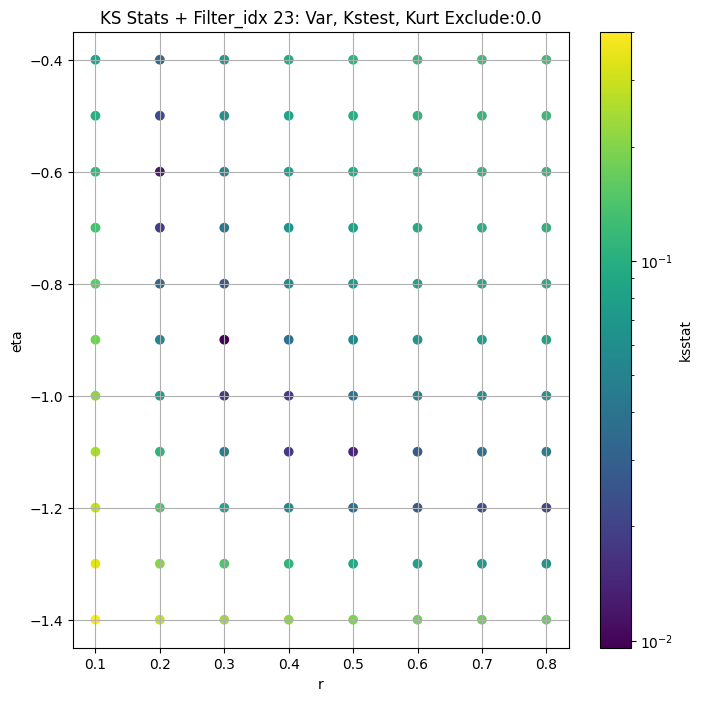

####
Filter_idx  24


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.014238484161417708 3.6855011889900675


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.015161225111261278 3.208991300137925


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.015021765528771991 3.0073951373751906


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.01495771453893413 2.725678217830552
Number of samples: 100000, Without approximation : 196608000.0


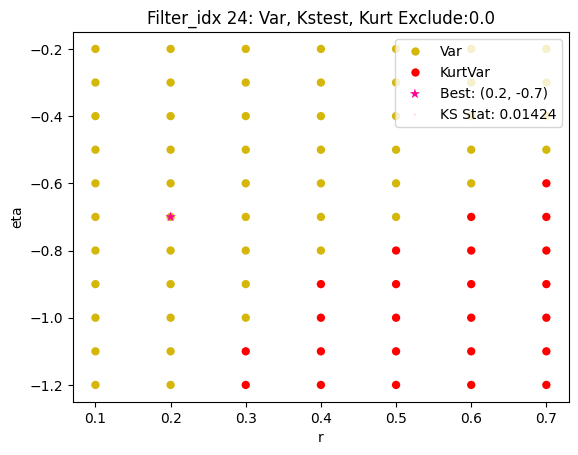

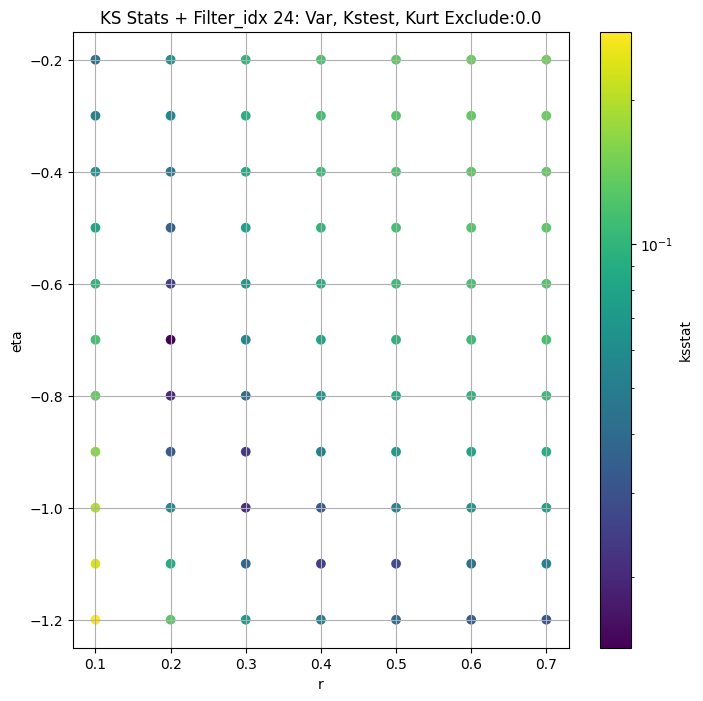

####
Filter_idx  25


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.010101739814752264 4.6263123091597125


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.011307745140502035 4.105748624815793


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.012971382807302811 3.8768522439391457


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.015899158568157712 3.556119345707942
Number of samples: 100000, Without approximation : 196608000.0


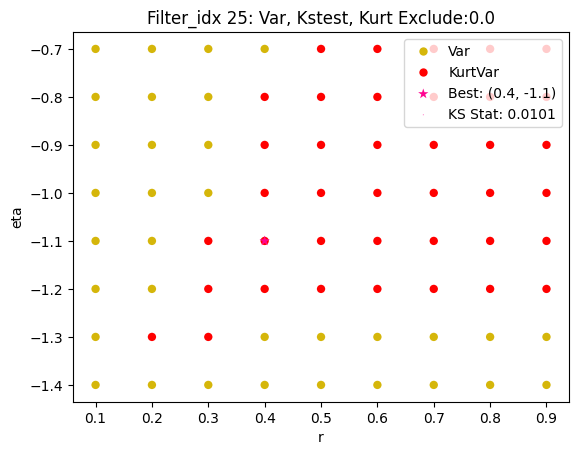

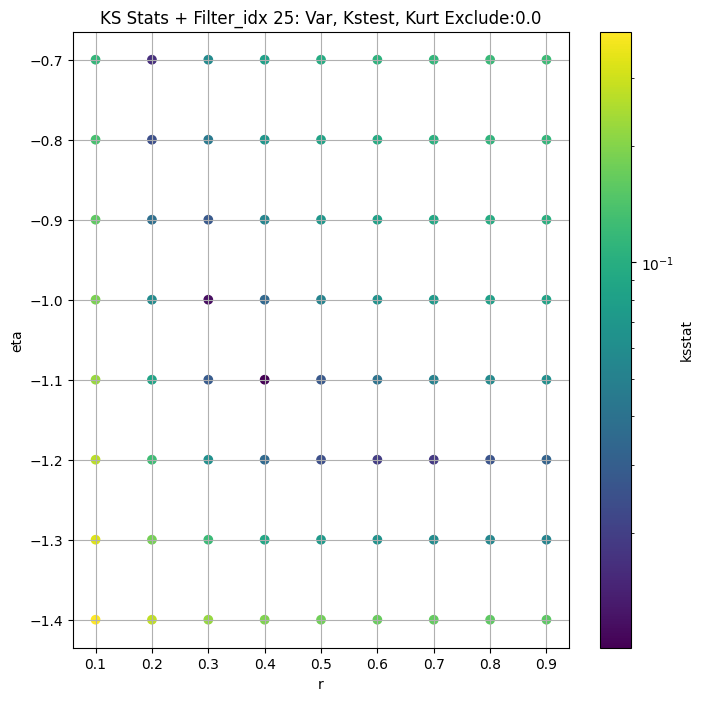

####
Filter_idx  26


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.010816540729375657 3.5725534075762995


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.013153351919204359 3.2954477799671995


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.014044107002968986 3.1649936247486585


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.014460493480581982 2.9730214485088635
Number of samples: 100000, Without approximation : 196608000.0


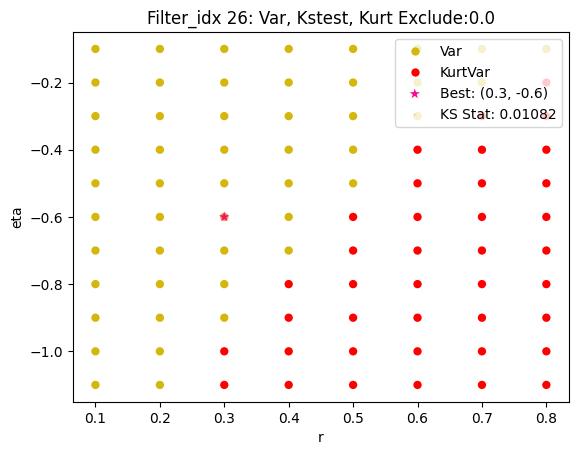

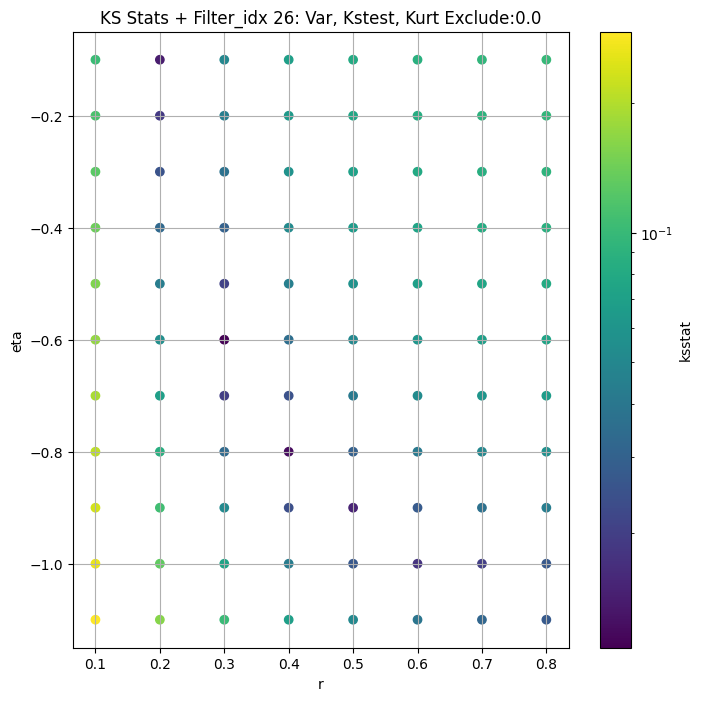

####
Filter_idx  27


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.017016992664925804 3.248680336930291


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.013245718546152419 2.7950127260965356


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.013085207997507786 2.6197247038357725


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.01331890310049634 2.3807910188974897
Number of samples: 100000, Without approximation : 196608000.0


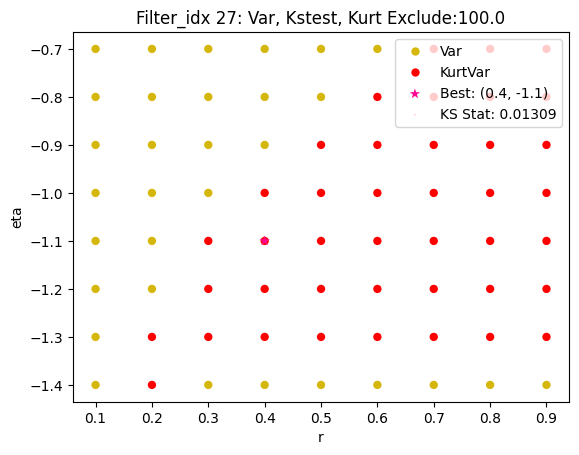

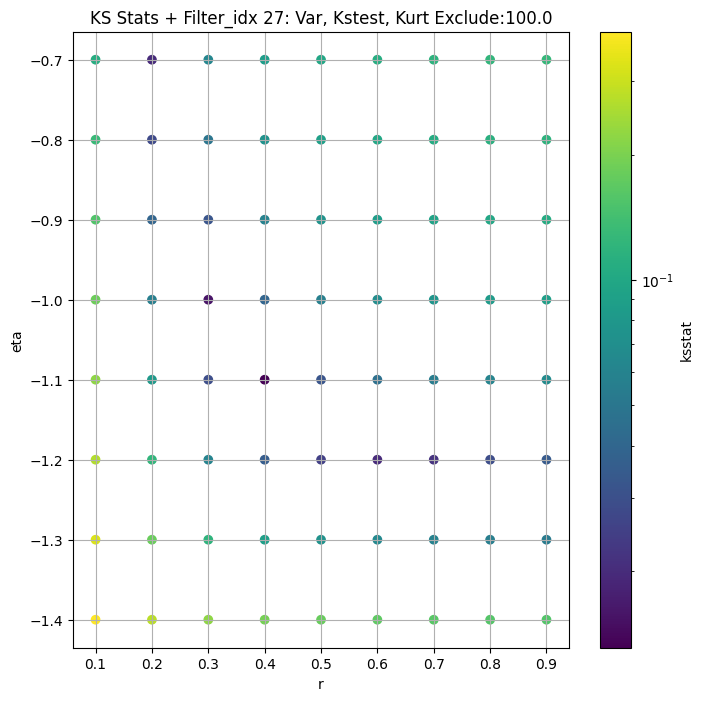

####
Filter_idx  28


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.01006100218211381 3.8401503764735256


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.01386383012676029 3.378691503039166


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.012375429287692197 3.169636823853883


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.01136794019274967 2.8771543210848938
Number of samples: 100000, Without approximation : 196608000.0


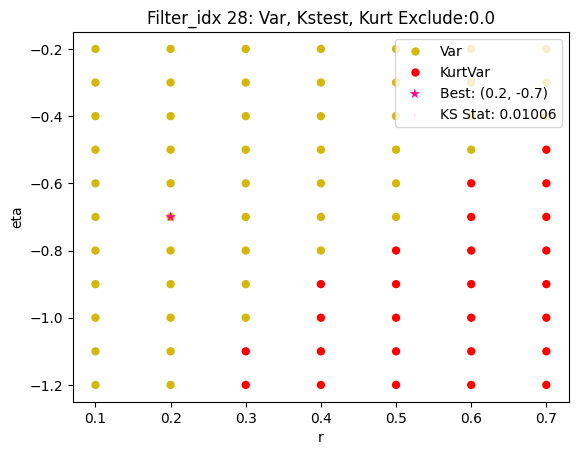

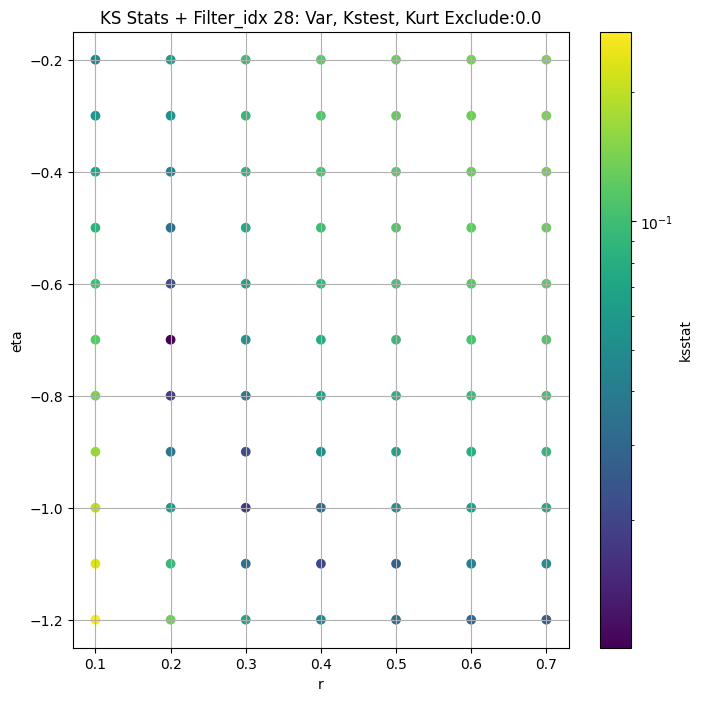

####
Filter_idx  29


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.01342055389458019 2.202851354356995


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.011004383428351333 1.9489666178719744


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.012124117786709354 1.8411454484439715


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.013298565523779594 1.6868442766446625
Number of samples: 100000, Without approximation : 196608000.0


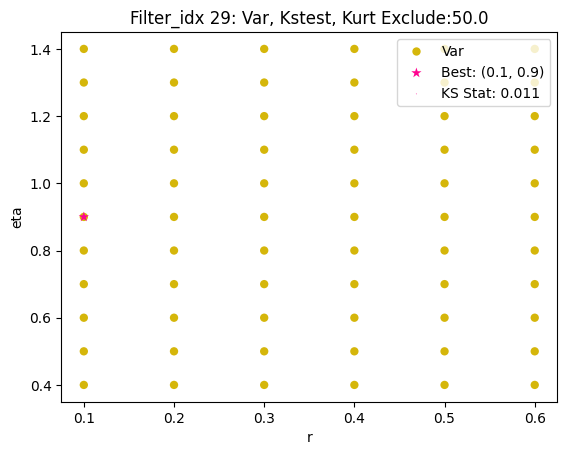

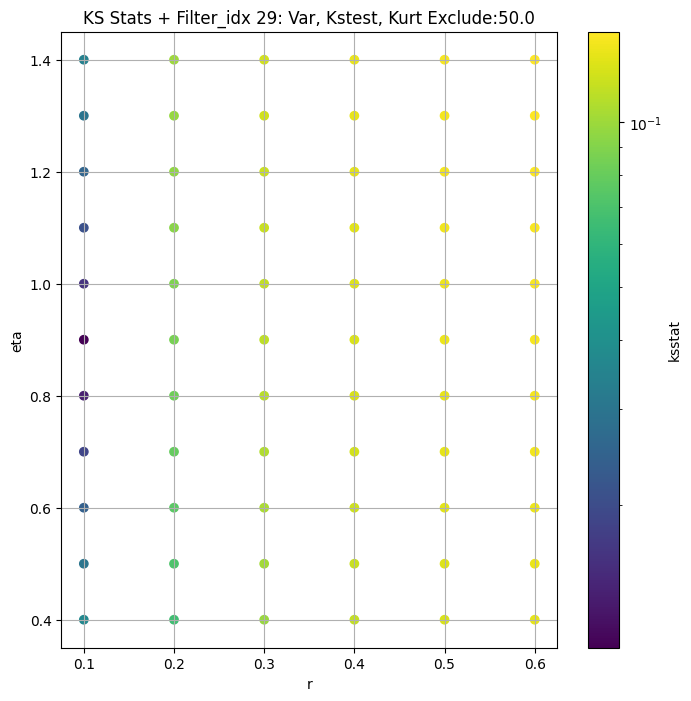

####
Filter_idx  30


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.011966327291643264 2.9488841180113803


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.013712571082768799 2.5629712438928087


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.01278057908160457 2.3975568423547786


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.013382482848138588 2.1679361469516523
Number of samples: 100000, Without approximation : 196608000.0


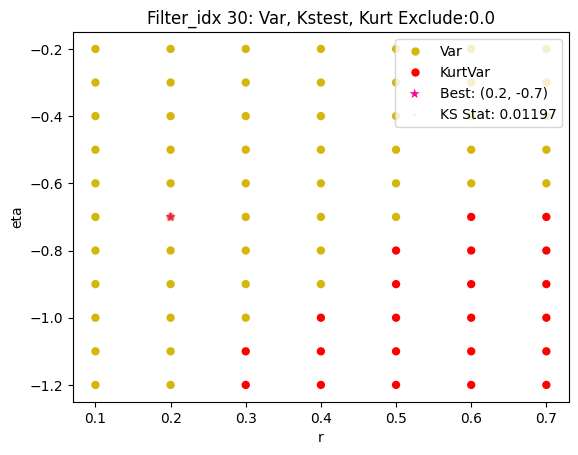

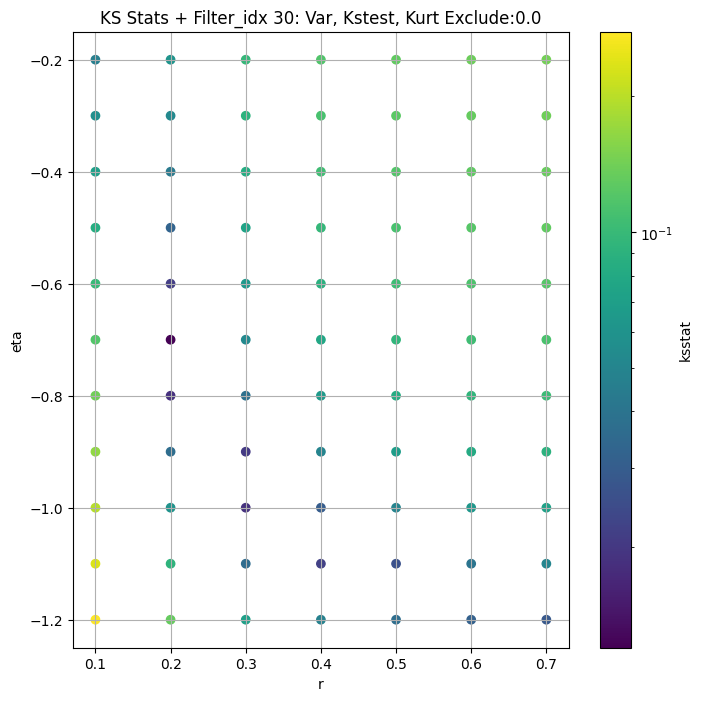

####
Filter_idx  31


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.016128906034460377 4.099056218699054


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.016005254073393316 3.850241133545314


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.015956348502428608 3.737013929801641


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.01616149272897771 3.5607688315927075
Number of samples: 100000, Without approximation : 196608000.0


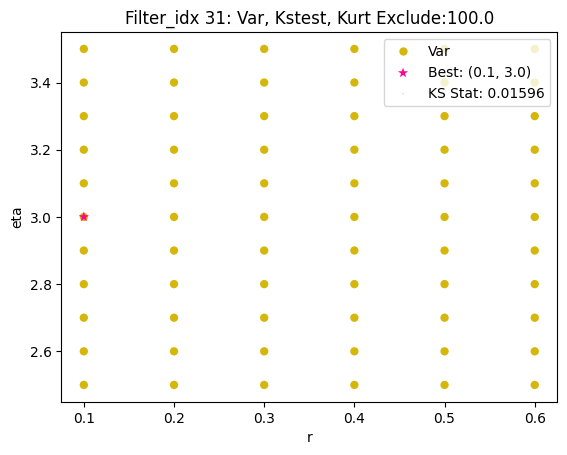

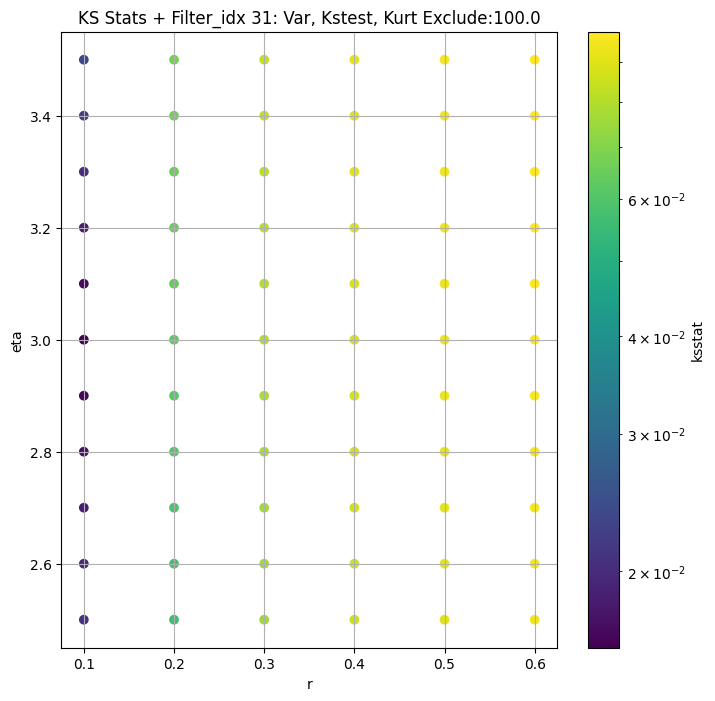

####
Filter_idx  32


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.008758169852438491 3.0903117888517677


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.007424997892699958 2.7587746456035345


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.009229015601894264 2.6251271036379906


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.009255010887999848 2.4315768741389743
Number of samples: 100000, Without approximation : 196608000.0


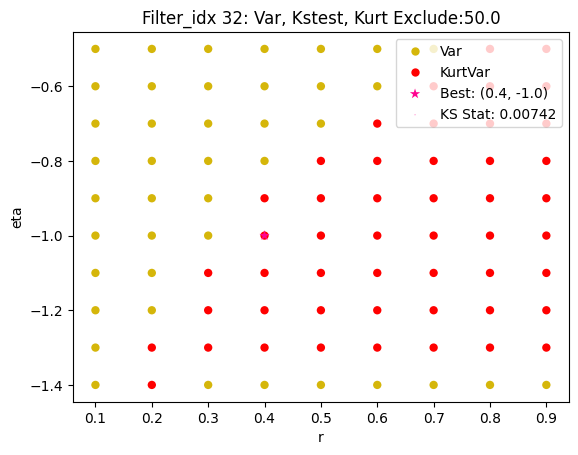

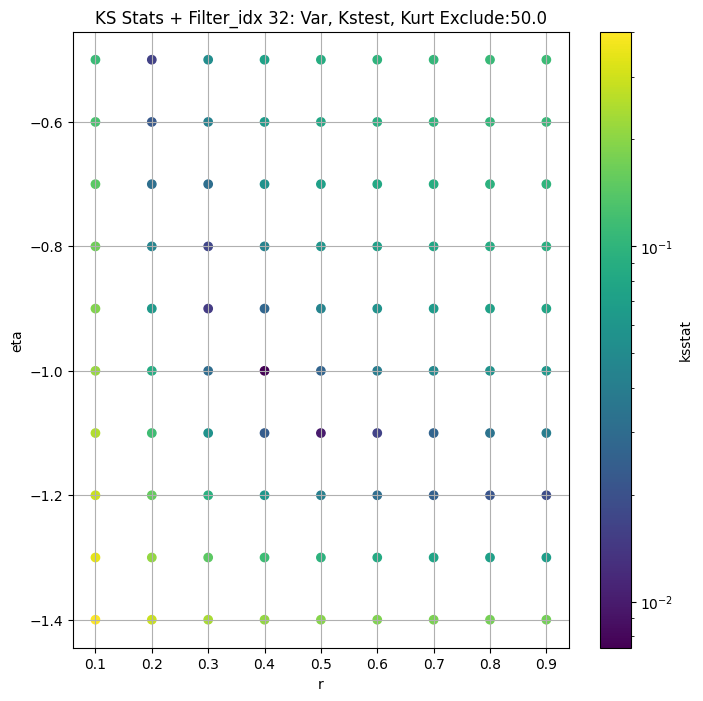

####
Filter_idx  33


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.009616513427693624 2.6272934065461526


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.012163315925231344 2.2475751097106413


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.00959078672953212 2.1109206816209234


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.010353391853412386 1.9245957687166455
Number of samples: 100000, Without approximation : 196608000.0


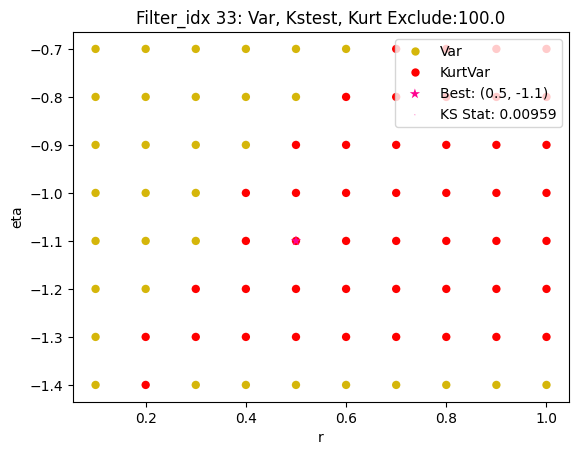

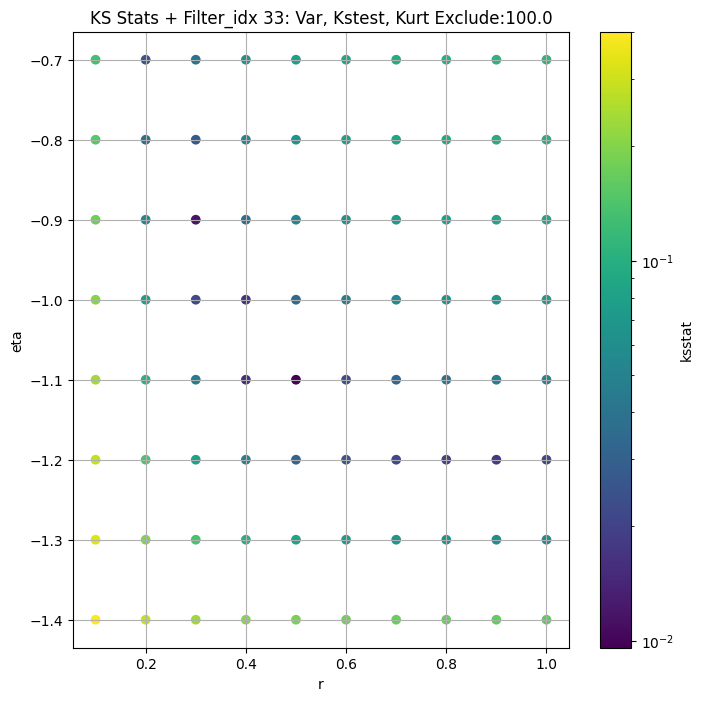

####
Filter_idx  34


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.011364449462226256 3.0948968326877977


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.013278096830027009 2.709838344845584


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.013431349801655945 2.5413172523653977


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.010138871789183046 2.304455125758043
Number of samples: 100000, Without approximation : 196608000.0


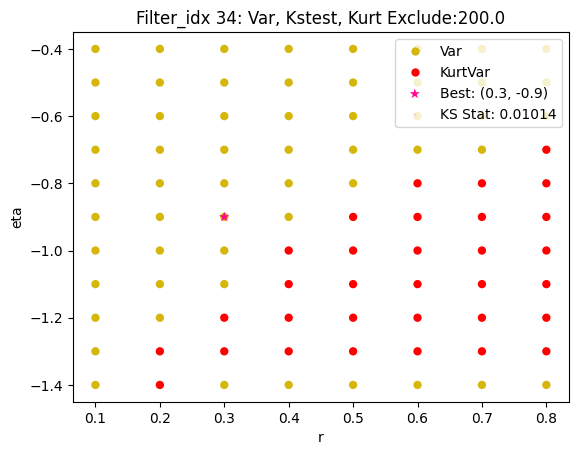

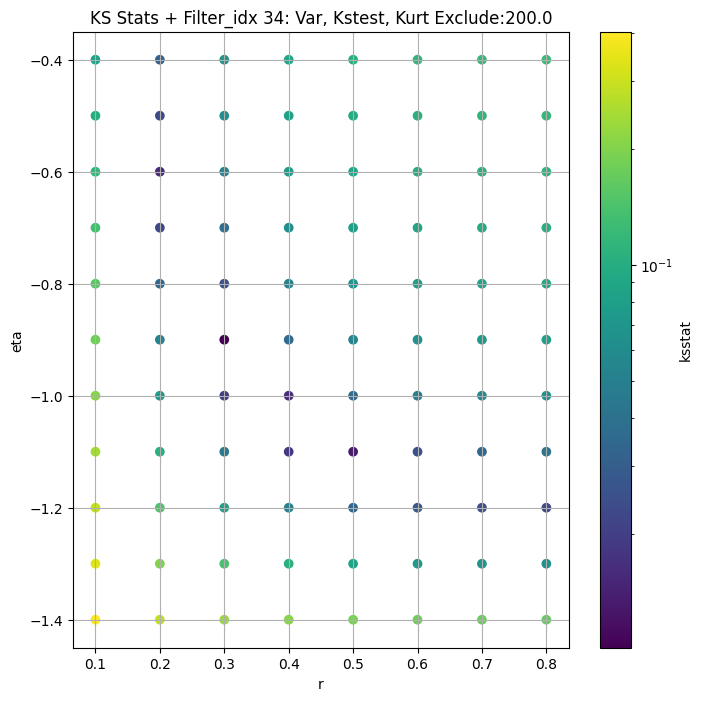

####
Filter_idx  35


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 0 0.018114021955529358 13.555761693055832


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 50 0.01812245124664813 13.15835036533223


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 100 0.018169831698364114 12.93278344201746


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 200 0.018161930018513628 12.568294994150653
Number of samples: 100000, Without approximation : 196608000.0


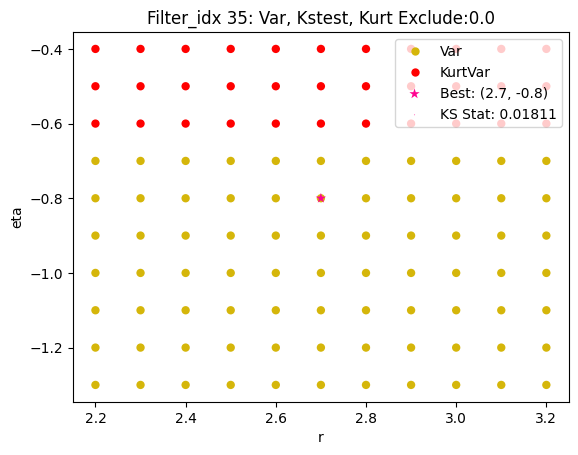

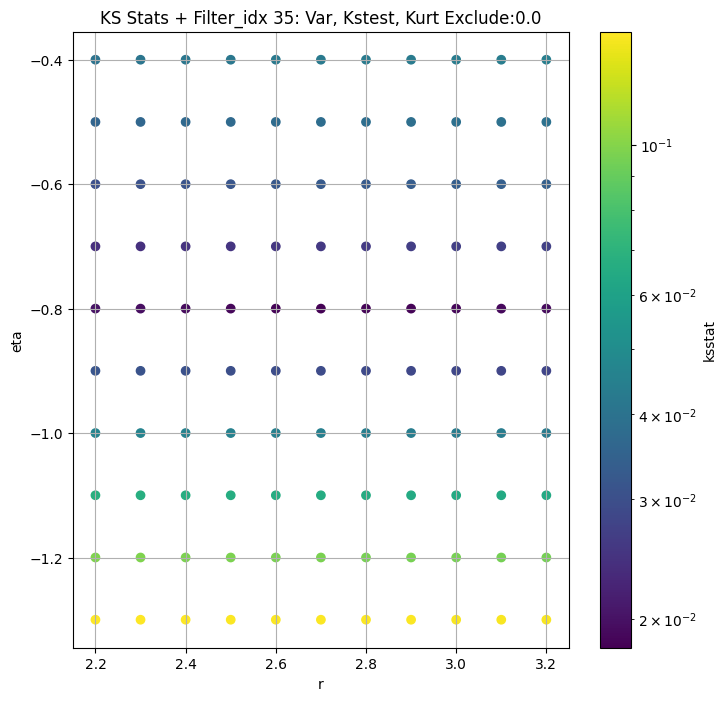

####
Filter_idx  36


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 0 0.022784423713382795 7.045793526304776


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 50 0.022777178054701086 6.842308551543519


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 100 0.022768005793349866 6.736651758274691


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 200 0.02287415051223246 6.571259135600178
Number of samples: 100000, Without approximation : 196608000.0


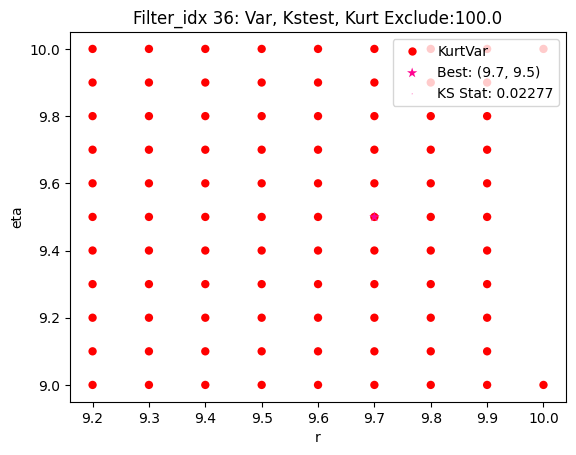

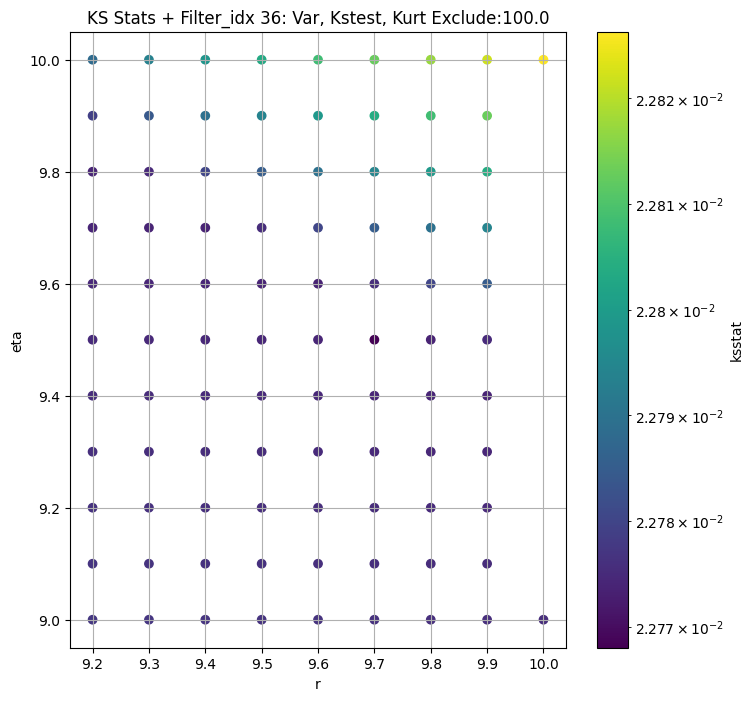

####
Filter_idx  37


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 0 0.02073474165164202 15.03236829916976


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 50 0.022322070884579853 14.519133372110339


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 100 0.023860421534506515 14.253317597731234


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 200 0.024138822419200512 13.844049256247908
Number of samples: 100000, Without approximation : 196608000.0


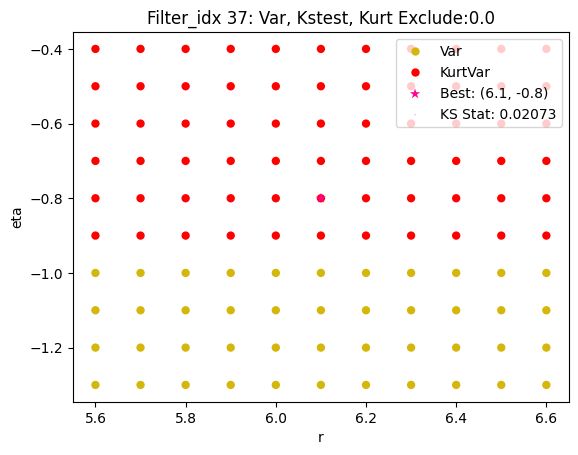

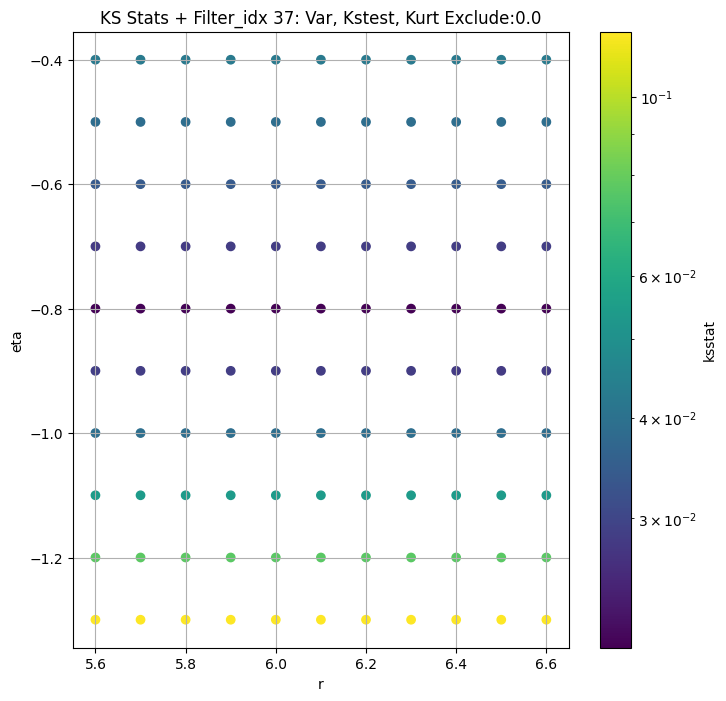

####
Filter_idx  38


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.008275770503360258 6.45363780868692


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.011699683821981666 5.93380801008433


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.01172725322993795 5.685442348910336


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.010702392844911701 5.315592814926782
Number of samples: 100000, Without approximation : 196608000.0


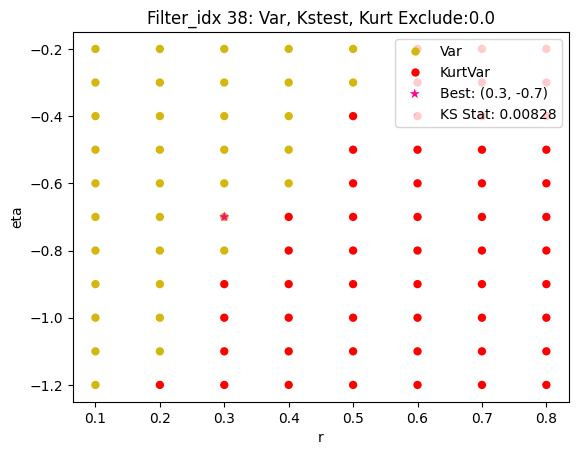

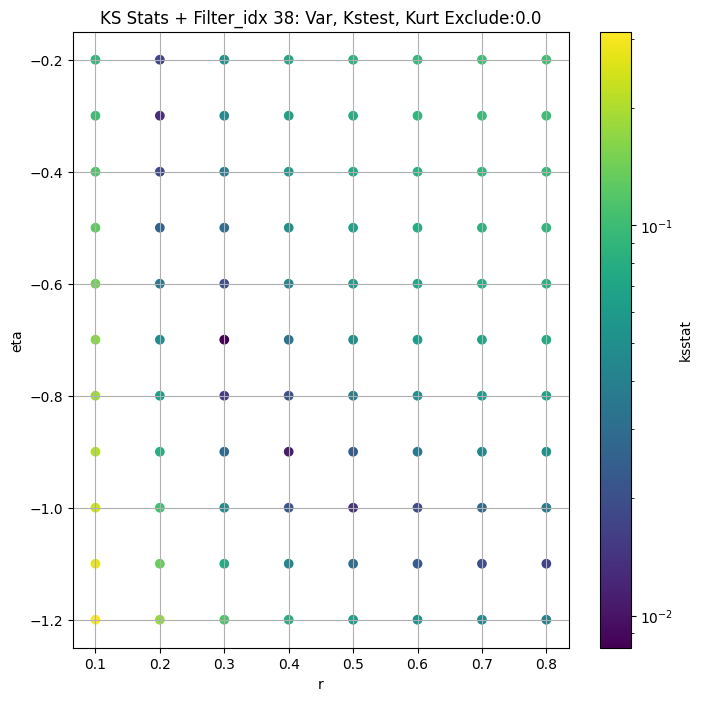

####
Filter_idx  39


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.012975958137895371 4.701398204281019


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.012298324952409456 4.37832163509568


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.012620041882435706 4.240931794713135


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.012676251389912463 4.031698514955163
Number of samples: 100000, Without approximation : 196608000.0


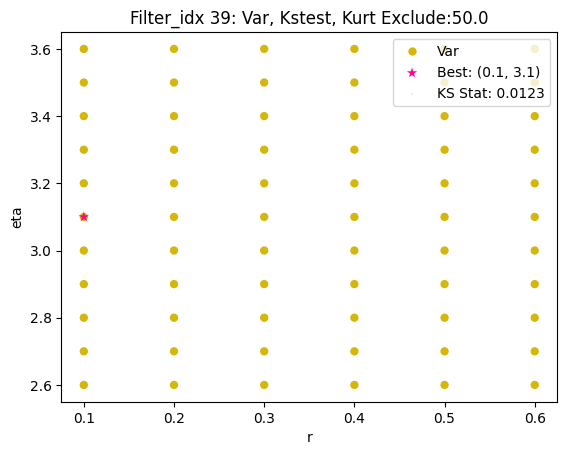

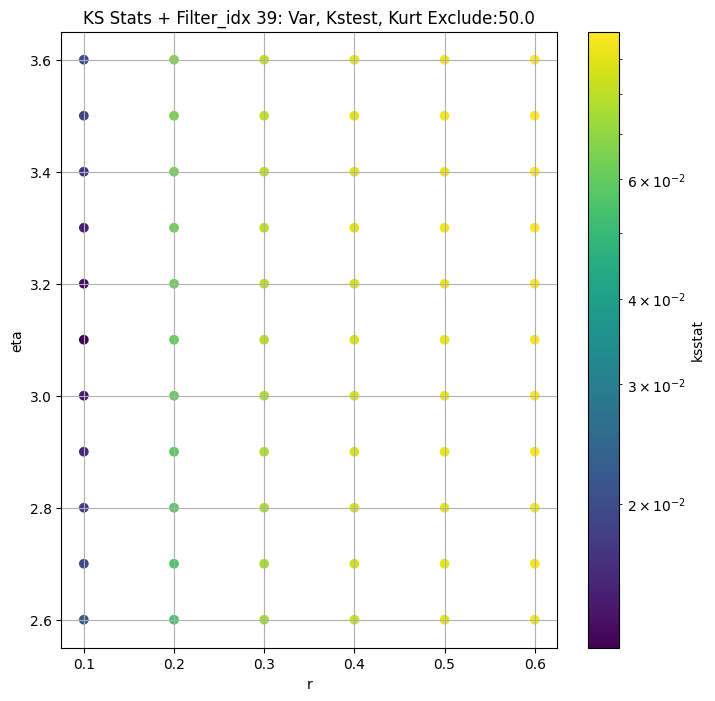

####
Filter_idx  40


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.02248229513942862 5.587258246788043


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.02290835490340648 5.436887778194431


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.02325403109138069 5.357303086103164


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.023626338231857447 5.232213097589389
Number of samples: 100000, Without approximation : 196608000.0


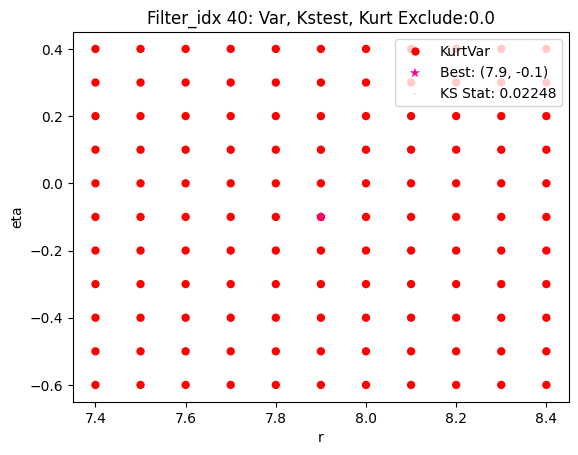

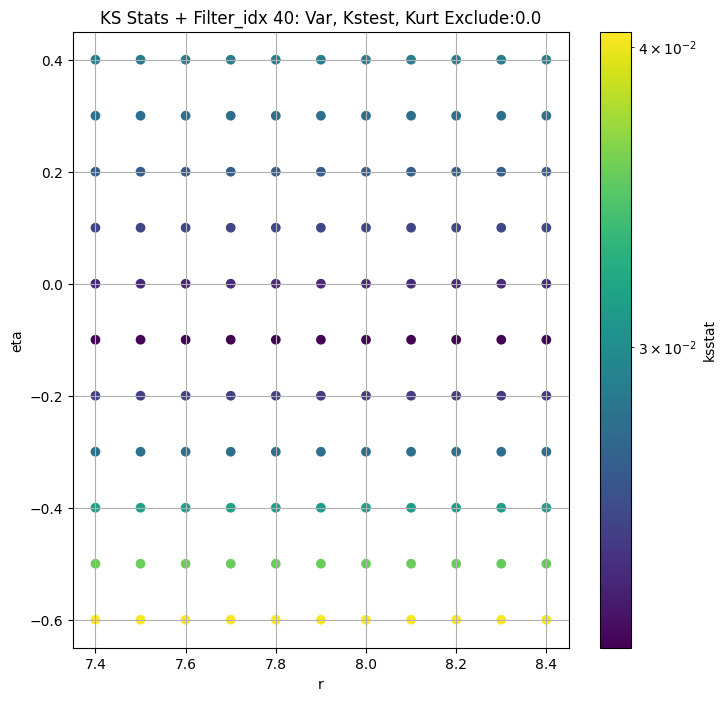

####
Filter_idx  41


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.01150210741288371 3.029949420860551


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.009733017617251594 2.6120334351527568


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.010679468903567635 2.453094214253551


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.011215039185264841 2.235644262735695
Number of samples: 100000, Without approximation : 196608000.0


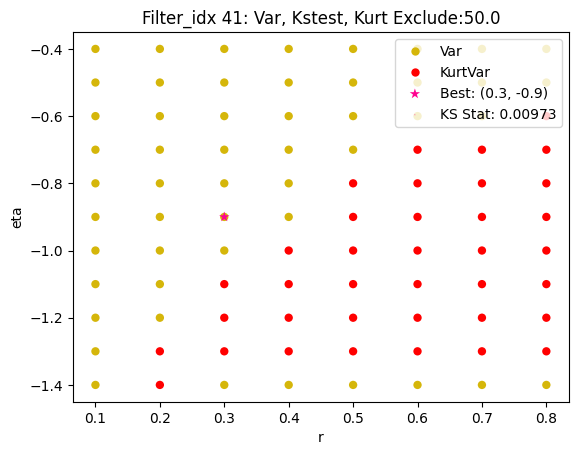

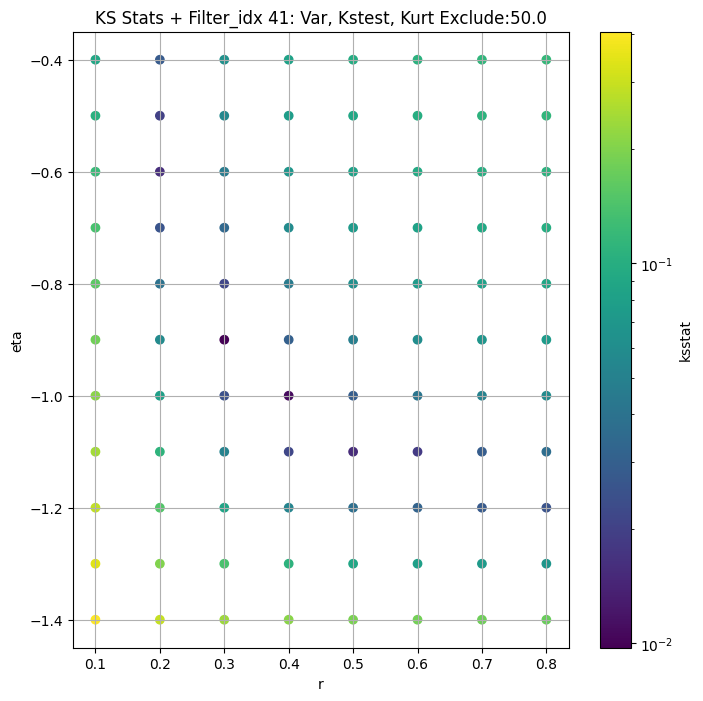

####
Filter_idx  42


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 0 0.007710104809604157 7.436512547613707


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 50 0.008939584317929516 6.6823788534048445


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 100 0.00714889614480696 6.307477724690682


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 200 0.009574996624067134 5.751719744493269
Number of samples: 100000, Without approximation : 196608000.0


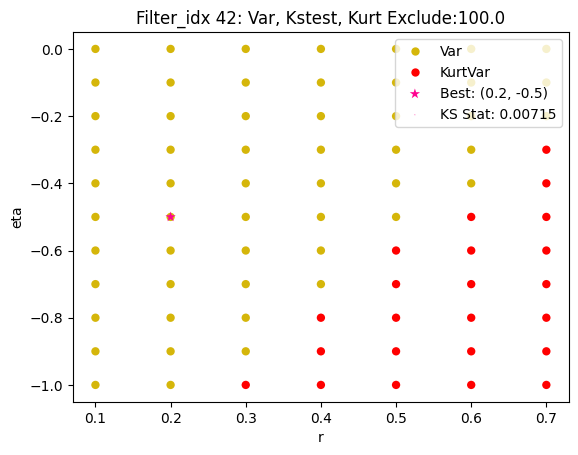

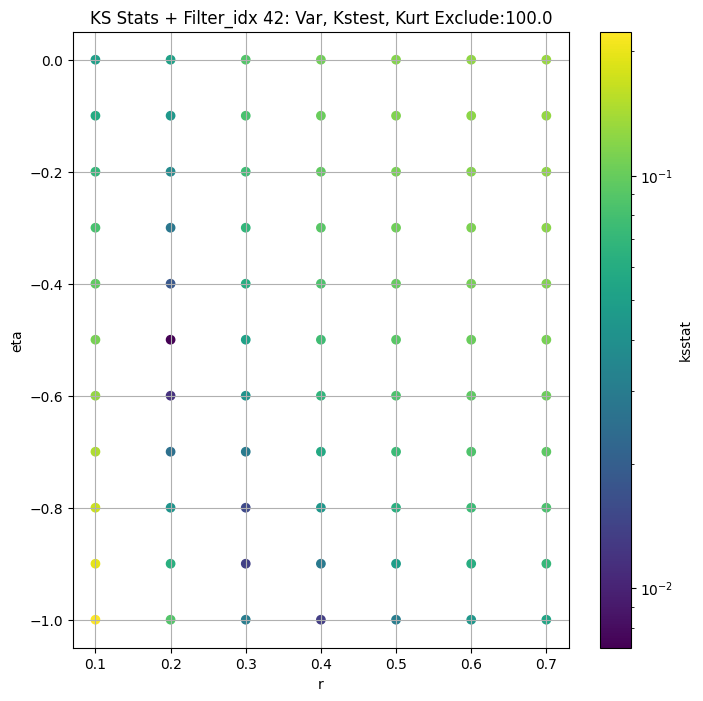

####
Filter_idx  43


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 0 0.007755835492616159 2.737895469808474


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 50 0.01126184143563791 2.4918488085788786


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 100 0.009978813831789779 2.3783906580062486


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 200 0.00940103680157428 2.2123014065243933
Number of samples: 100000, Without approximation : 196608000.0


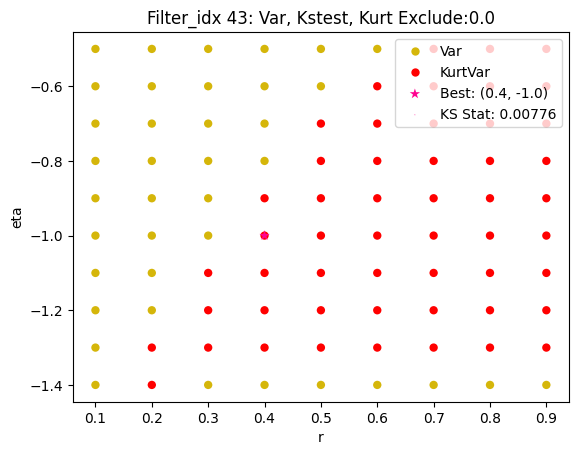

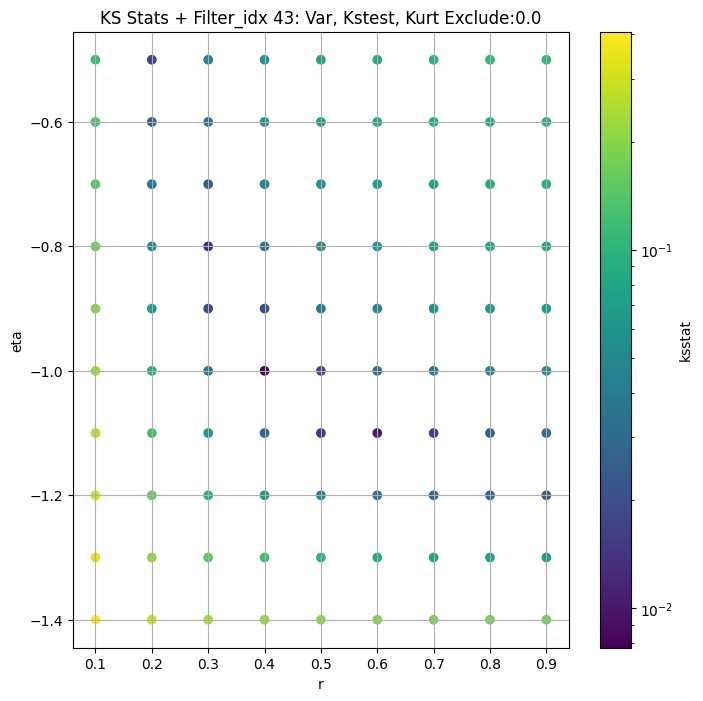

####
Filter_idx  44


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 0 0.01534500483898038 6.503209747236171


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 50 0.014958313060159434 5.84370055581932


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 100 0.014865709592346787 5.538631258150869


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 200 0.015257252553717016 5.088684930072415
Number of samples: 100000, Without approximation : 196608000.0


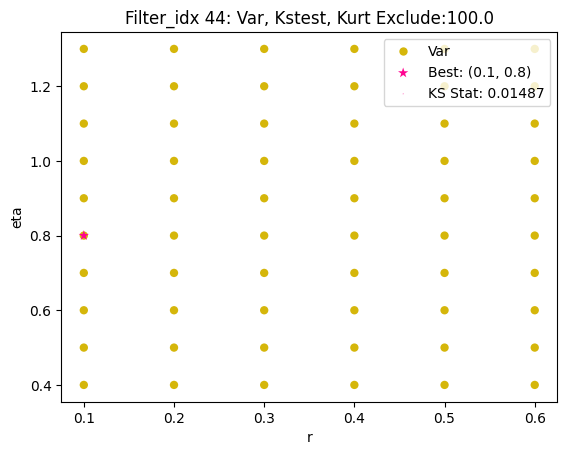

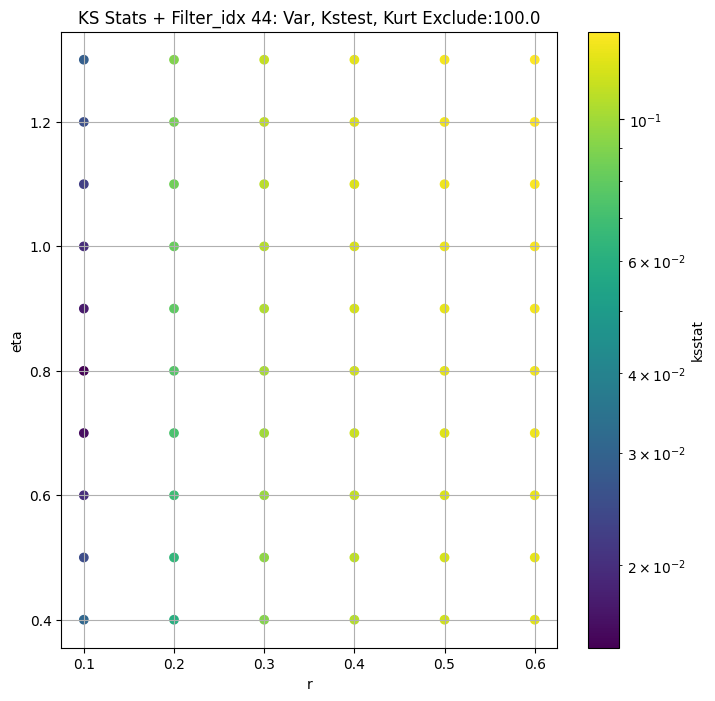

####
Filter_idx  45


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 0 0.02345360786141243 3.317265195111866


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 50 0.02345193886689323 3.0406931003539057


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 100 0.023429766494061144 2.925836981117427


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 200 0.02347349160450196 2.750679435751055
Number of samples: 100000, Without approximation : 196608000.0


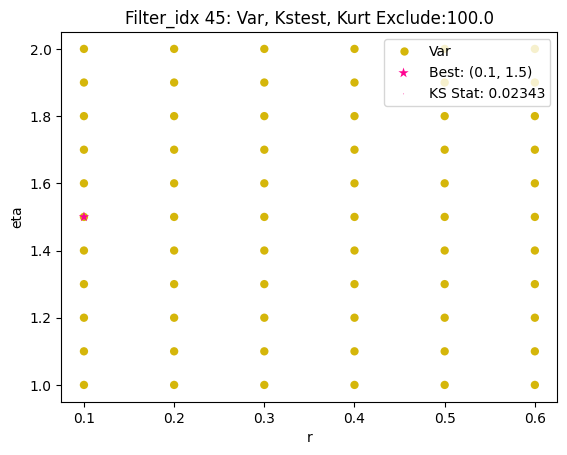

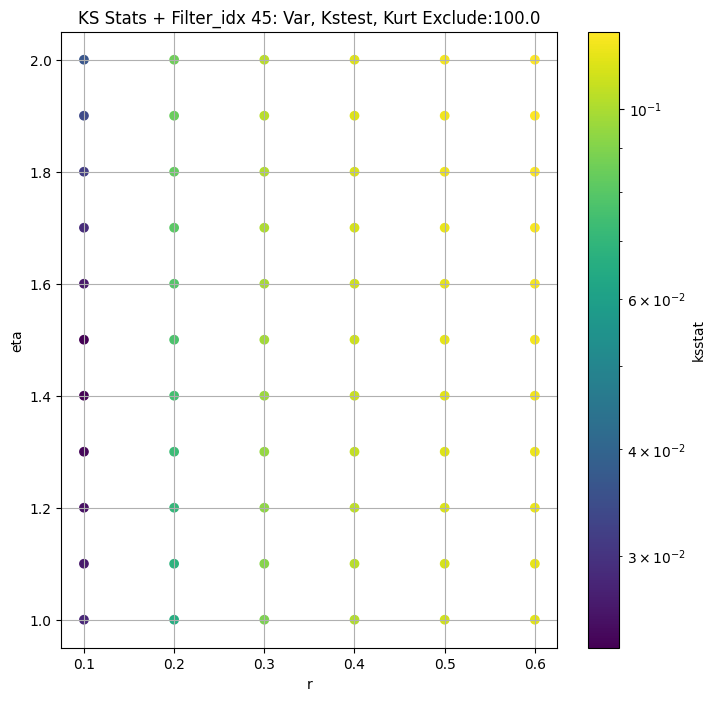

####
Filter_idx  46


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 0 0.009951233029097728 2.4646639528284564


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 50 0.008401793051589501 2.319766732370928


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 100 0.007492265784870722 2.2520857787326394


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 200 0.0064036670278831975 2.1473727744592637
Number of samples: 100000, Without approximation : 196608000.0


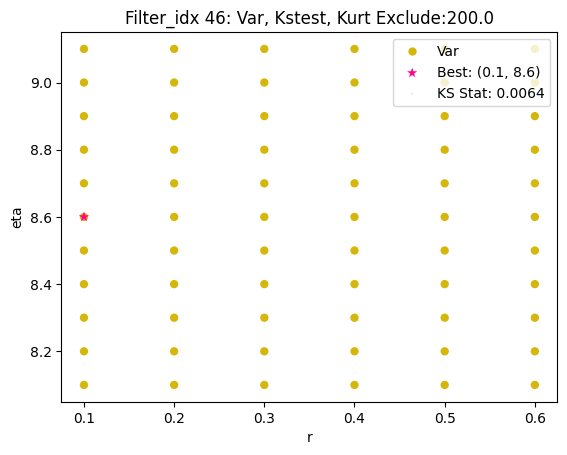

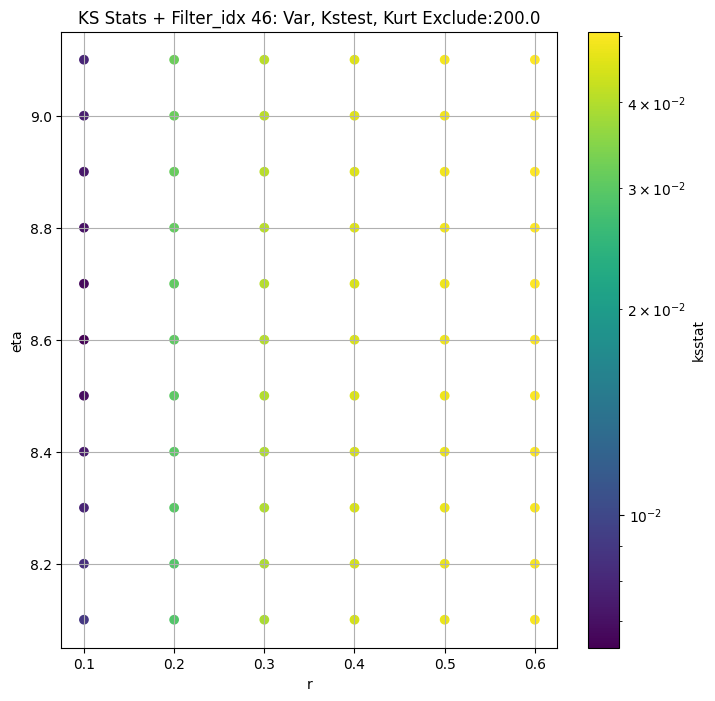

####
Filter_idx  47


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 0 0.0094645136012535 4.734410619240471


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 50 0.011177784013727599 4.411985168443197


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 100 0.009664665644125048 4.237399615092361


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 200 0.00887106041843666 3.9641345186024015
Number of samples: 100000, Without approximation : 196608000.0


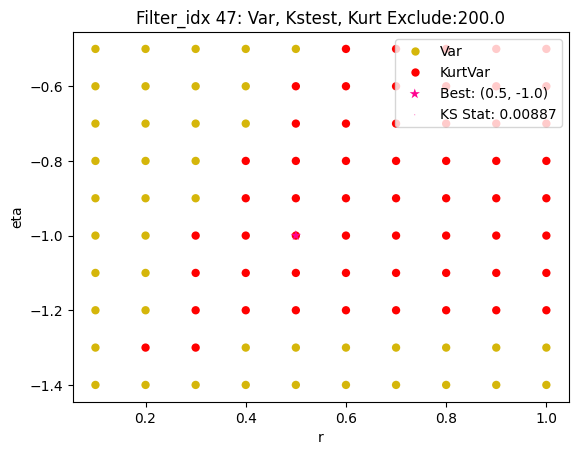

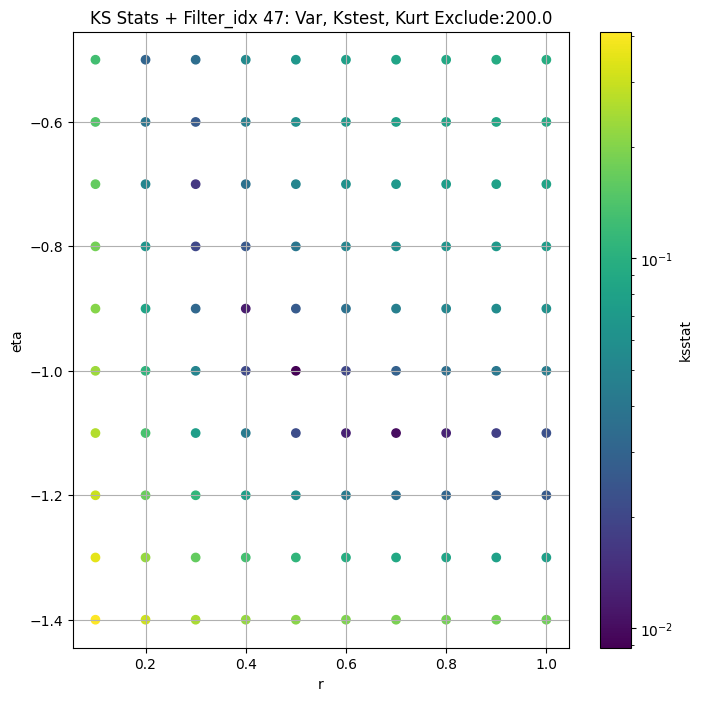

####
Filter_idx  48


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 0 0.012383661743095964 2.866599742049477


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 50 0.013761660092761252 2.4830275122020558


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 100 0.013233604243298891 2.3400125144794375


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 200 0.013417436193858323 2.1389907601093956
Number of samples: 100000, Without approximation : 196608000.0


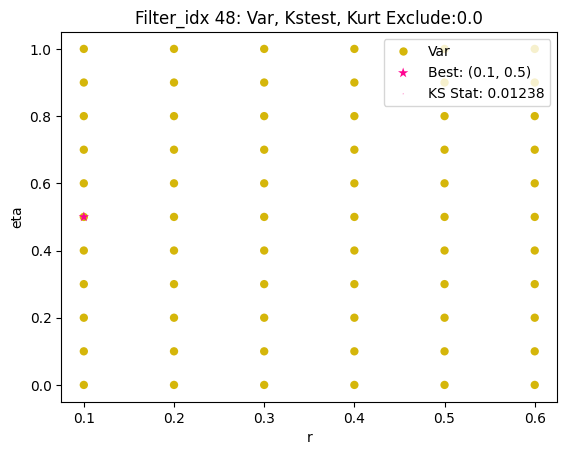

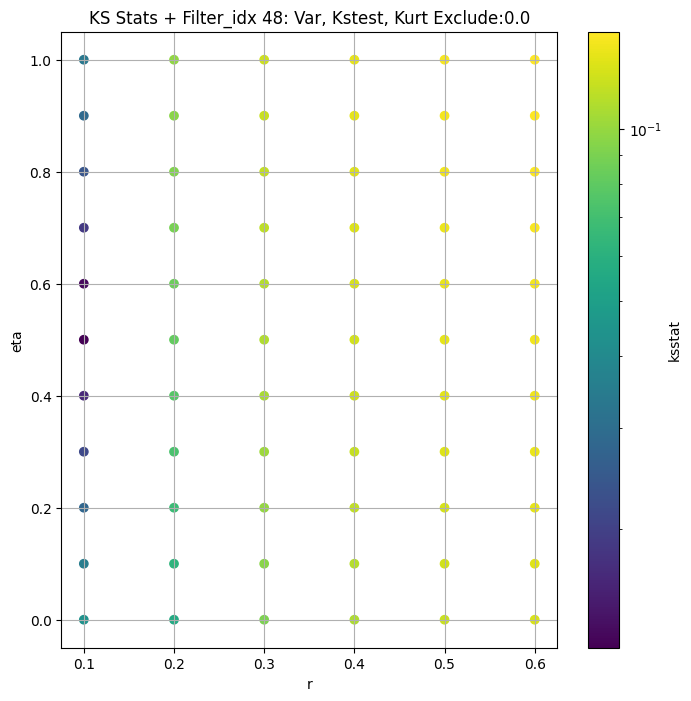

####
Filter_idx  49


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 0 0.009783264172409309 5.535145744993295


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 50 0.010838037641707265 5.015944251951692


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 100 0.011375632245650913 4.778322771749875


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 200 0.013151174683560751 4.4299838300262655
Number of samples: 100000, Without approximation : 196608000.0


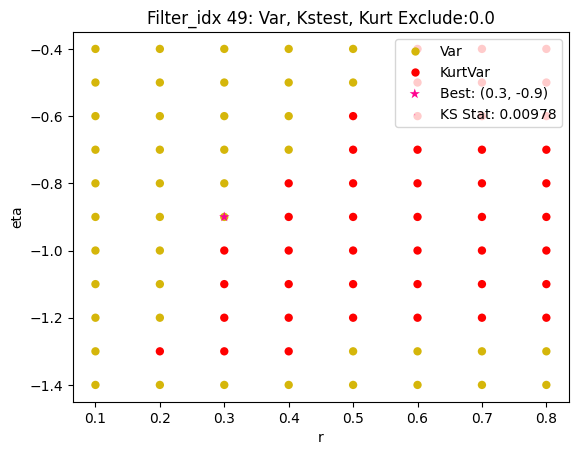

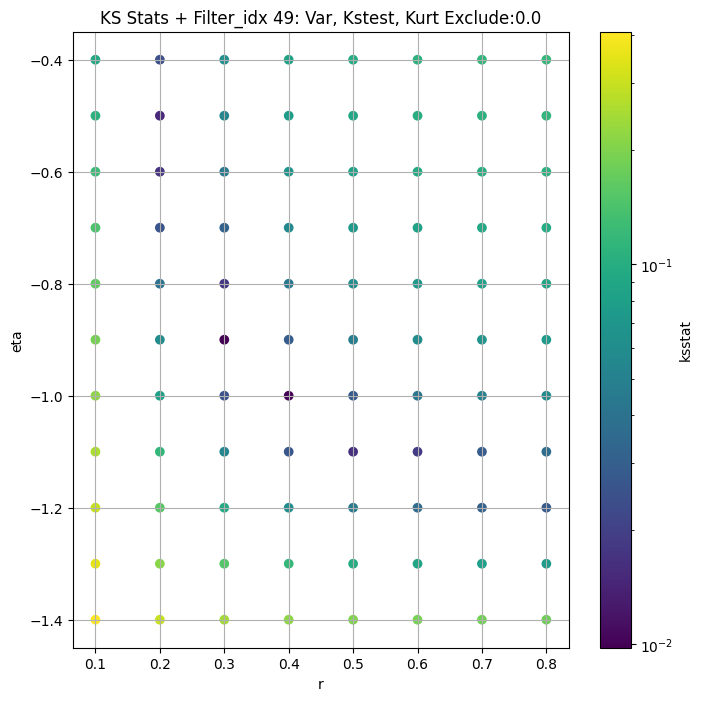

####
Filter_idx  50


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 0 0.00905408462504248 3.3415120807406677


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 50 0.011209428829848767 2.9980743113142503


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 100 0.010224334403454438 2.841410981325586


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 200 0.010047257468082493 2.618863384359146
Number of samples: 100000, Without approximation : 196608000.0


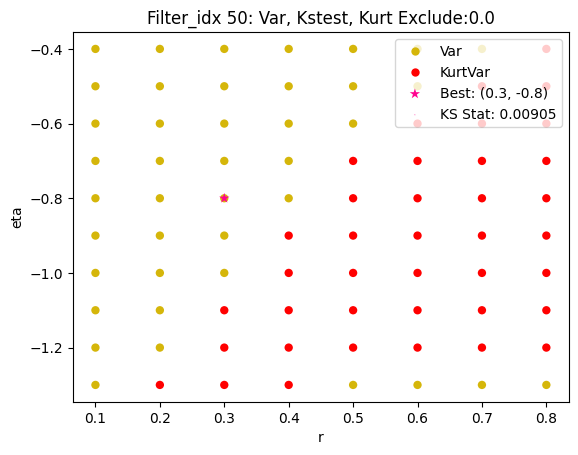

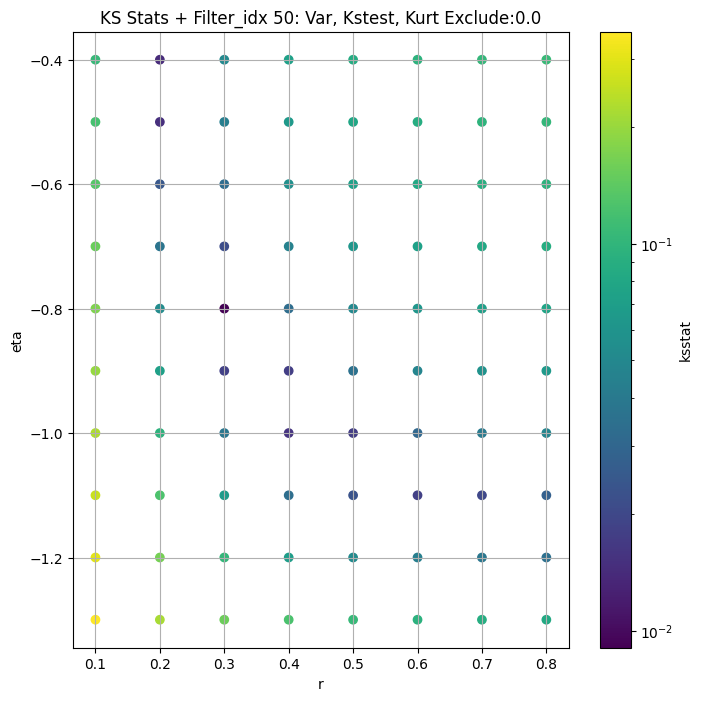

####
Filter_idx  51


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
51 0 0.022607094938112637 7.332507084360567


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
51 50 0.024594523923382128 7.165814548780171


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
51 100 0.025668565581100145 7.077233835919955


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
51 200 0.027441601909244828 6.936837118467024
Number of samples: 100000, Without approximation : 196608000.0


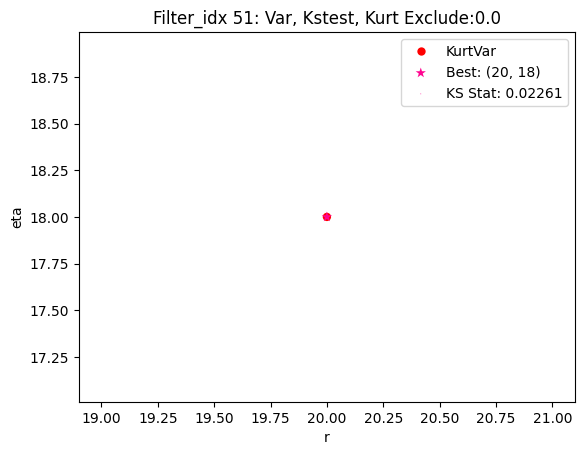

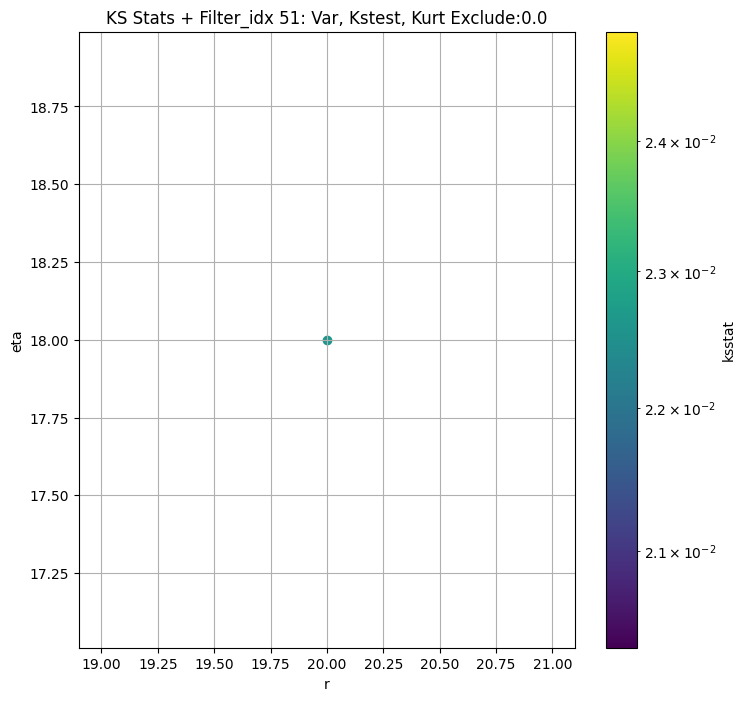

####
Filter_idx  52


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 0 0.021321323109089074 5.278592211937019


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 50 0.021691916748691753 5.120323092988881


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 100 0.021984344850894788 5.039675424763914


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 200 0.022311990625537903 4.91353391633317
Number of samples: 100000, Without approximation : 196608000.0


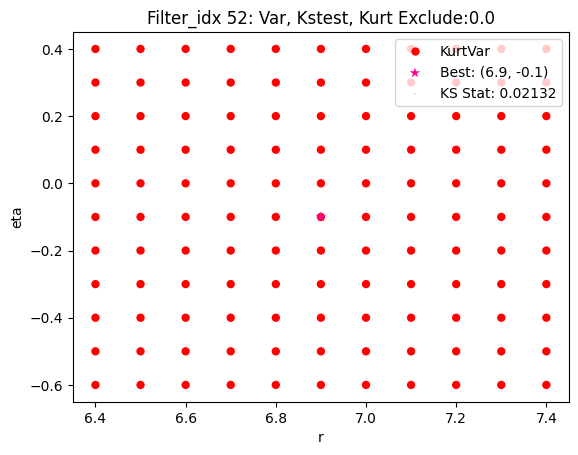

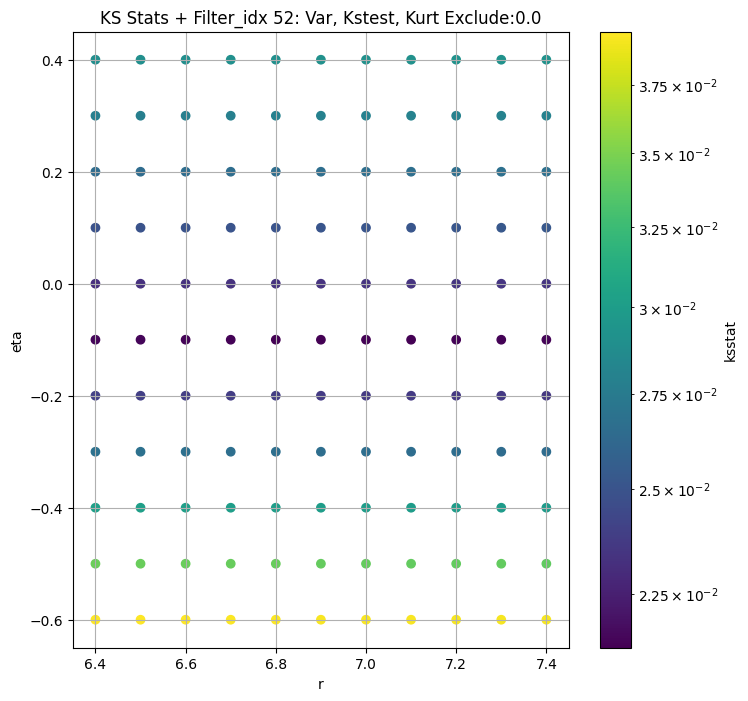

####
Filter_idx  53


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
53 0 0.018906902214310906 1.5653685412774074


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
53 50 0.01919316287944145 1.5159642034773944


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
53 100 0.020016734460041707 1.4909071326606604


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
53 200 0.02175895417245932 1.4515367224036138
Number of samples: 100000, Without approximation : 196608000.0


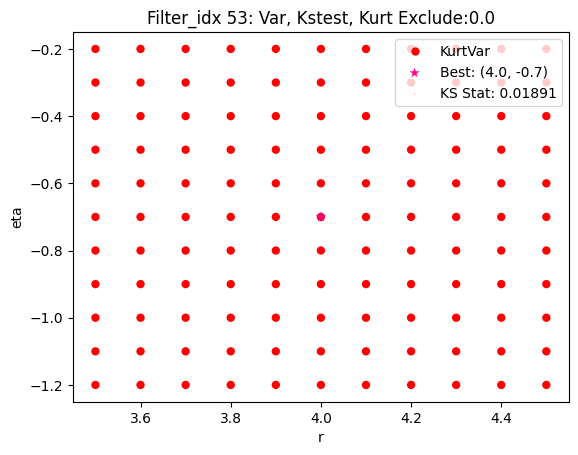

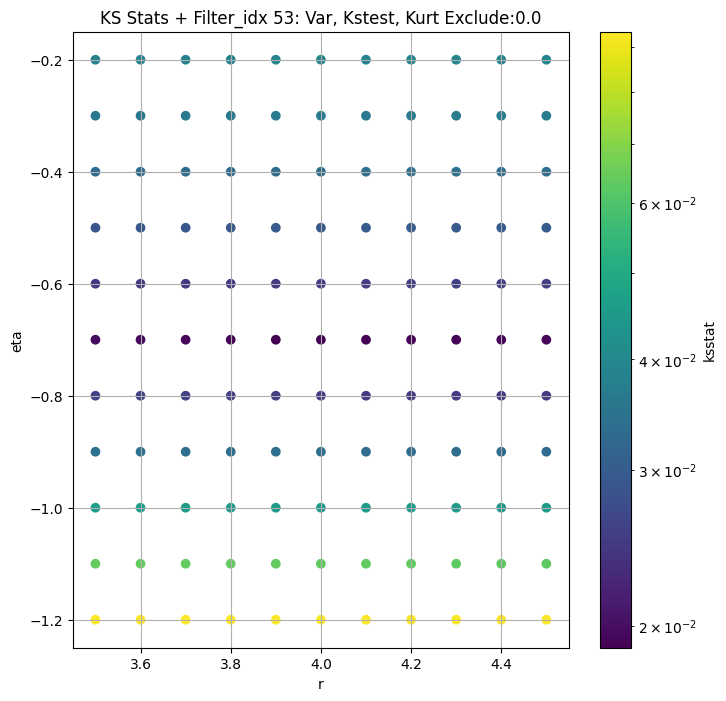

####
Filter_idx  54


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 0 0.012399853444541808 4.06922083527171


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 50 0.016395535268894257 3.5990348547278623


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 100 0.014524715934974286 3.389797709367561


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 200 0.011225296196928358 3.100758081228067
Number of samples: 100000, Without approximation : 196608000.0


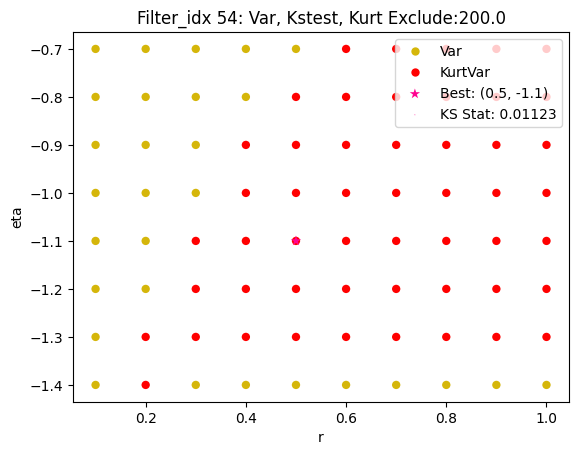

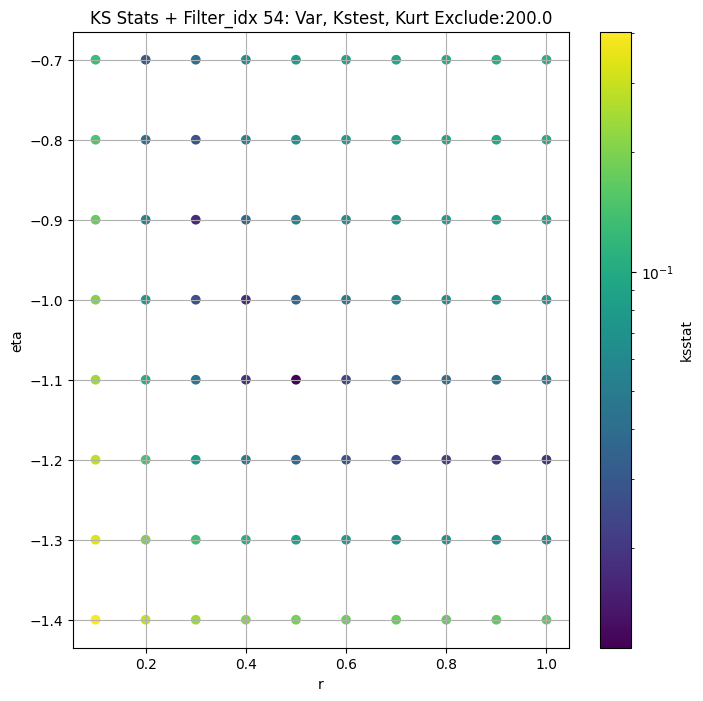

####
Filter_idx  55


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 0 0.011315383448063154 2.850806564374326


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 50 0.009258371408221167 2.503179705202855


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 100 0.010841094118326455 2.3609935855558537


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 200 0.00972576846379719 2.1651963633088545
Number of samples: 100000, Without approximation : 196608000.0


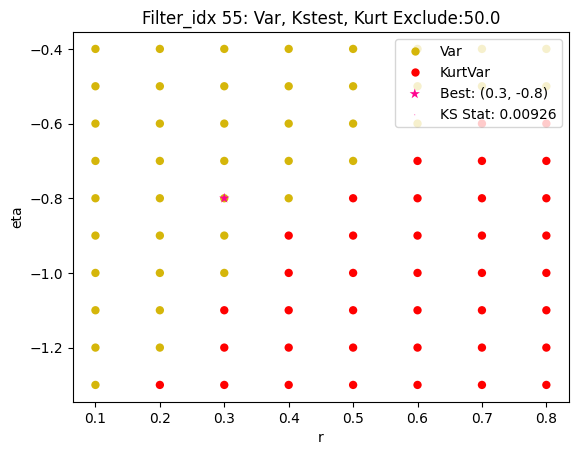

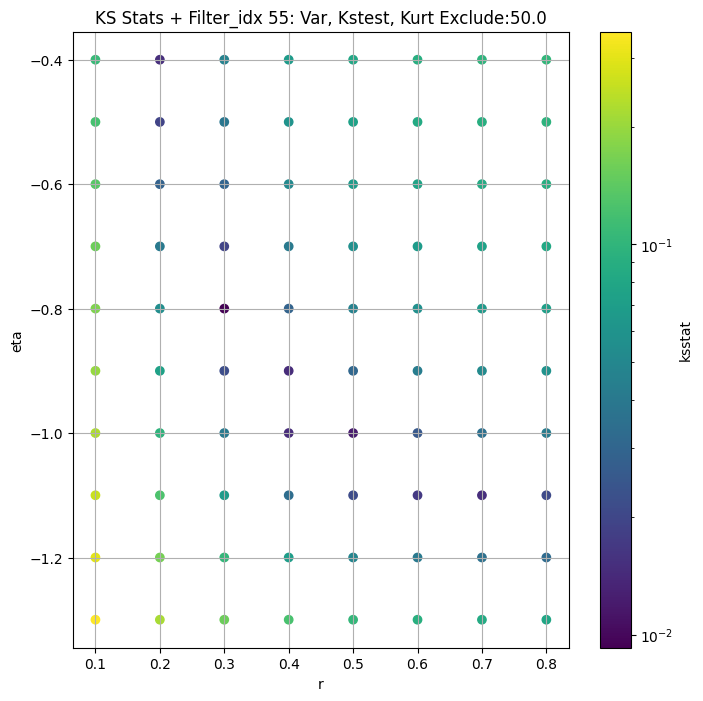

####
Filter_idx  56


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 0 0.012613230609304305 6.159066823729277


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 50 0.015019718773630009 5.57690113048974


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 100 0.012474321041249292 5.298606280534825


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 200 0.012552391210166602 4.878884931955164
Number of samples: 100000, Without approximation : 196608000.0


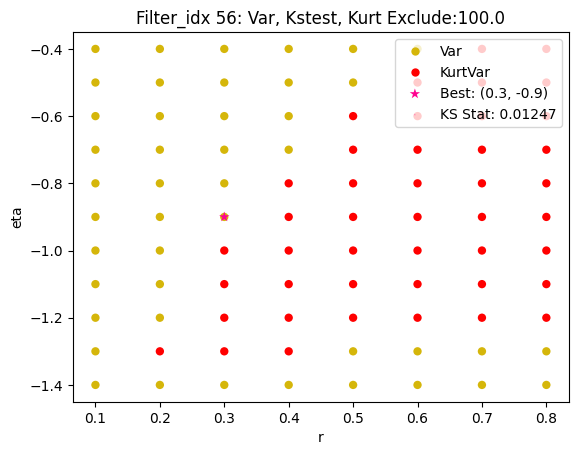

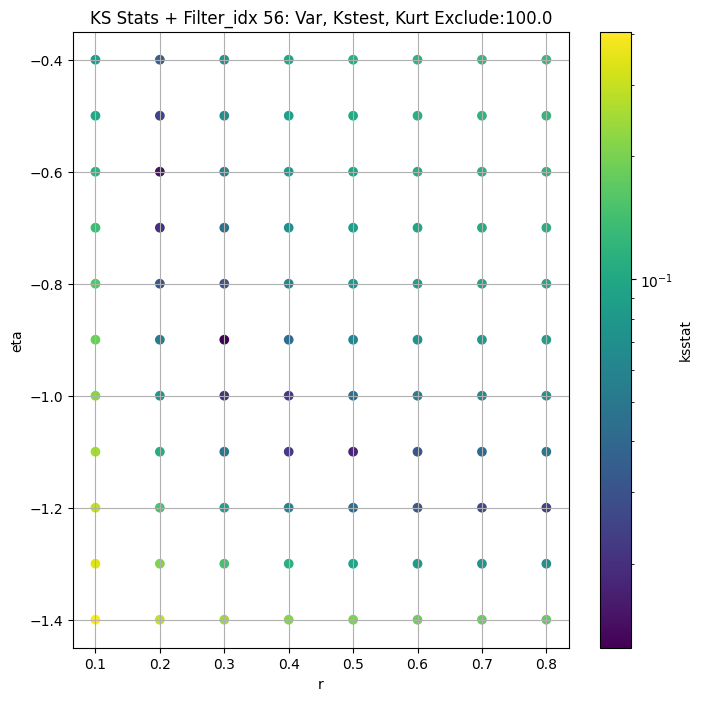

####
Filter_idx  57


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 0 0.007804562503030632 3.1532622329485136


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 50 0.010637279751866846 2.7766963784765433


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 100 0.008781032999908012 2.630961539800639


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 200 0.007272668998964921 2.4269891195150928
Number of samples: 100000, Without approximation : 196608000.0


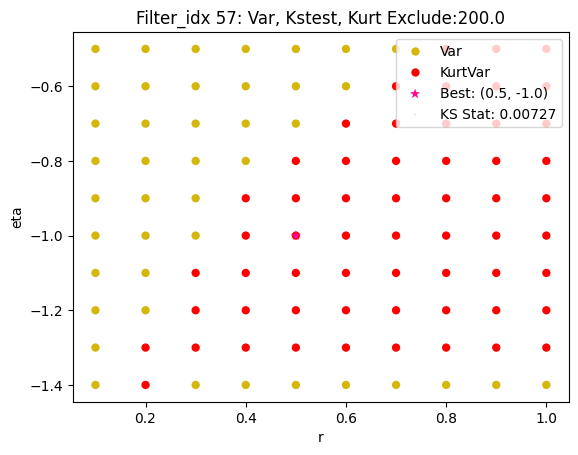

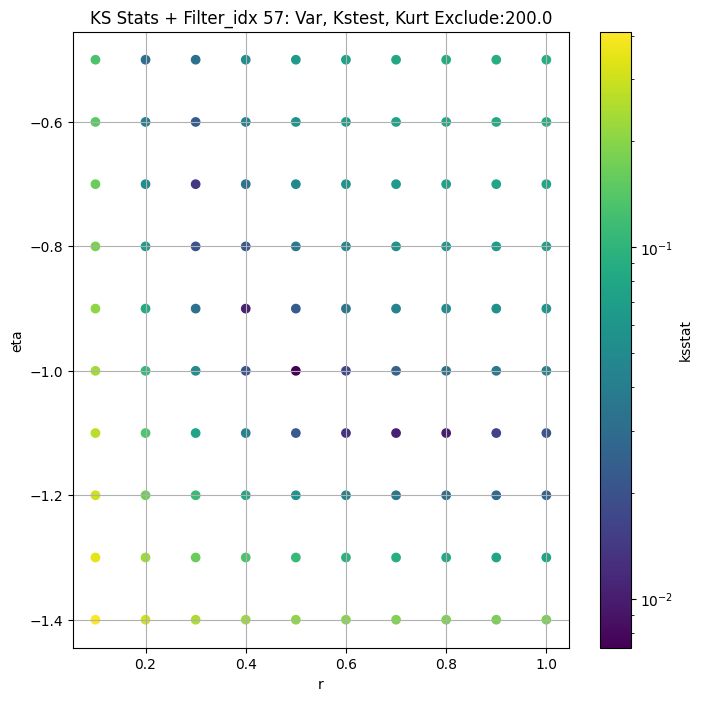

####
Filter_idx  58


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 0 0.02080313386354493 2.8596056017484406


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 50 0.02113347964324719 2.768315212099537


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 100 0.02231875625923202 2.7251143289022135


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 200 0.024312389366141496 2.658529012188209
Number of samples: 100000, Without approximation : 196608000.0


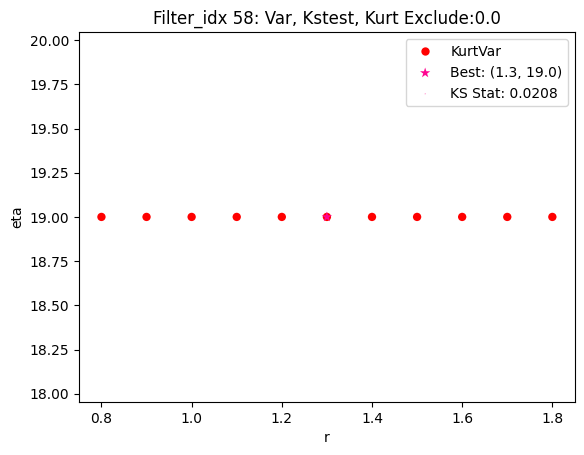

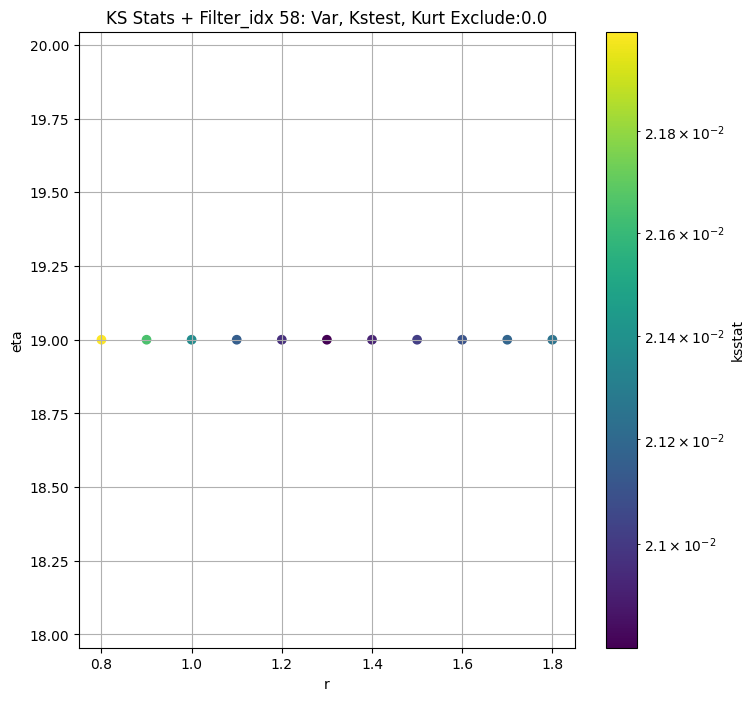

####
Filter_idx  59


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 0 0.009238922929359017 6.9931679208625654


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 50 0.010235914580353889 6.523877216494874


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 100 0.009943133466902343 6.277027509775488


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 200 0.010157968716201338 5.899923350034629
Number of samples: 100000, Without approximation : 196608000.0


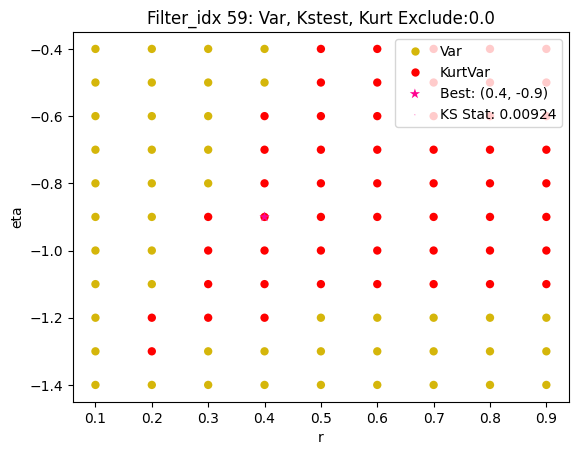

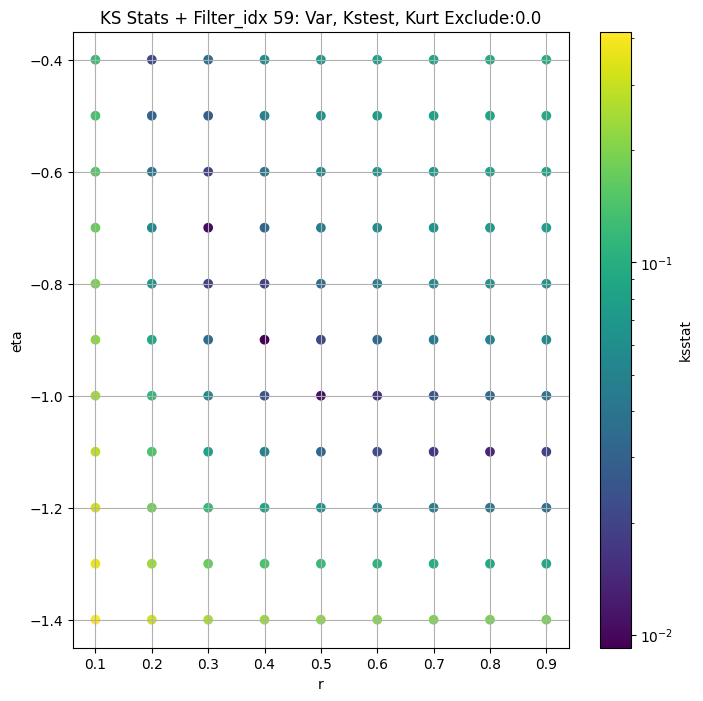

####
Filter_idx  60


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 0 0.008773441681717481 0.8953706362141154


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 50 0.0073995389260000655 0.7875493226256042


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 100 0.008395197363460949 0.7499865191436581


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 200 0.009017571196392987 0.6965234430858641
Number of samples: 100000, Without approximation : 196608000.0


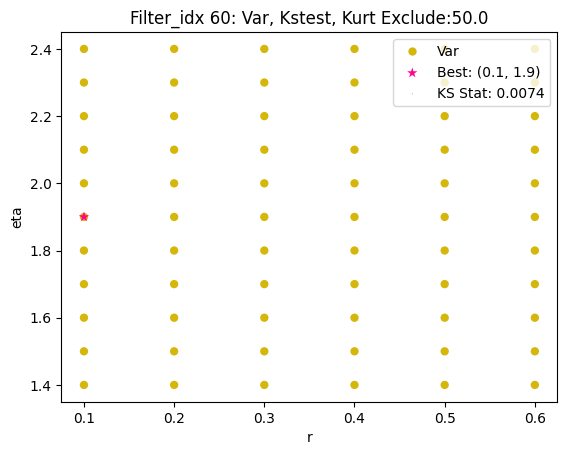

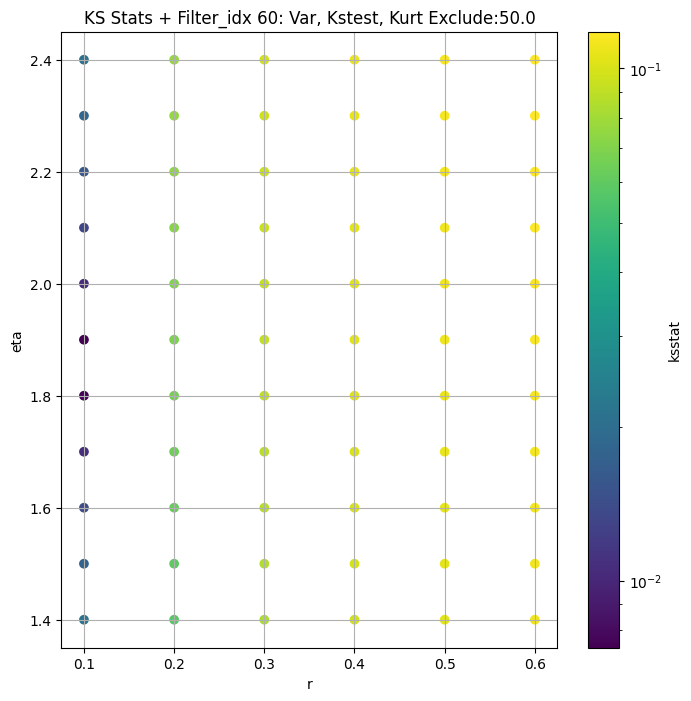

####
Filter_idx  61


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 0 0.014979250564933322 2.7025299757469377


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 50 0.01493919794480486 2.414910866917882


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 100 0.015730547811650064 2.2789464985928003


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 200 0.014409477896271672 2.0852106846246885
Number of samples: 100000, Without approximation : 196608000.0


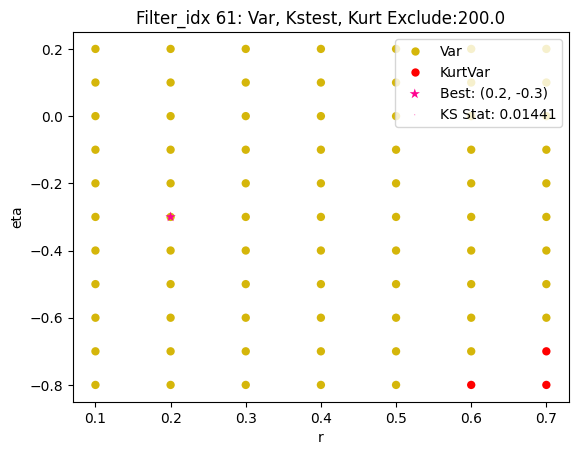

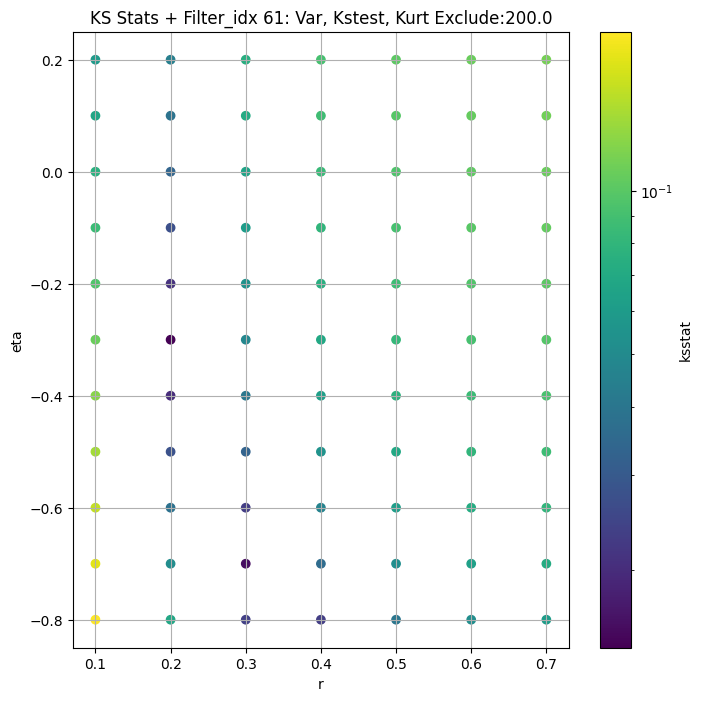

####
Filter_idx  62


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 0 0.020109383488670418 5.881373592401723


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 50 0.02084775944886308 5.4944473876131665


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 100 0.021337956421110138 5.275797653225952


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 200 0.019537931806264897 4.9366865958391015
Number of samples: 100000, Without approximation : 196608000.0


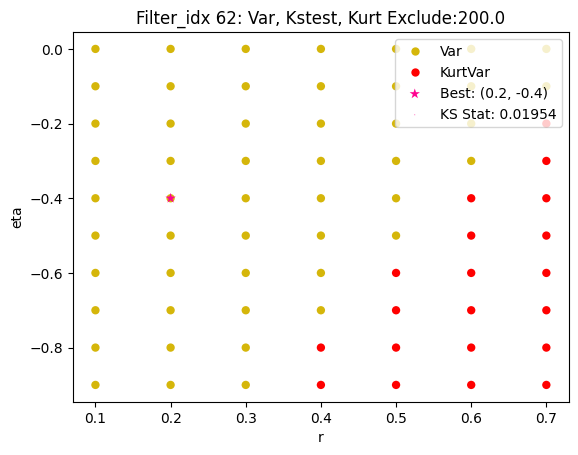

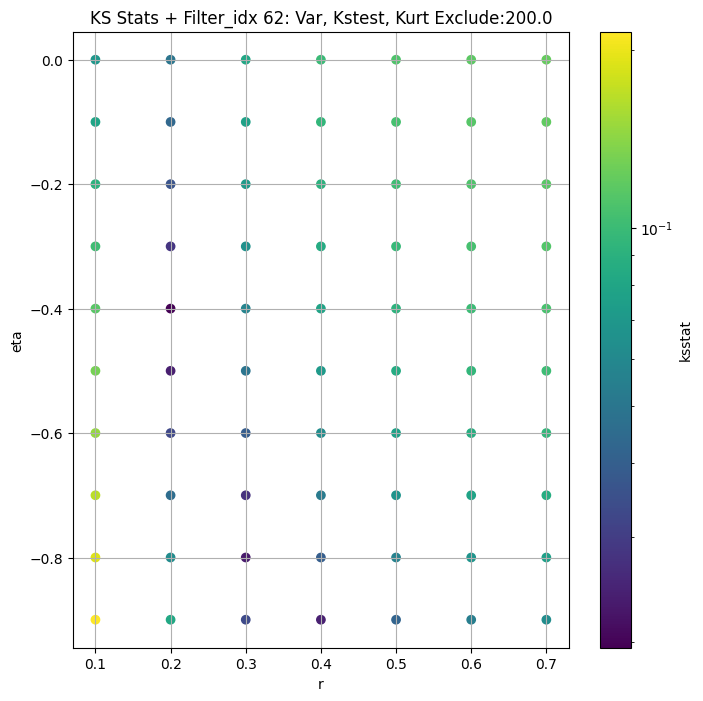

####
Filter_idx  63


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 0 0.014180017053802008 2.624194787334652


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 50 0.012524253052172002 2.2728803610154826


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 100 0.013448515019687357 2.145631415952161


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 200 0.014038334358106308 1.9694085545599944
Number of samples: 100000, Without approximation : 196608000.0


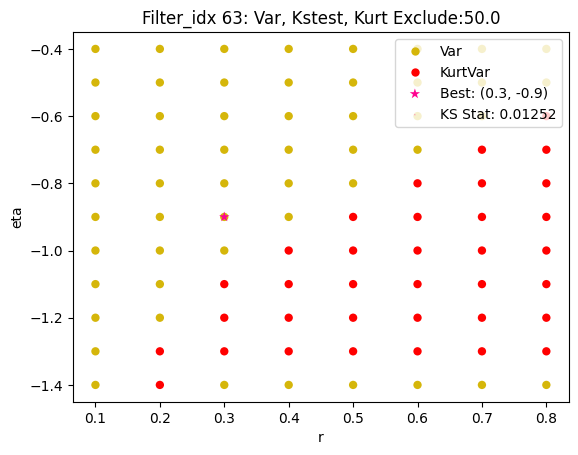

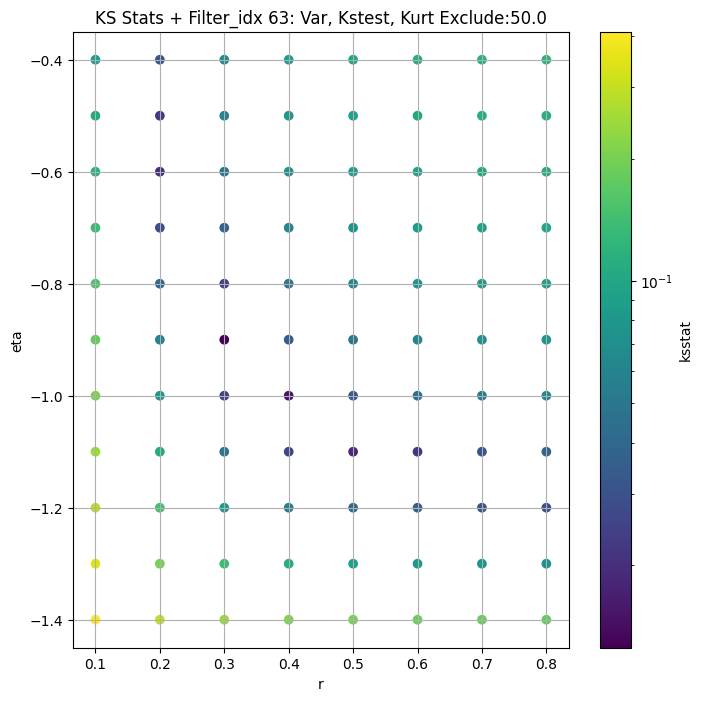

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,
0,5.587389,3.885470,13.307504,43.956472,5.678748,345.988257,196608000.0,dual_color,0.011997,0.2,-0.2,1.228525e-04,50.0,5.077972,0.000097
1,6.543445,5.507461,8.010498,2.258367,0.206318,46.515398,196608000.0,misc,0.011271,5.1,-0.4,1.287905e+01,0.0,6.543445,0.000097
2,6.842030,4.740584,16.758177,50.019856,7.108069,371.586526,196608000.0,dual_color,0.008743,0.3,-0.9,1.705011e-01,0.0,6.842030,0.000097
3,4.693403,3.106138,13.014913,80.960090,7.116940,401.350471,196608000.0,single_edge,0.008430,0.4,-1.0,7.931570e-01,100.0,3.870382,0.000097
4,8.801267,6.170591,16.023569,23.755599,7.612705,220.589878,196608000.0,dual_color,0.010902,0.3,-0.9,1.940891e-01,100.0,7.788591,0.000097
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59,6.993168,5.147639,11.589897,17.092017,4.888674,185.352867,196608000.0,dual_color,0.009239,0.4,-0.9,1.032922e+00,0.0,6.993168,0.000097
60,0.895371,0.619209,2.922394,107.248915,6.033080,506.367796,196608000.0,misc,0.007400,0.1,1.9,1.131923e-16,50.0,0.787549,0.000097
61,2.702530,1.776317,5.629499,40.835927,7.272000,295.428482,196608000.0,misc,0.014409,0.2,-0.3,6.895538e-05,200.0,2.085211,0.000097


In [12]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()} ", group)
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [13]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 0, 50.0 + 100 = 150, ksstat: 0.011842918340313924, var: 4.666017861251157


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 0, 50.0 + 75 = 125, ksstat: 0.011842133137842215, var: 4.753522730014533


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 0, 50.0 + 50 = 100, ksstat: 0.011841756293810346, var: 4.849297056899367


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 0, 50.0 + 25 = 75, ksstat: 0.011840314386687645, var: 4.955935473492539


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 0, 50.0 + 0 = 50, ksstat: 0.011843015731704654, var: 5.077971933818975


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 0, 50.0 + -25 = 25, ksstat: 0.011841316747758401, var: 5.225802075750504


  0%|          | 0/1131 [00:00<?, ?it/s]

Finding Minimum after computing 1131 CDFs
filter_idx 0, 50.0 + -50 = 0, ksstat: 0.011841563438380054, var: 5.587389215930188
Number of samples: 100000, Without approximation : 196608000.0


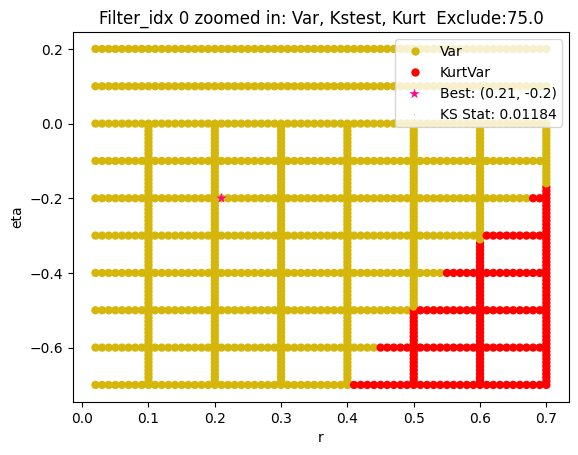

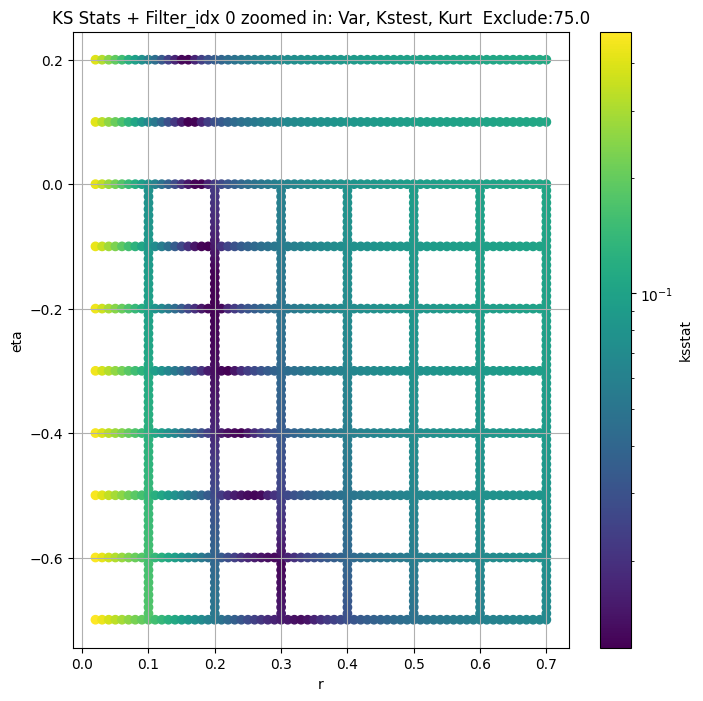

Filter_idx 1


  0%|          | 0/162 [00:00<?, ?it/s]

Finding Minimum after computing 162 CDFs
filter_idx 1, 0.0 + 100 = 100, ksstat: 0.013315239167976306, var: 6.260551298677809


  0%|          | 0/162 [00:00<?, ?it/s]

Finding Minimum after computing 162 CDFs
filter_idx 1, 0.0 + 75 = 75, ksstat: 0.012952661694278, var: 6.307264984432083


  0%|          | 0/162 [00:00<?, ?it/s]

Finding Minimum after computing 162 CDFs
filter_idx 1, 0.0 + 50 = 50, ksstat: 0.012578117417741563, var: 6.359779017313924


  0%|          | 0/162 [00:00<?, ?it/s]

Finding Minimum after computing 162 CDFs
filter_idx 1, 0.0 + 25 = 25, ksstat: 0.012156230584009442, var: 6.421858435156562


  0%|          | 0/162 [00:00<?, ?it/s]

Finding Minimum after computing 162 CDFs
filter_idx 1, 0.0 + 0 = 0, ksstat: 0.011271216834734754, var: 6.54344462754433
Number of samples: 100000, Without approximation : 196608000.0


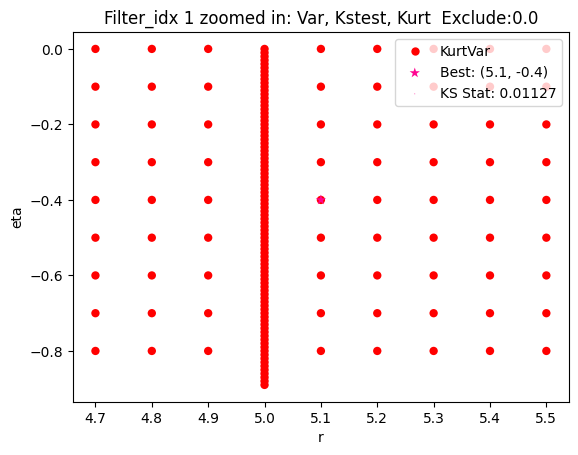

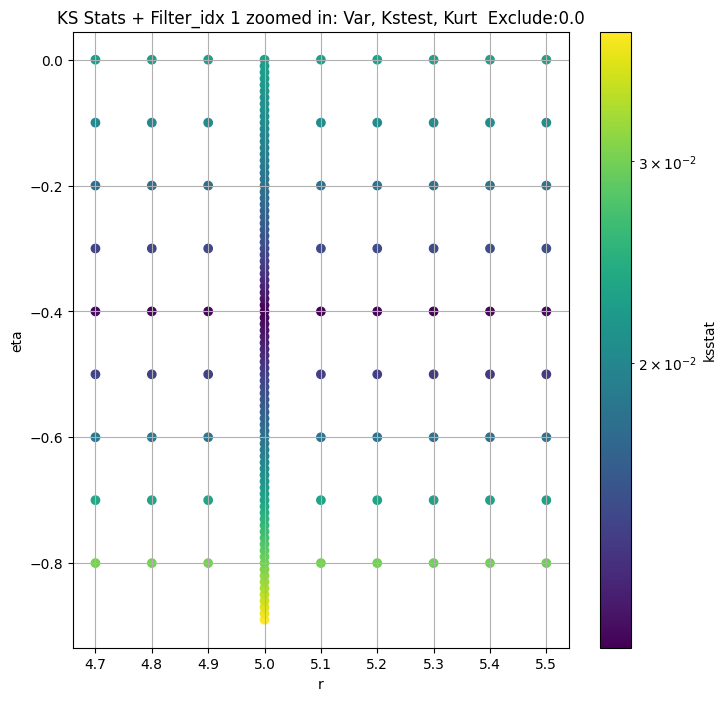

Filter_idx 2


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 2, 0.0 + 100 = 100, ksstat: 0.006917474985312033, var: 5.80811925918025


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 2, 0.0 + 75 = 75, ksstat: 0.006912897972306209, var: 5.959572914457771


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 2, 0.0 + 50 = 50, ksstat: 0.00657939886665998, var: 6.134035465525453


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 2, 0.0 + 25 = 25, ksstat: 0.006758193906569954, var: 6.347335550207369


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 2, 0.0 + 0 = 0, ksstat: 0.006631193132401736, var: 6.8420296859164695
Number of samples: 100000, Without approximation : 196608000.0


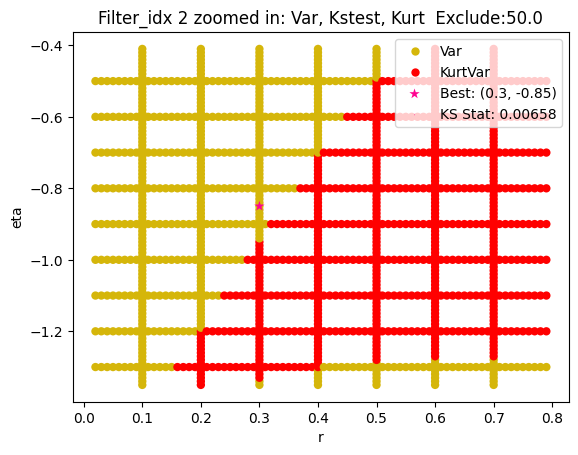

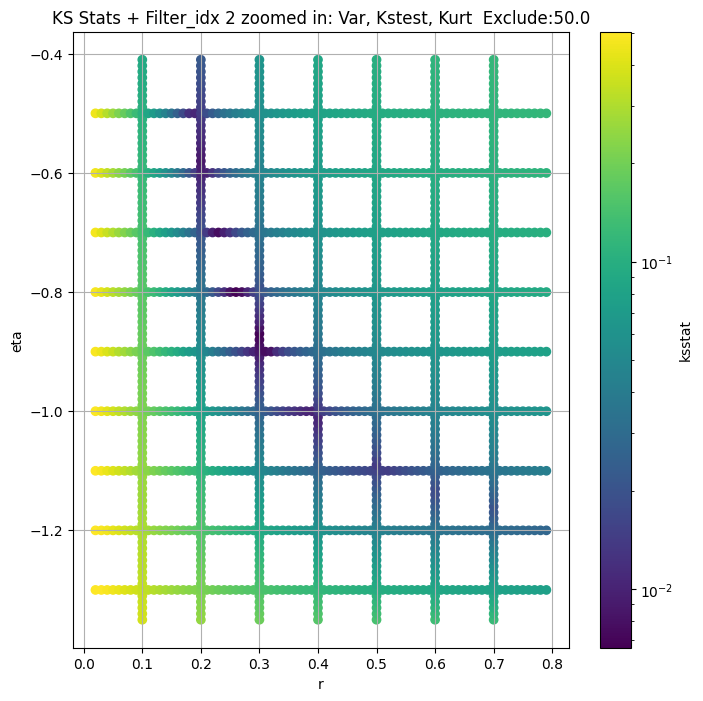

Filter_idx 3


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 3, 100.0 + 100 = 200, ksstat: 0.007871227060710861, var: 3.5522222533872654


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 3, 100.0 + 75 = 175, ksstat: 0.007750938269745156, var: 3.6217310789909054


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 3, 100.0 + 50 = 150, ksstat: 0.008193012479506767, var: 3.6969458840178877


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 3, 100.0 + 25 = 125, ksstat: 0.0074508089124278865, var: 3.7791454268221822


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 3, 100.0 + 0 = 100, ksstat: 0.006774295438022299, var: 3.8703824255623753


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 3, 100.0 + -25 = 75, ksstat: 0.0066075204762411355, var: 3.973959570383655


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 3, 100.0 + -50 = 50, ksstat: 0.006340324157946942, var: 4.096177312069258


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 3, 100.0 + -75 = 25, ksstat: 0.0061556273027546515, var: 4.252021728898035


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 3, 100.0 + -100 = 0, ksstat: 0.005978172579283916, var: 4.693403406530854
Number of samples: 100000, Without approximation : 196608000.0


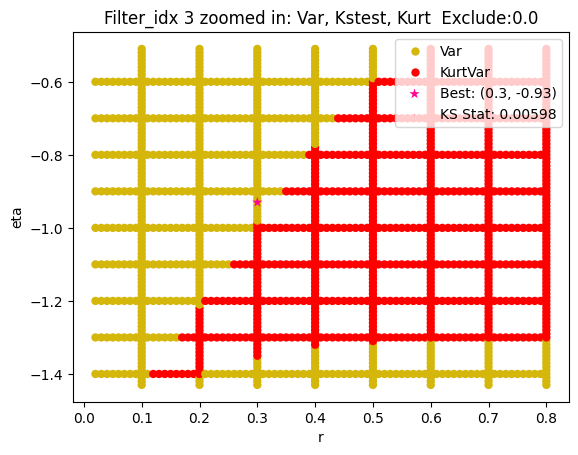

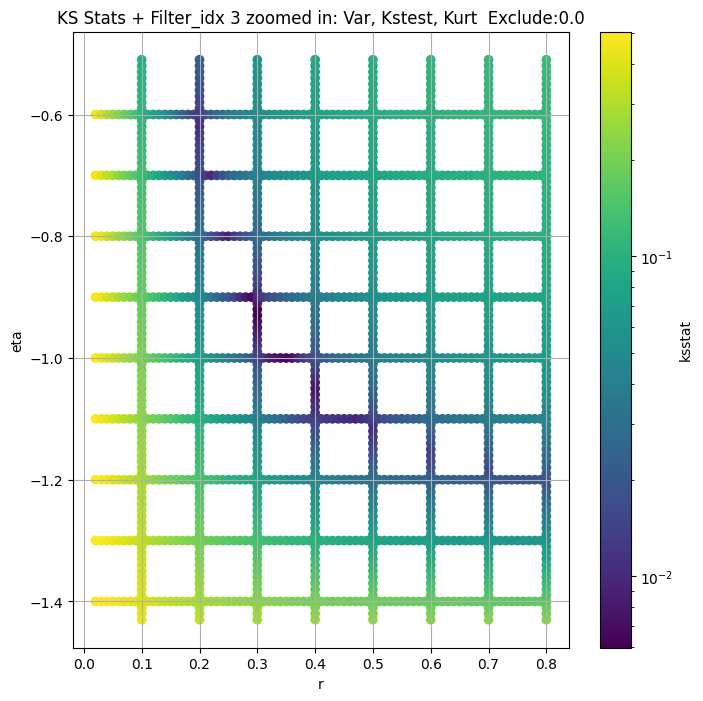

Filter_idx 4


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + 100 = 200, ksstat: 0.011631923747805528, var: 7.231173735014925


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + 75 = 175, ksstat: 0.011612343061392583, var: 7.3573940539692435


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + 50 = 150, ksstat: 0.0109550309735853, var: 7.4913058823212015


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + 25 = 125, ksstat: 0.010577124919455838, var: 7.634381860574747


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + 0 = 100, ksstat: 0.01035126980257578, var: 7.788591074141813


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + -25 = 75, ksstat: 0.01023115225445681, var: 7.956763802056642


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + -50 = 50, ksstat: 0.010245300855573736, var: 8.143811124854903


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + -75 = 25, ksstat: 0.010564431781925177, var: 8.361907614677685


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + -100 = 0, ksstat: 0.009305712199686789, var: 8.801267447485516
Number of samples: 100000, Without approximation : 196608000.0


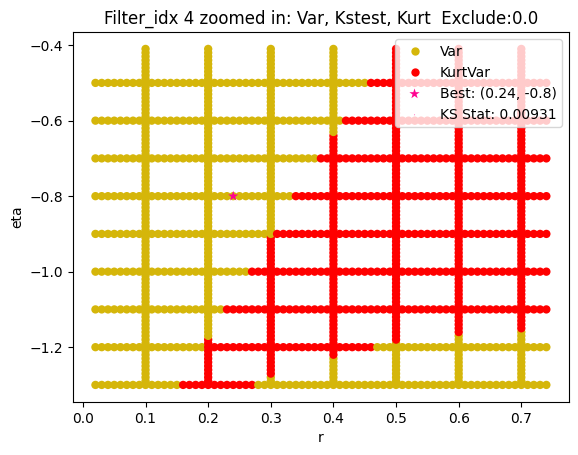

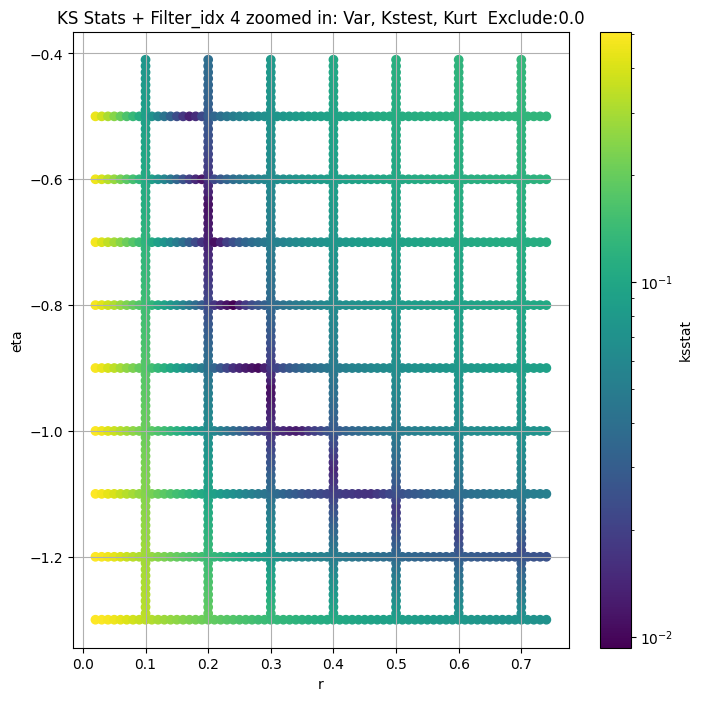

Filter_idx 5


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 50.0 + 100 = 150, ksstat: 0.014767649397717741, var: 4.906408121615004


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 50.0 + 75 = 125, ksstat: 0.014948984464451975, var: 4.985636354178075


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 50.0 + 50 = 100, ksstat: 0.01487558996486904, var: 5.070979136279664


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 50.0 + 25 = 75, ksstat: 0.014969789329008387, var: 5.164206568930106


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 50.0 + 0 = 50, ksstat: 0.014375832144938205, var: 5.268535223583838


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 50.0 + -25 = 25, ksstat: 0.014275812954101741, var: 5.390905439588583


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 5, 50.0 + -50 = 0, ksstat: 0.014713556827706309, var: 5.643842373468628
Number of samples: 100000, Without approximation : 196608000.0


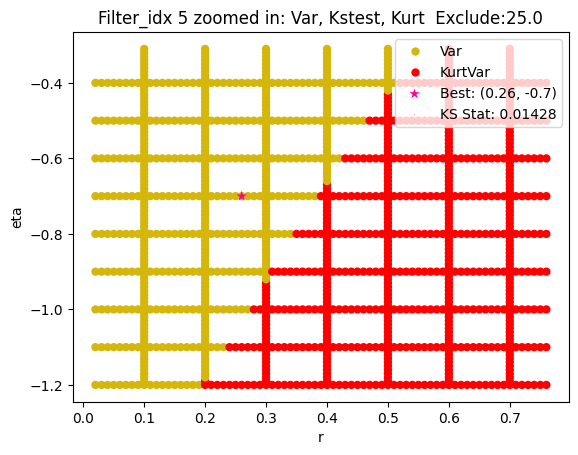

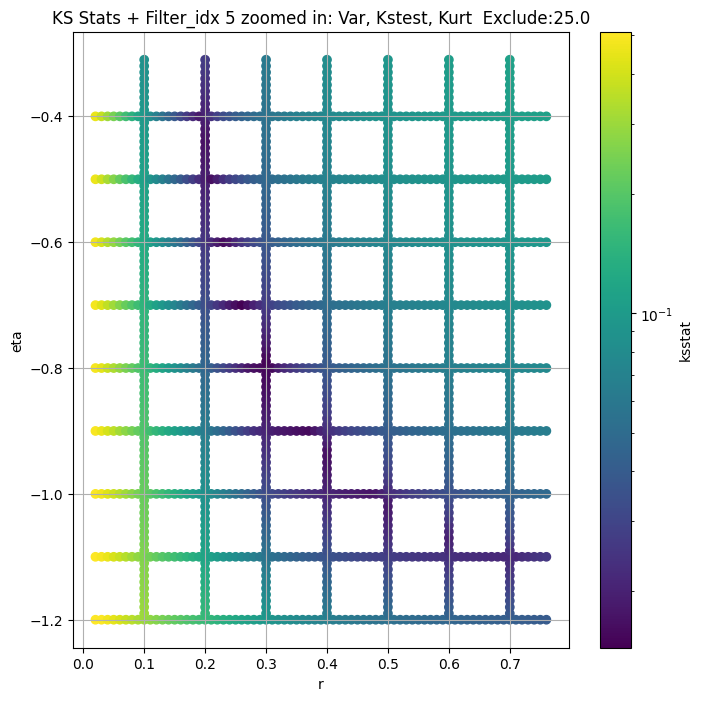

Filter_idx 6


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 6, 50.0 + 100 = 150, ksstat: 0.007612226367862185, var: 2.359284183645761


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 6, 50.0 + 75 = 125, ksstat: 0.007797417816099772, var: 2.4043785100235606


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 6, 50.0 + 50 = 100, ksstat: 0.007735056240903648, var: 2.4541745659327416


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 6, 50.0 + 25 = 75, ksstat: 0.007436829875521522, var: 2.5103155309932097


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 6, 50.0 + 0 = 50, ksstat: 0.00741539122201107, var: 2.575842760618245


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 6, 50.0 + -25 = 25, ksstat: 0.007246024635146009, var: 2.658097664024081


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 6, 50.0 + -50 = 0, ksstat: 0.007249108187161624, var: 2.878008310835161
Number of samples: 100000, Without approximation : 196608000.0


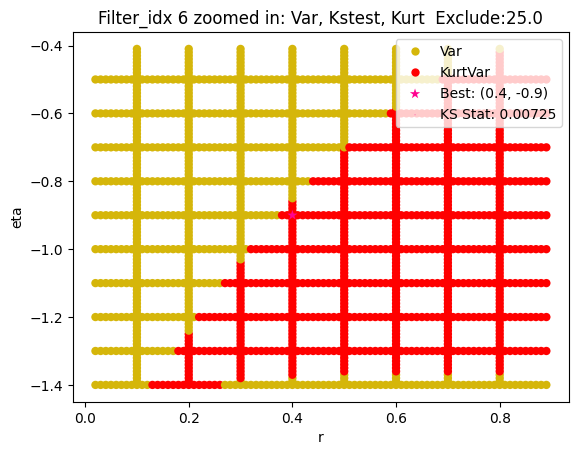

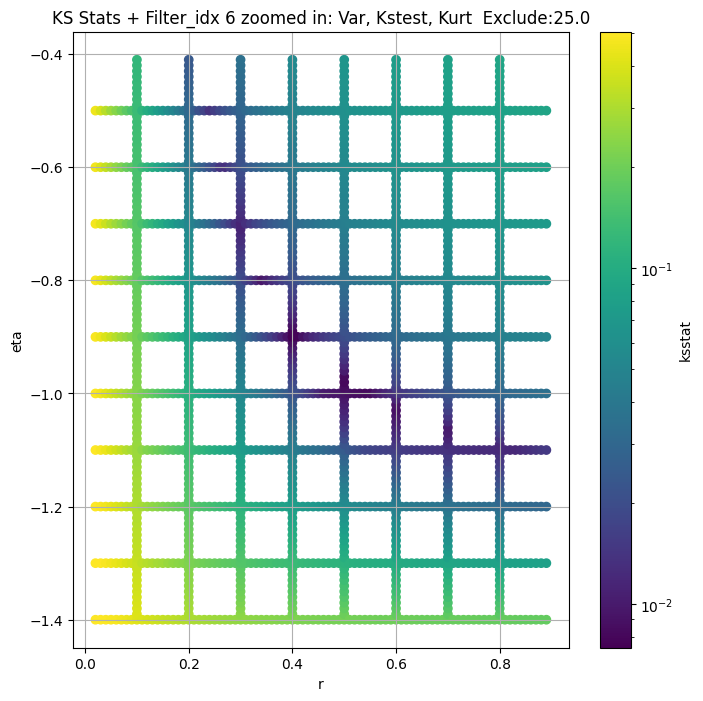

Filter_idx 7


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 7, 50.0 + 100 = 150, ksstat: 0.010144697649956846, var: 3.193145155190705


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 7, 50.0 + 75 = 125, ksstat: 0.010133645071882524, var: 3.219145284320327


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 7, 50.0 + 50 = 100, ksstat: 0.010126868627691243, var: 3.2472362599907196


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 7, 50.0 + 25 = 75, ksstat: 0.010126859712254799, var: 3.2781111213393777


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 7, 50.0 + 0 = 50, ksstat: 0.010126921811231093, var: 3.3129633900626403


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 7, 50.0 + -25 = 25, ksstat: 0.010127148589247736, var: 3.3546016155229714


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 7, 50.0 + -50 = 0, ksstat: 0.01012704790552249, var: 3.4521114675605724
Number of samples: 100000, Without approximation : 196608000.0


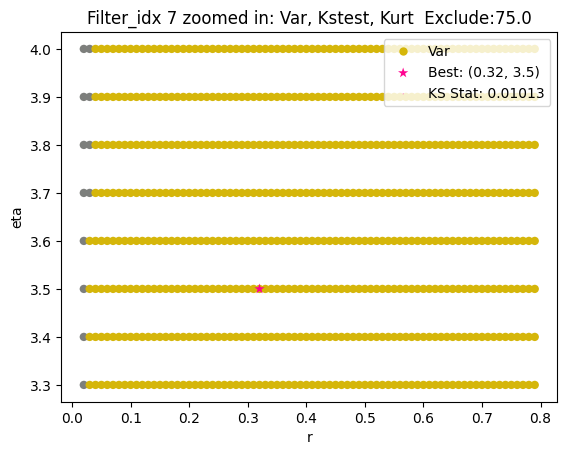

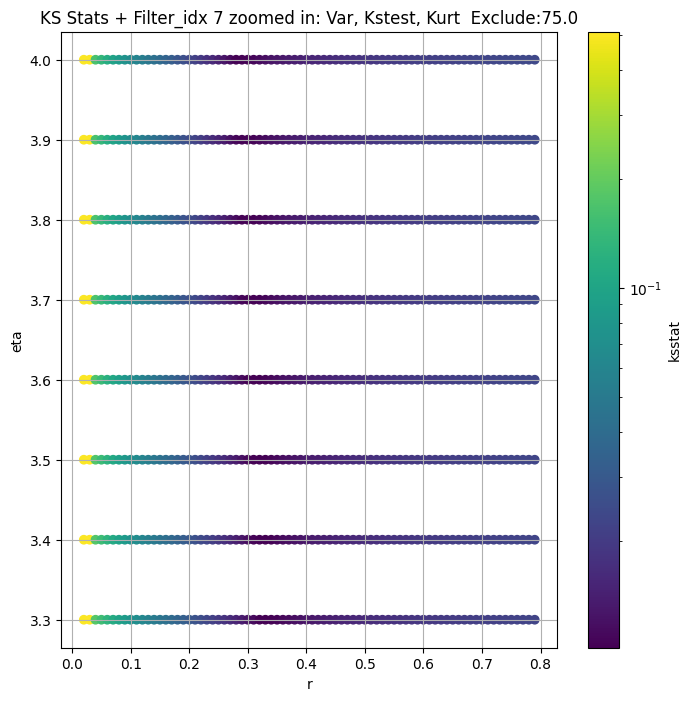

Filter_idx 8


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 50.0 + 100 = 150, ksstat: 0.00863466779002698, var: 0.33712871582748416


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 50.0 + 75 = 125, ksstat: 0.008207171918017751, var: 0.3431239791490173


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 50.0 + 50 = 100, ksstat: 0.007743132486425698, var: 0.3497388556388851


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 50.0 + 25 = 75, ksstat: 0.007266723811007791, var: 0.357192250847258


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 50.0 + 0 = 50, ksstat: 0.007122007603720934, var: 0.3658933975876729


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 50.0 + -25 = 25, ksstat: 0.006764284048426883, var: 0.37681222654477053


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 50.0 + -50 = 0, ksstat: 0.008326855770583064, var: 0.4191771402520714
Number of samples: 100000, Without approximation : 196608000.0


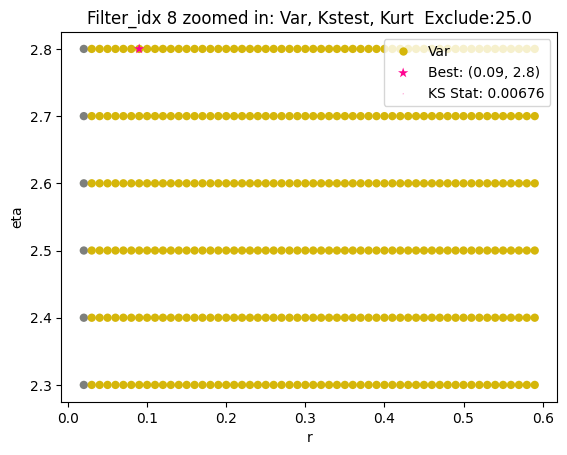

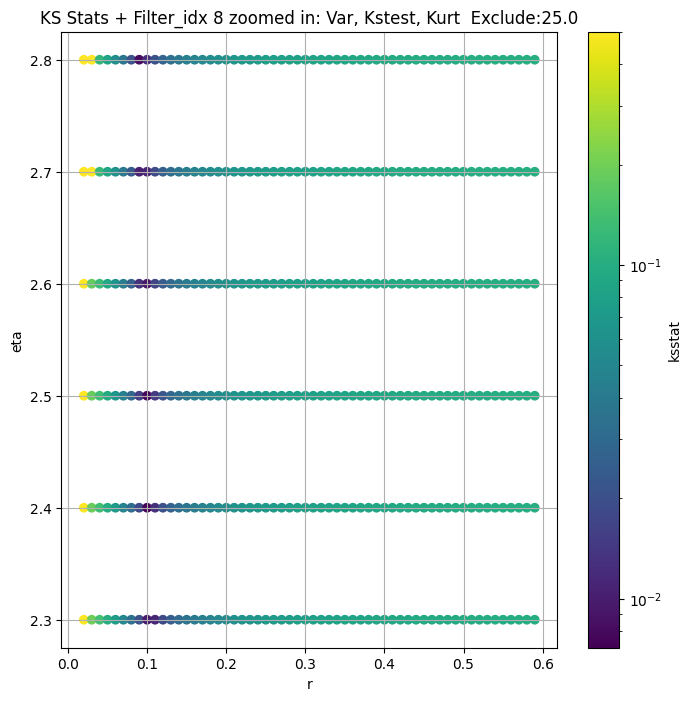

Filter_idx 9


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 9, 100.0 + 100 = 200, ksstat: 0.012245056454444195, var: 2.170125451683052


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 9, 100.0 + 75 = 175, ksstat: 0.011267623005621855, var: 2.217145009418058


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 9, 100.0 + 50 = 150, ksstat: 0.011379057549816052, var: 2.268468075967841


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 9, 100.0 + 25 = 125, ksstat: 0.011105537241913654, var: 2.3251701180173754


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 9, 100.0 + 0 = 100, ksstat: 0.011566548506654839, var: 2.3888317693321537


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 9, 100.0 + -25 = 75, ksstat: 0.011320564201592997, var: 2.4620957841989606


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 9, 100.0 + -50 = 50, ksstat: 0.011642982733064966, var: 2.5499188643951003


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 9, 100.0 + -75 = 25, ksstat: 0.0116728841355722, var: 2.6644347909319044


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 9, 100.0 + -100 = 0, ksstat: 0.009527066402622283, var: 2.967988228683067
Number of samples: 100000, Without approximation : 196608000.0


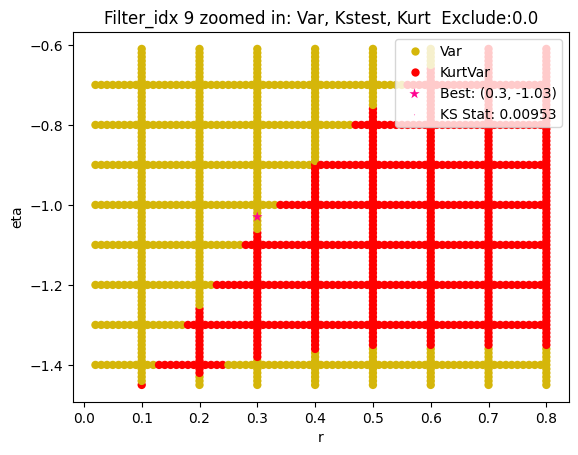

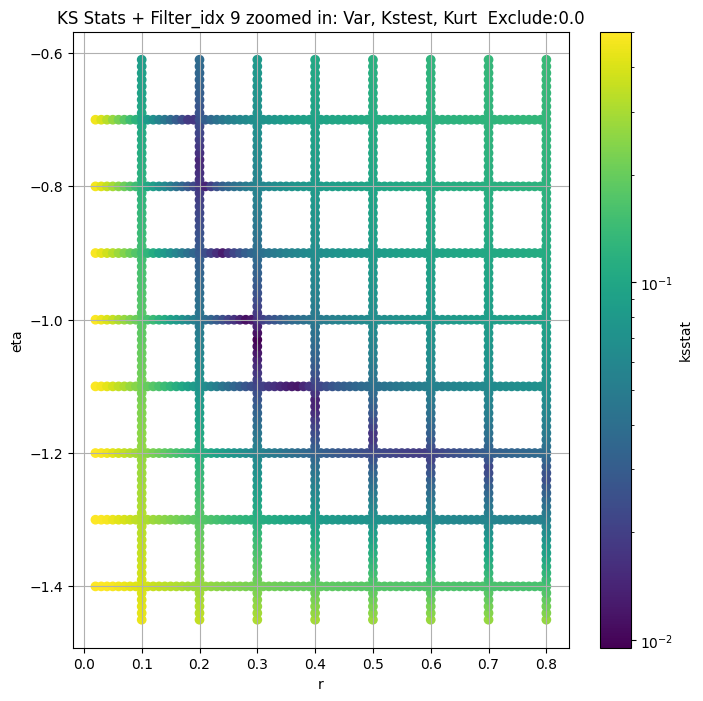

Filter_idx 10


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 100 = 100, ksstat: 0.00632428687820874, var: 2.9508876037448193


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 75 = 75, ksstat: 0.005814244889274844, var: 3.016983103541635


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 50 = 50, ksstat: 0.005362922303979278, var: 3.093672665495139


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 25 = 25, ksstat: 0.005323388762221715, var: 3.1889702320653557


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 0 = 0, ksstat: 0.005083313058859951, var: 3.462142868504575
Number of samples: 100000, Without approximation : 196608000.0


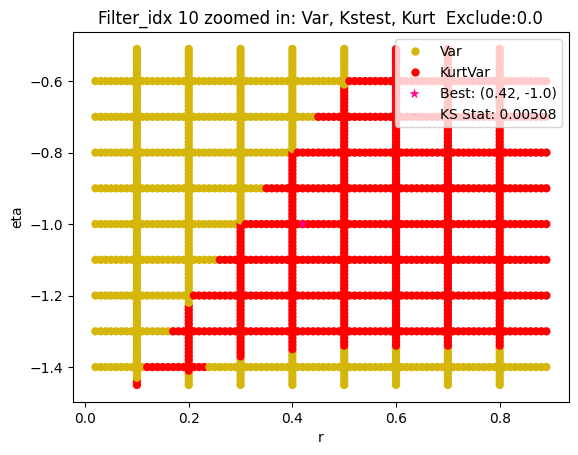

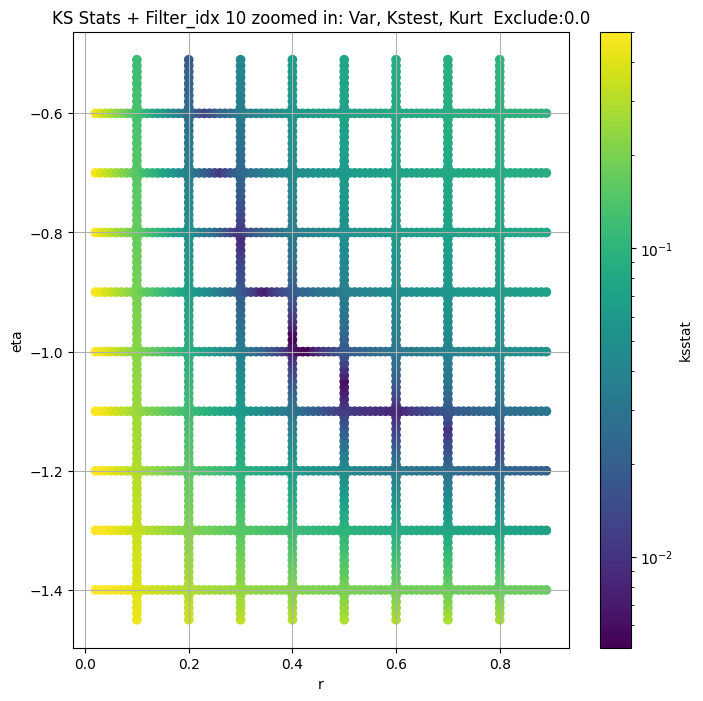

Filter_idx 11


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 11, 50.0 + 100 = 150, ksstat: 0.011132856550546022, var: 2.050874460737098


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 11, 50.0 + 75 = 125, ksstat: 0.01082557257603356, var: 2.0976943672198765


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 11, 50.0 + 50 = 100, ksstat: 0.011497774748709236, var: 2.1496103011612533


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 11, 50.0 + 25 = 75, ksstat: 0.010706104362399216, var: 2.2084512572482917


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 11, 50.0 + 0 = 50, ksstat: 0.010542061522622714, var: 2.2776301718627687


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 11, 50.0 + -25 = 25, ksstat: 0.010199821655227148, var: 2.365467397137108


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 11, 50.0 + -50 = 0, ksstat: 0.010513798233918847, var: 2.6180513327338337
Number of samples: 100000, Without approximation : 196608000.0


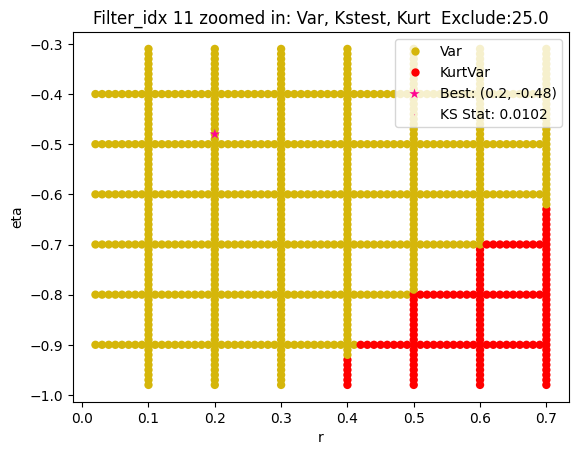

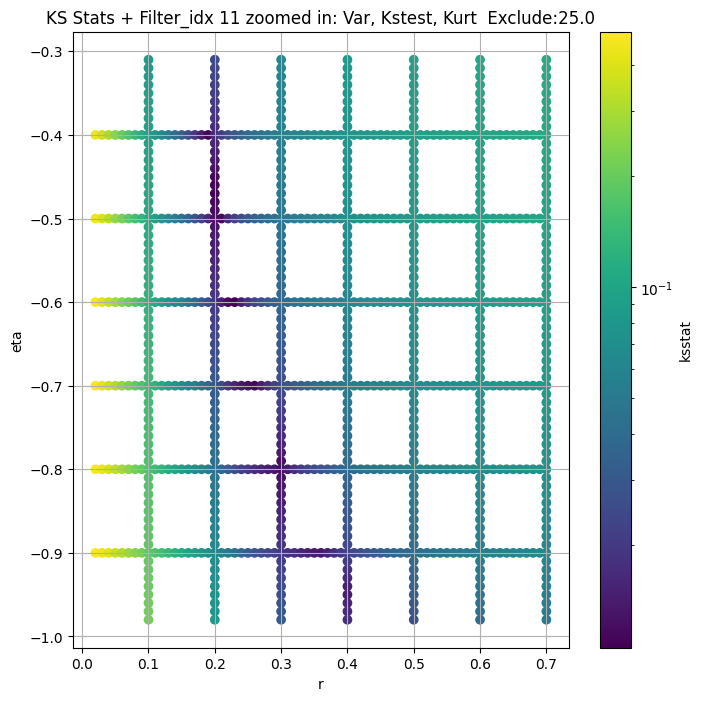

Filter_idx 12


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 12, 50.0 + 100 = 150, ksstat: 0.013658327001911219, var: 2.1026255084559513


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 12, 50.0 + 75 = 125, ksstat: 0.013450756217276705, var: 2.151564839799396


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 12, 50.0 + 50 = 100, ksstat: 0.013410566872031904, var: 2.206240945078547


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 12, 50.0 + 25 = 75, ksstat: 0.013303671822772756, var: 2.2688526652737857


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 12, 50.0 + 0 = 50, ksstat: 0.013320025842754213, var: 2.3434489126074722


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 12, 50.0 + -25 = 25, ksstat: 0.013317850113494178, var: 2.439915902225159


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 12, 50.0 + -50 = 0, ksstat: 0.013417322299258072, var: 2.6971958642966394
Number of samples: 100000, Without approximation : 196608000.0


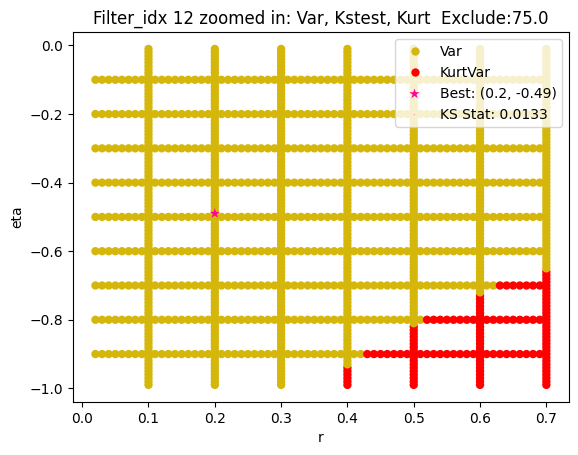

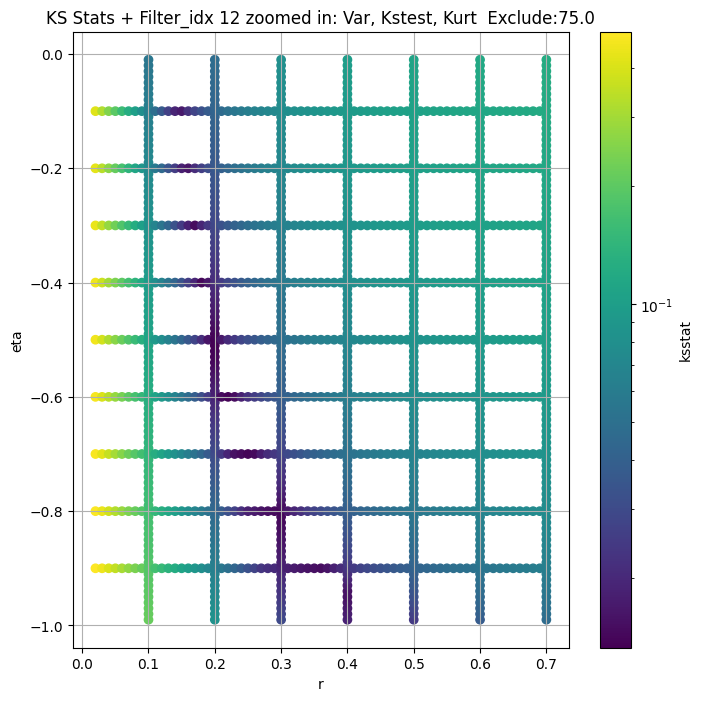

Filter_idx 13


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 13, 0.0 + 100 = 100, ksstat: 0.009555362960810998, var: 3.2569229287372927


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 13, 0.0 + 75 = 75, ksstat: 0.009601189155095502, var: 3.336422528609336


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 13, 0.0 + 50 = 50, ksstat: 0.00939427334540277, var: 3.4293016558394


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 13, 0.0 + 25 = 25, ksstat: 0.009167849303774234, var: 3.5455828486028644


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 13, 0.0 + 0 = 0, ksstat: 0.008787817545728882, var: 3.838628539685919
Number of samples: 100000, Without approximation : 196608000.0


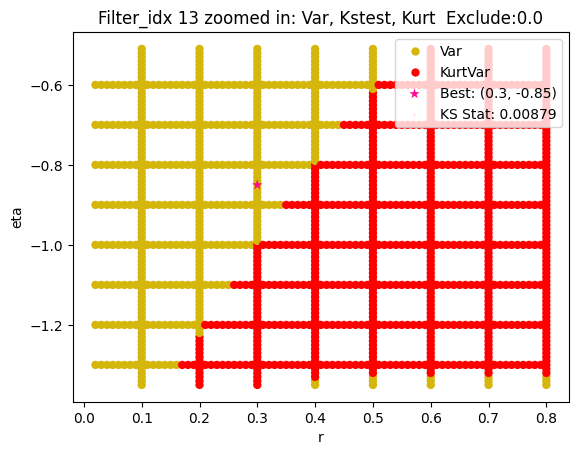

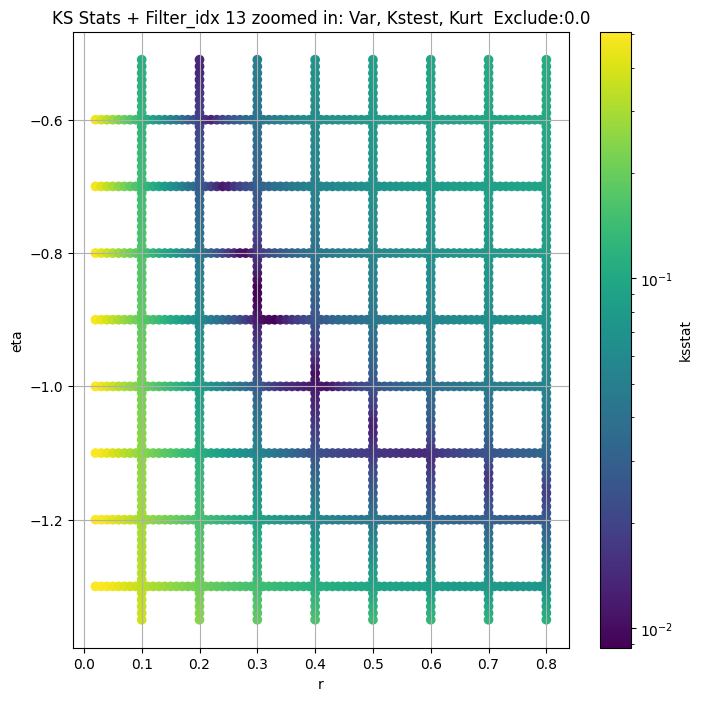

Filter_idx 14


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 14, 50.0 + 100 = 150, ksstat: 0.008086927562405928, var: 3.4329680815777355


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 14, 50.0 + 75 = 125, ksstat: 0.00789527491717601, var: 3.502842785754302


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 14, 50.0 + 50 = 100, ksstat: 0.007431920665153524, var: 3.57979082980569


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 14, 50.0 + 25 = 75, ksstat: 0.007491888700785765, var: 3.6661953124501085


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 14, 50.0 + 0 = 50, ksstat: 0.007561053842026322, var: 3.7665758382955703


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 14, 50.0 + -25 = 25, ksstat: 0.007550462887184195, var: 3.8912299222588427


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 14, 50.0 + -50 = 0, ksstat: 0.007096414664188533, var: 4.181247032003472
Number of samples: 100000, Without approximation : 196608000.0


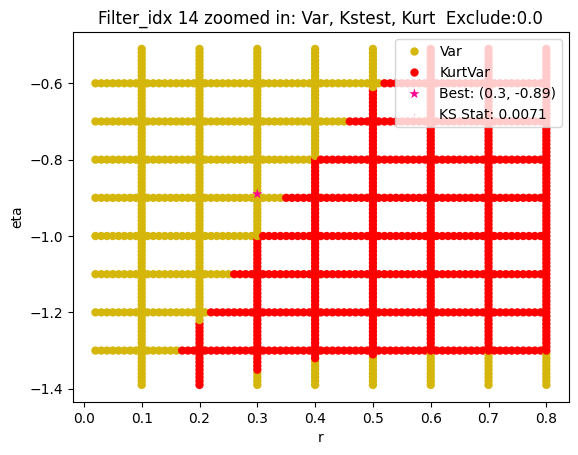

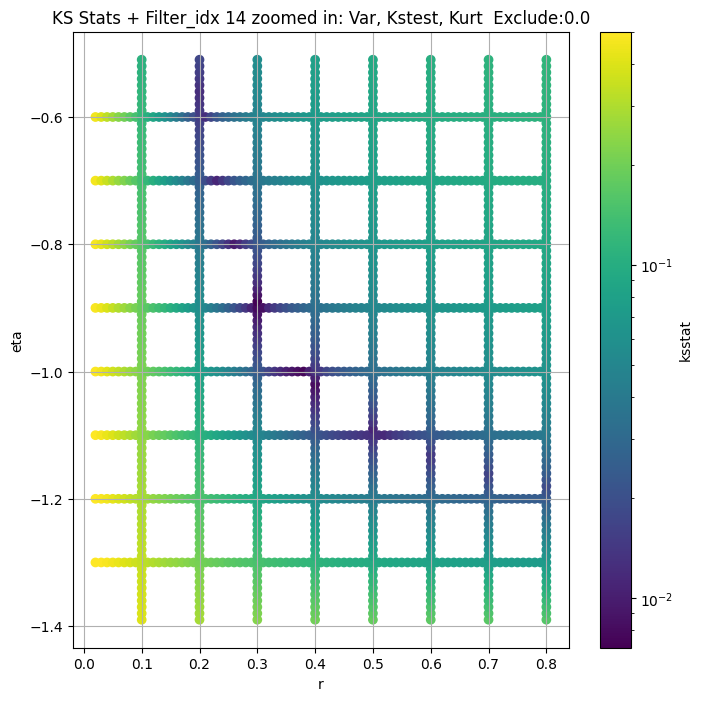

Filter_idx 15


  0%|          | 0/87 [00:00<?, ?it/s]

Finding Minimum after computing 87 CDFs
filter_idx 15, 200.0 + 100 = 300, ksstat: 0.023237779743566944, var: 5.022441242786294


  0%|          | 0/87 [00:00<?, ?it/s]

Finding Minimum after computing 87 CDFs
filter_idx 15, 200.0 + 75 = 275, ksstat: 0.023238035515996736, var: 5.048245473148218


  0%|          | 0/87 [00:00<?, ?it/s]

Finding Minimum after computing 87 CDFs
filter_idx 15, 200.0 + 50 = 250, ksstat: 0.023238037457753047, var: 5.075021181542733


  0%|          | 0/87 [00:00<?, ?it/s]

Finding Minimum after computing 87 CDFs
filter_idx 15, 200.0 + 25 = 225, ksstat: 0.023240594716177454, var: 5.102889319512372


  0%|          | 0/87 [00:00<?, ?it/s]

Finding Minimum after computing 87 CDFs
filter_idx 15, 200.0 + 0 = 200, ksstat: 0.02323742259726086, var: 5.132016497091577


  0%|          | 0/87 [00:00<?, ?it/s]

Finding Minimum after computing 87 CDFs
filter_idx 15, 200.0 + -25 = 175, ksstat: 0.023240304505883436, var: 5.162587754997422


  0%|          | 0/87 [00:00<?, ?it/s]

Finding Minimum after computing 87 CDFs
filter_idx 15, 200.0 + -50 = 150, ksstat: 0.023244989535796567, var: 5.19485817534566


  0%|          | 0/87 [00:00<?, ?it/s]

Finding Minimum after computing 87 CDFs
filter_idx 15, 200.0 + -75 = 125, ksstat: 0.023245134558290026, var: 5.229162761458271


  0%|          | 0/87 [00:00<?, ?it/s]

Finding Minimum after computing 87 CDFs
filter_idx 15, 200.0 + -100 = 100, ksstat: 0.023250533232913262, var: 5.266057426154343
Number of samples: 100000, Without approximation : 196608000.0


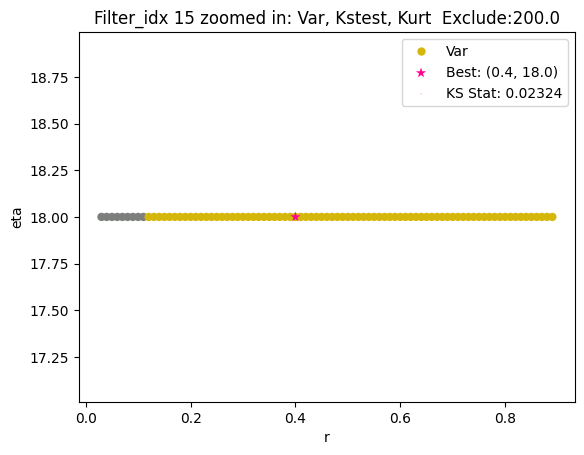

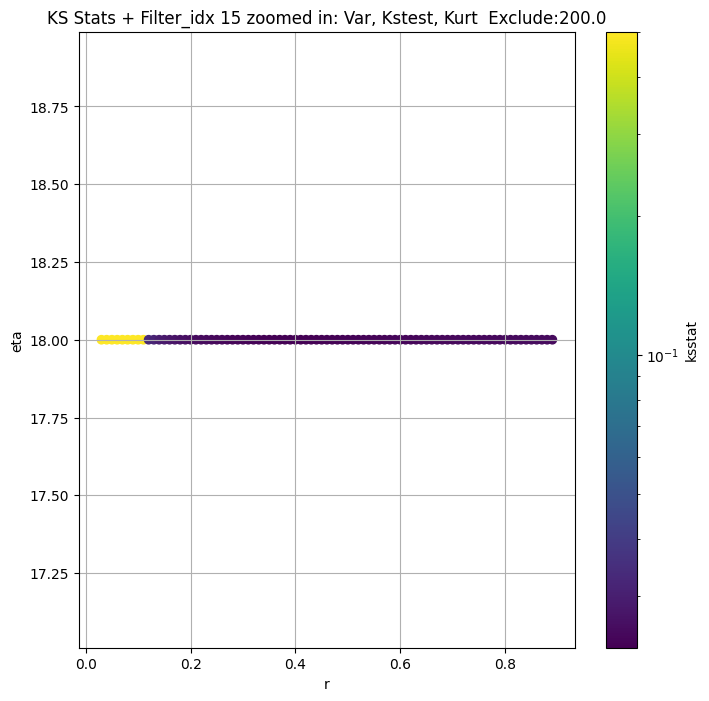

Filter_idx 16


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 16, 0.0 + 100 = 100, ksstat: 0.011739544818161862, var: 2.9954752459244163


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 16, 0.0 + 75 = 75, ksstat: 0.011854846839649102, var: 3.0729557777064276


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 16, 0.0 + 50 = 50, ksstat: 0.011396997491448957, var: 3.1648502881488136


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 16, 0.0 + 25 = 25, ksstat: 0.011594078171433542, var: 3.283093237994499


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 16, 0.0 + 0 = 0, ksstat: 0.011328195237075733, var: 3.5985721945619096
Number of samples: 100000, Without approximation : 196608000.0


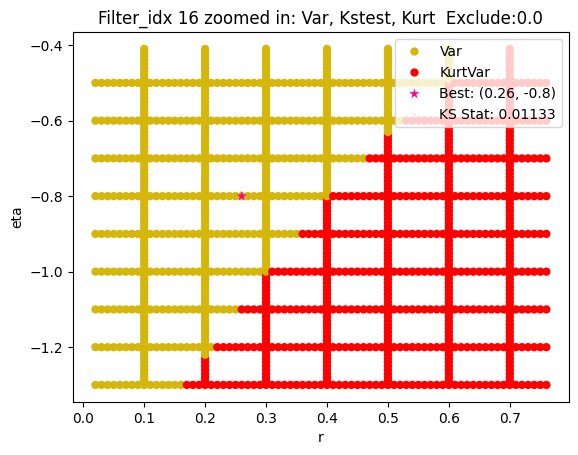

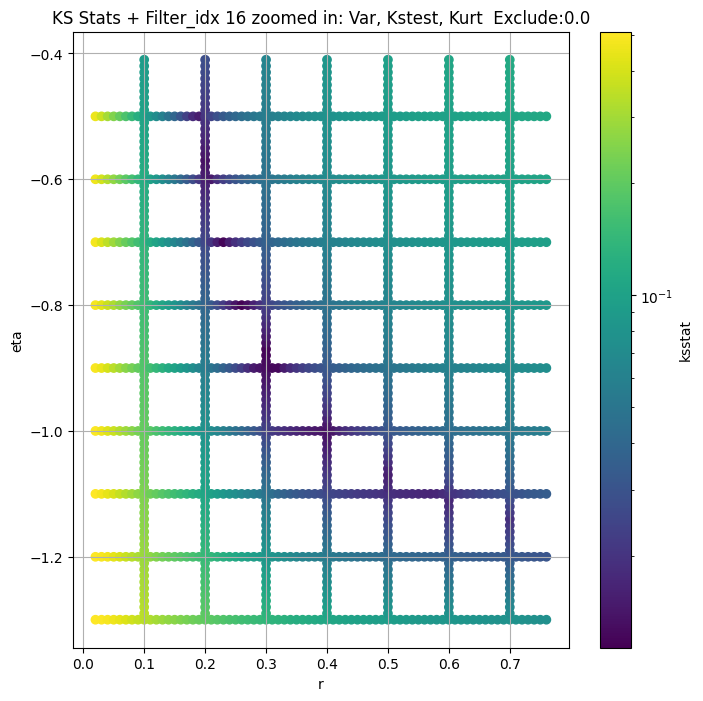

Filter_idx 17


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 17, 0.0 + 100 = 100, ksstat: 0.018943791528082704, var: 4.749873242732722


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 17, 0.0 + 75 = 75, ksstat: 0.018264310442629036, var: 4.847305636180744


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 17, 0.0 + 50 = 50, ksstat: 0.018020086204076538, var: 4.95709786412702


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 17, 0.0 + 25 = 25, ksstat: 0.01771234704063407, var: 5.088053985140163


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 17, 0.0 + 0 = 0, ksstat: 0.018005861906648435, var: 5.323275559639544
Number of samples: 100000, Without approximation : 196608000.0


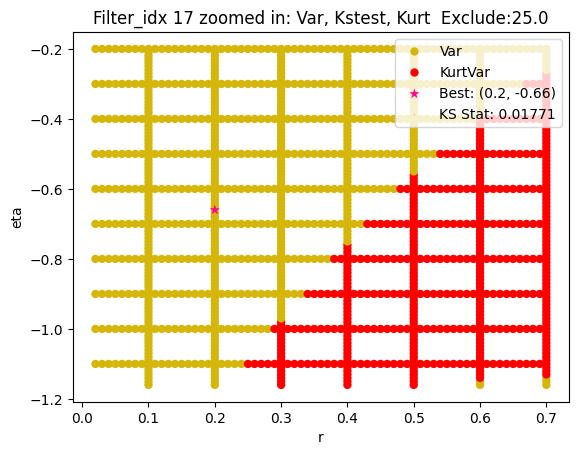

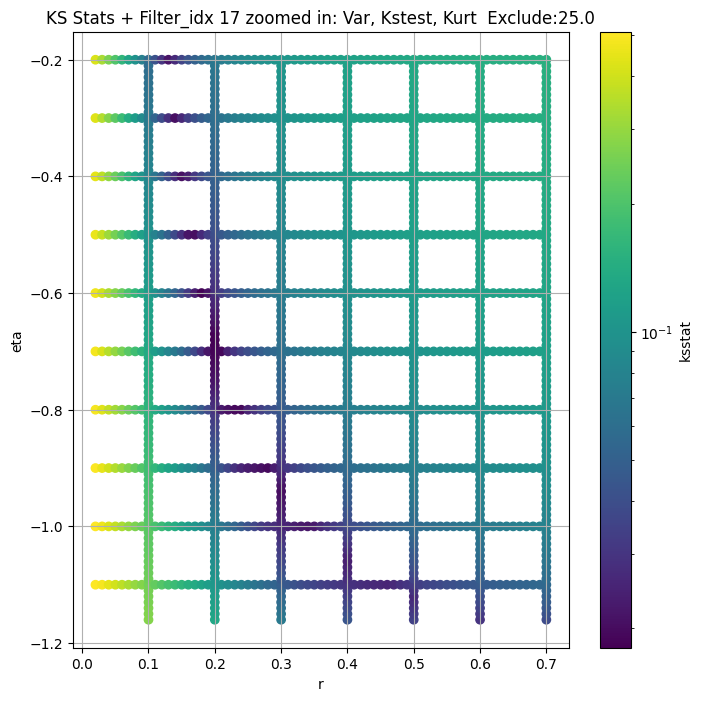

Filter_idx 18


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 18, 50.0 + 100 = 150, ksstat: 0.007252284595878011, var: 2.1047016653126027


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 18, 50.0 + 75 = 125, ksstat: 0.007077208041821104, var: 2.1561517905873857


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 18, 50.0 + 50 = 100, ksstat: 0.007115687750300803, var: 2.21392178636609


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 18, 50.0 + 25 = 75, ksstat: 0.007036142940399781, var: 2.2804441605563803


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 18, 50.0 + 0 = 50, ksstat: 0.0071919892304191935, var: 2.3604795235307856


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 18, 50.0 + -25 = 25, ksstat: 0.007186294908259561, var: 2.465700971207112


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 18, 50.0 + -50 = 0, ksstat: 0.006418423211610347, var: 2.7741612915174576
Number of samples: 100000, Without approximation : 196608000.0


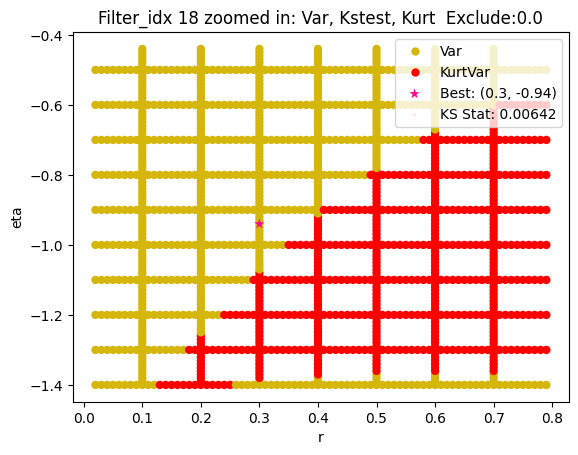

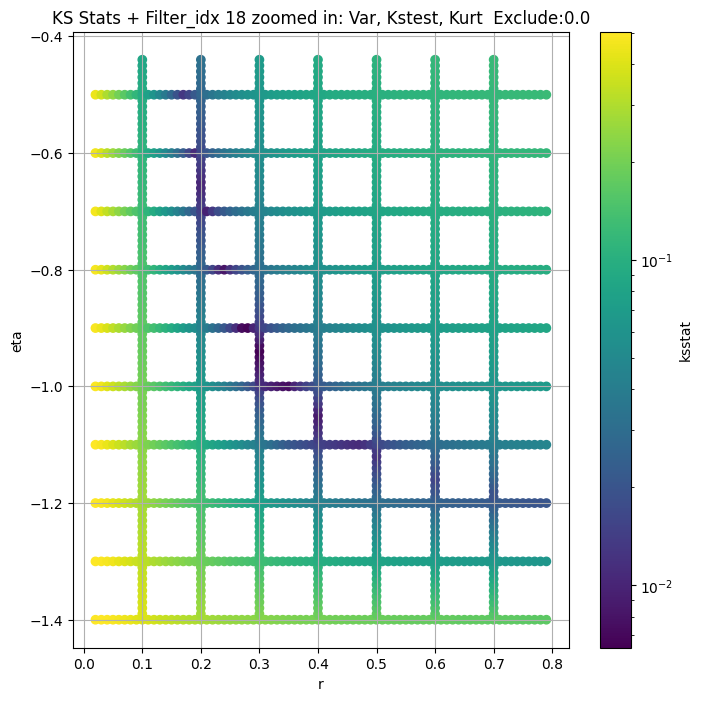

Filter_idx 19


  0%|          | 0/60 [00:00<?, ?it/s]

Finding Minimum after computing 60 CDFs
filter_idx 19, 0.0 + 100 = 100, ksstat: 0.012473075017184754, var: 8.295157986654898


  0%|          | 0/60 [00:00<?, ?it/s]

Finding Minimum after computing 60 CDFs
filter_idx 19, 0.0 + 75 = 75, ksstat: 0.01202154340089201, var: 8.35643121832826


  0%|          | 0/60 [00:00<?, ?it/s]

Finding Minimum after computing 60 CDFs
filter_idx 19, 0.0 + 50 = 50, ksstat: 0.011267778379270843, var: 8.425055709559455


  0%|          | 0/60 [00:00<?, ?it/s]

Finding Minimum after computing 60 CDFs
filter_idx 19, 0.0 + 25 = 25, ksstat: 0.010391474484647834, var: 8.505453125953073


  0%|          | 0/60 [00:00<?, ?it/s]

Finding Minimum after computing 60 CDFs
filter_idx 19, 0.0 + 0 = 0, ksstat: 0.009119550713769353, var: 8.659423679035976
Number of samples: 100000, Without approximation : 196608000.0


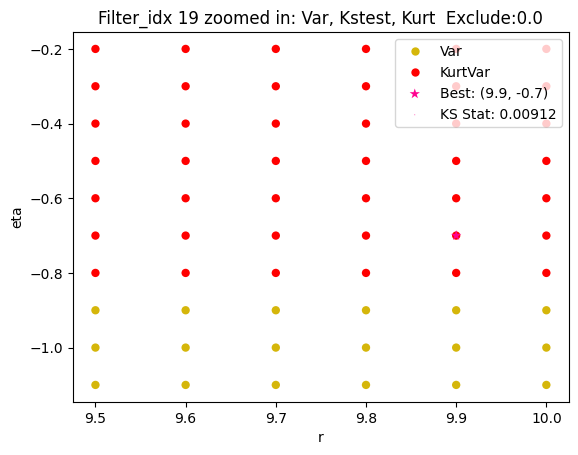

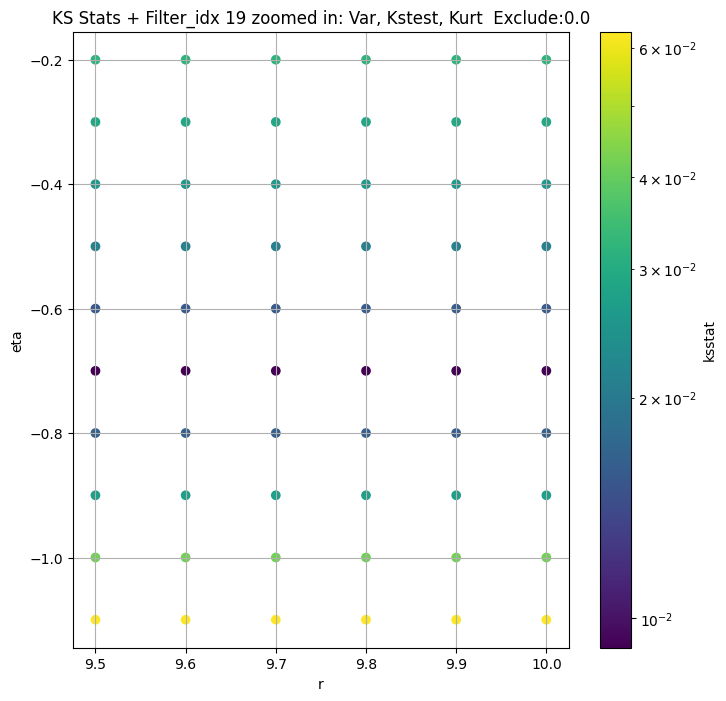

Filter_idx 20


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 20, 0.0 + 100 = 100, ksstat: 0.005969794196988509, var: 5.408907342083898


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 20, 0.0 + 75 = 75, ksstat: 0.005817843685283708, var: 5.538118345394333


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 20, 0.0 + 50 = 50, ksstat: 0.005492491637391961, var: 5.686483624701109


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 20, 0.0 + 25 = 25, ksstat: 0.00564240255155668, var: 5.866624024687421


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 20, 0.0 + 0 = 0, ksstat: 0.005473180968228297, var: 6.255223206781173
Number of samples: 100000, Without approximation : 196608000.0


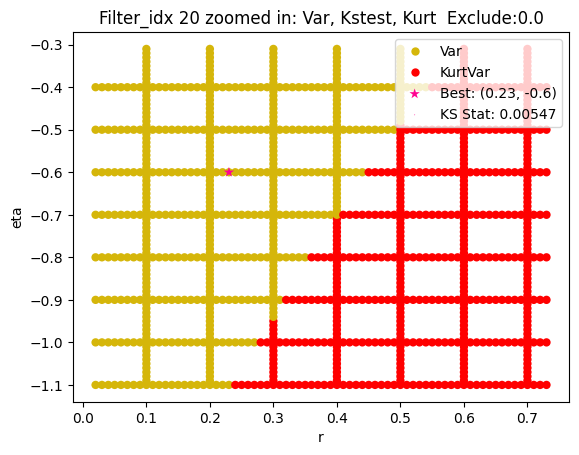

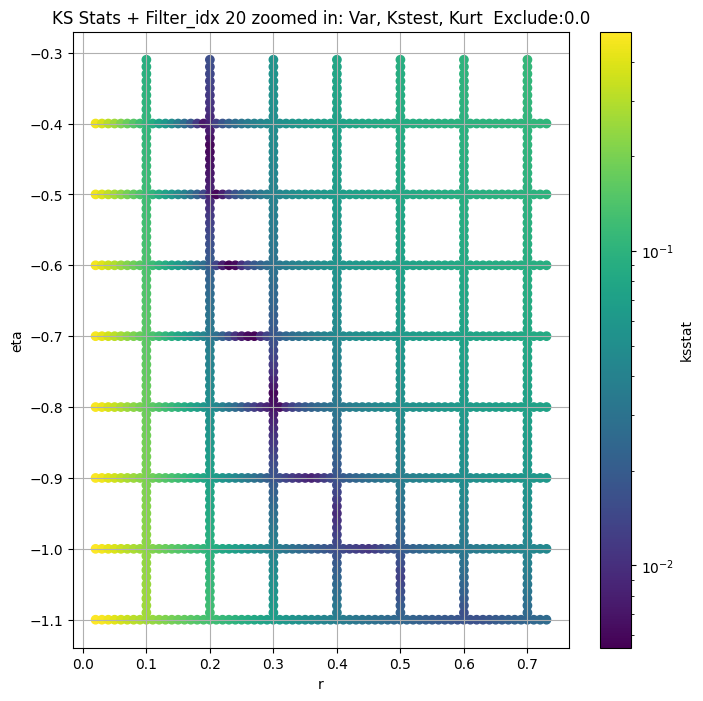

Filter_idx 21


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 21, 0.0 + 100 = 100, ksstat: 0.025052564341067174, var: 15.737610274559708


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 21, 0.0 + 75 = 75, ksstat: 0.02484202051069162, var: 15.865806435845679


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 21, 0.0 + 50 = 50, ksstat: 0.02456214847045446, var: 16.010718766270852


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 21, 0.0 + 25 = 25, ksstat: 0.024154499202132196, var: 16.183148321826874


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 21, 0.0 + 0 = 0, ksstat: 0.0234160452032367, var: 16.531827341102726
Number of samples: 100000, Without approximation : 196608000.0


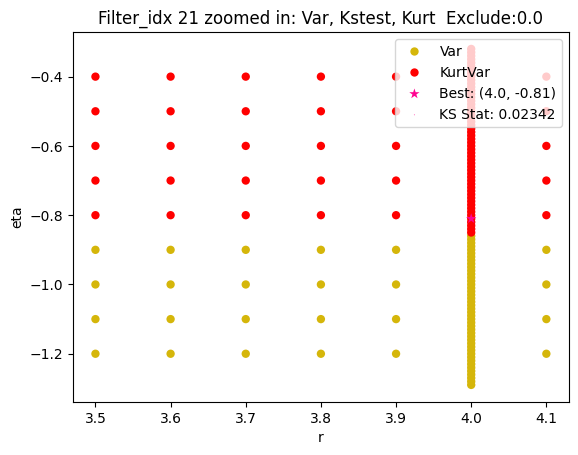

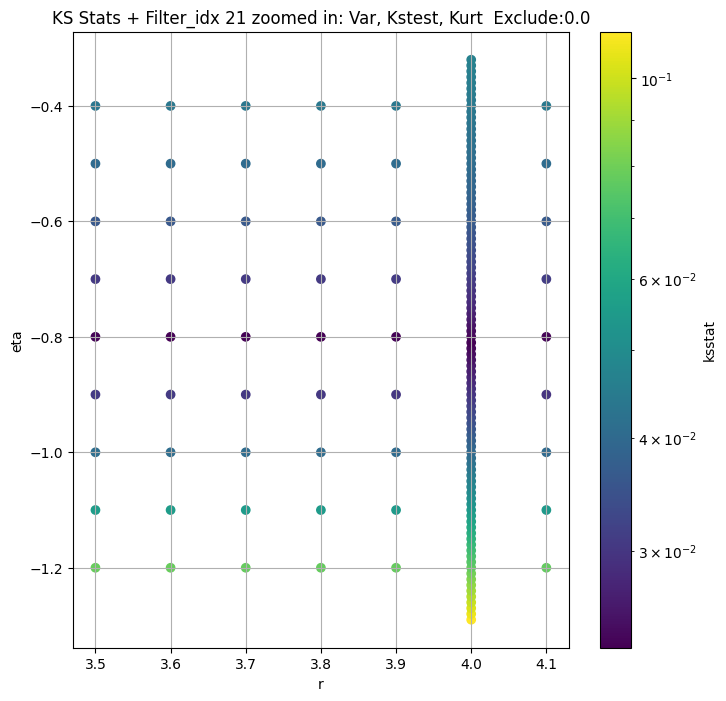

Filter_idx 22


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 50.0 + 100 = 150, ksstat: 0.008571482301725997, var: 3.23885735748414


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 50.0 + 75 = 125, ksstat: 0.00837867919233301, var: 3.306152471049232


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 50.0 + 50 = 100, ksstat: 0.008251516241392698, var: 3.380650767686097


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 50.0 + 25 = 75, ksstat: 0.007686766206748241, var: 3.4649465119580314


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 50.0 + 0 = 50, ksstat: 0.0068599602031992335, var: 3.563897373494704


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 50.0 + -25 = 25, ksstat: 0.0070502451212614, var: 3.6889437620421694


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 22, 50.0 + -50 = 0, ksstat: 0.007035823710777378, var: 3.9729341732160117
Number of samples: 100000, Without approximation : 196608000.0


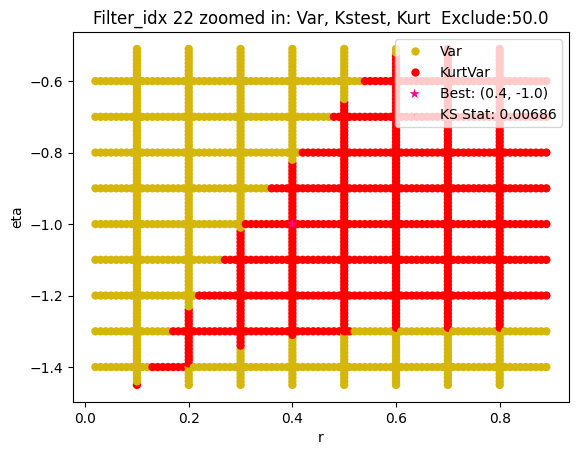

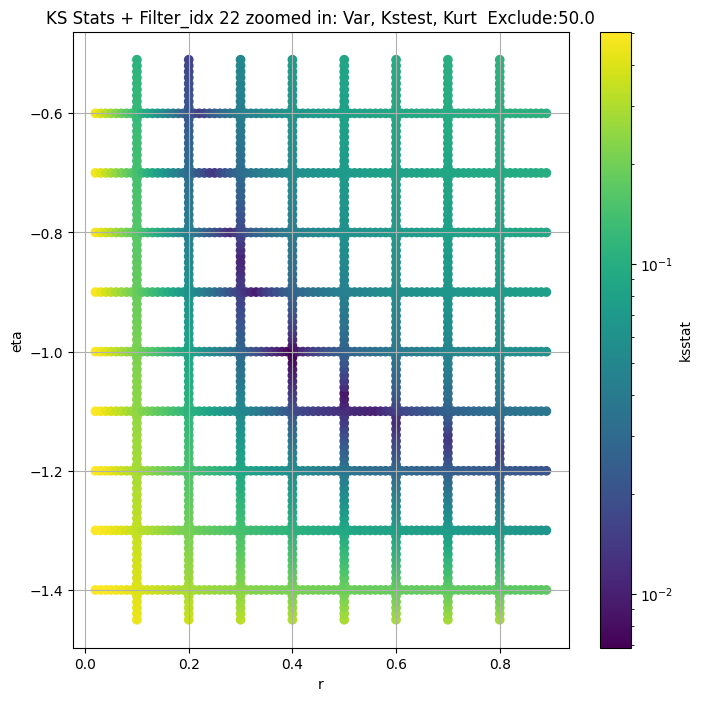

Filter_idx 23


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 100 = 100, ksstat: 0.007804085037407829, var: 2.681832006695198


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 75 = 75, ksstat: 0.007530368957274235, var: 2.7462391342060974


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 50 = 50, ksstat: 0.007399770134423889, var: 2.8211467018748957


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 25 = 25, ksstat: 0.007237422295636453, var: 2.914488340257413


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 0 = 0, ksstat: 0.007147917824195285, var: 3.1141481428458326
Number of samples: 100000, Without approximation : 196608000.0


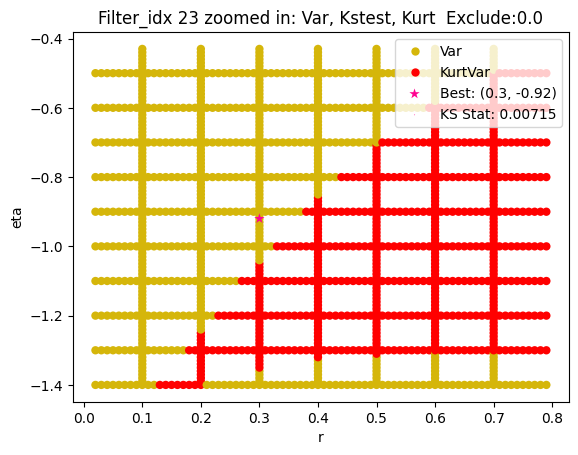

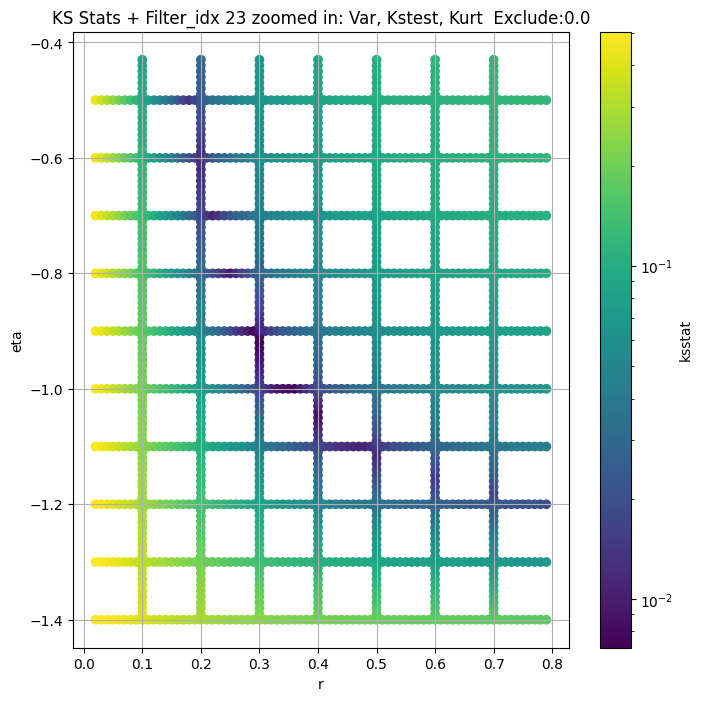

Filter_idx 24


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 100 = 100, ksstat: 0.013571244220788092, var: 3.0073951373751906


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 75 = 75, ksstat: 0.013454978491239444, var: 3.09978806972137


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 50 = 50, ksstat: 0.013493478405941228, var: 3.208991300137925


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 25 = 25, ksstat: 0.013596117752847192, var: 3.3484405492195277


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 0 = 0, ksstat: 0.013568159012070258, var: 3.6855011889900675
Number of samples: 100000, Without approximation : 196608000.0


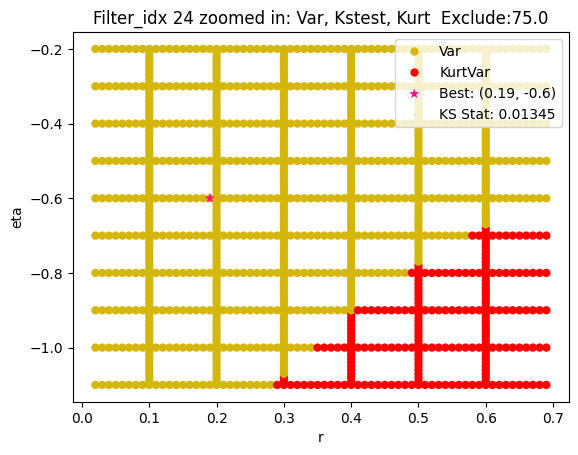

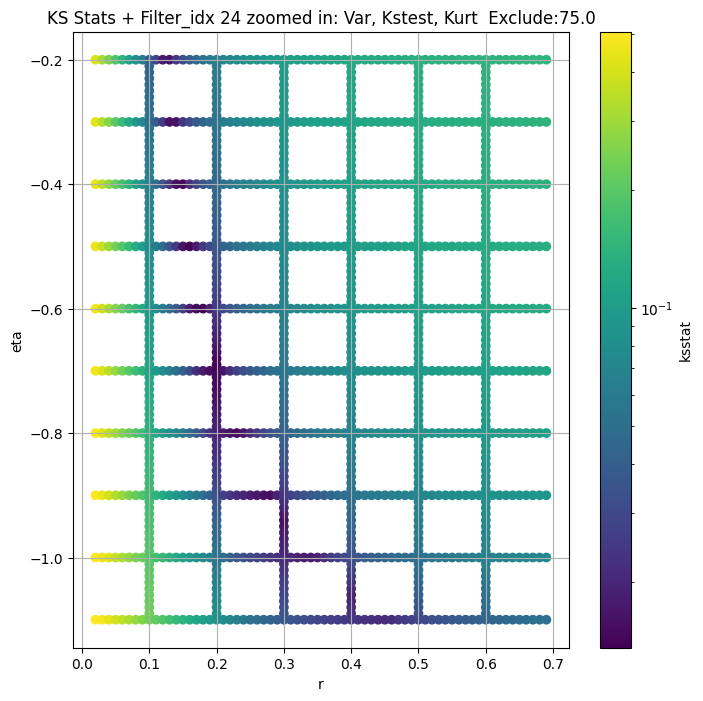

Filter_idx 25


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 0.0 + 100 = 100, ksstat: 0.00935884426698863, var: 3.8768522439391457


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 0.0 + 75 = 75, ksstat: 0.009651107156817718, var: 3.9818023947894248


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 0.0 + 50 = 50, ksstat: 0.009219361531517034, var: 4.105748624815793


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 0.0 + 25 = 25, ksstat: 0.009492616747001859, var: 4.263504047441031


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 0.0 + 0 = 0, ksstat: 0.010021885696845811, var: 4.6263123091597125
Number of samples: 100000, Without approximation : 196608000.0


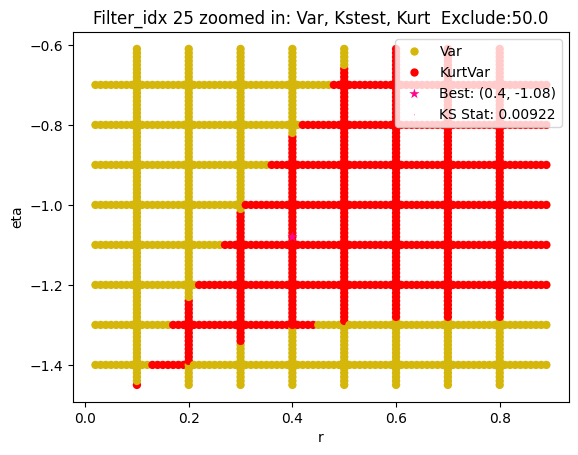

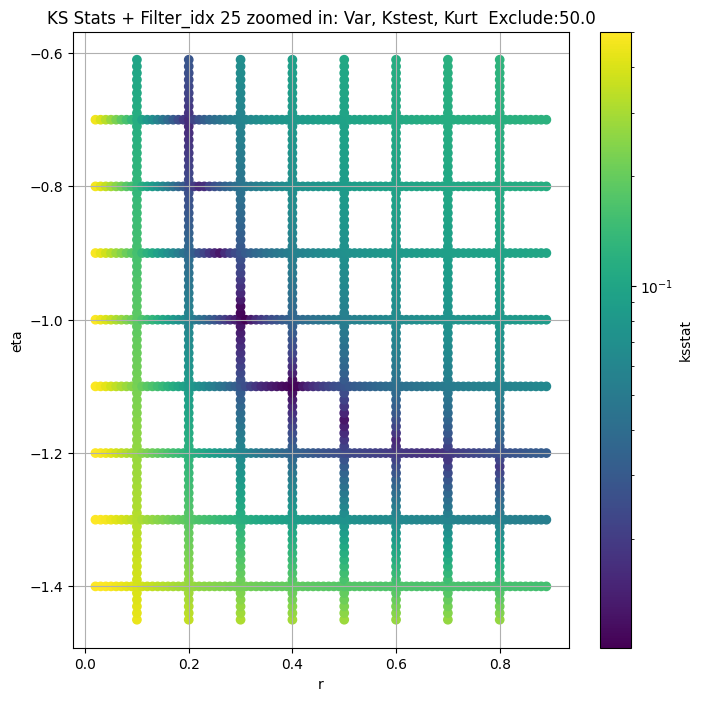

Filter_idx 26


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 26, 0.0 + 100 = 100, ksstat: 0.01107113575366167, var: 3.1649936247486585


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 26, 0.0 + 75 = 75, ksstat: 0.010698830985001795, var: 3.225592156200758


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 26, 0.0 + 50 = 50, ksstat: 0.011065526570960882, var: 3.2954477799671995


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 26, 0.0 + 25 = 25, ksstat: 0.010726432499846228, var: 3.3809759346431703


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 26, 0.0 + 0 = 0, ksstat: 0.01062062531276231, var: 3.5725534075762995
Number of samples: 100000, Without approximation : 196608000.0


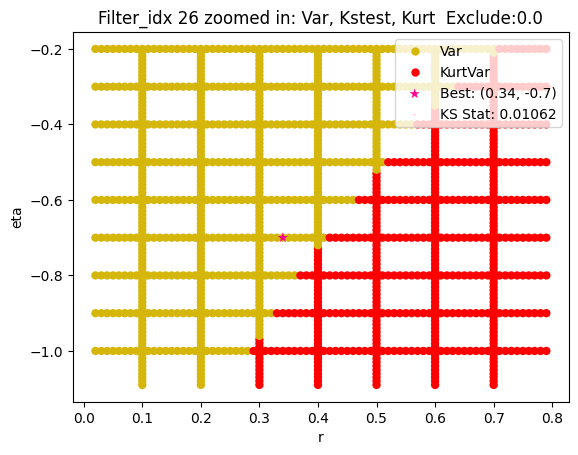

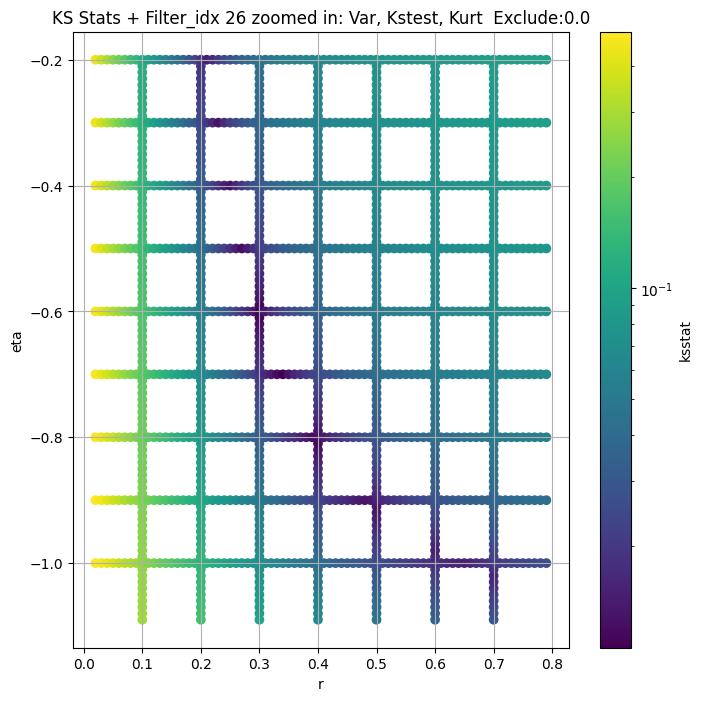

Filter_idx 27


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 100.0 + 100 = 200, ksstat: 0.012132573128650181, var: 2.3807910188974897


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 100.0 + 75 = 175, ksstat: 0.012163987307741264, var: 2.4323126050530908


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 100.0 + 50 = 150, ksstat: 0.011254171987832712, var: 2.488444436730499


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 100.0 + 25 = 125, ksstat: 0.011379015064147444, var: 2.5503307125021806


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 100.0 + 0 = 100, ksstat: 0.01105192712901093, var: 2.6197247038357725


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 100.0 + -25 = 75, ksstat: 0.011532960141153348, var: 2.6994683317253196


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 100.0 + -50 = 50, ksstat: 0.011175468282824008, var: 2.7950127260965356


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 100.0 + -75 = 25, ksstat: 0.011582458171205179, var: 2.919521478267683


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 100.0 + -100 = 0, ksstat: 0.009514845294677693, var: 3.248680336930291
Number of samples: 100000, Without approximation : 196608000.0


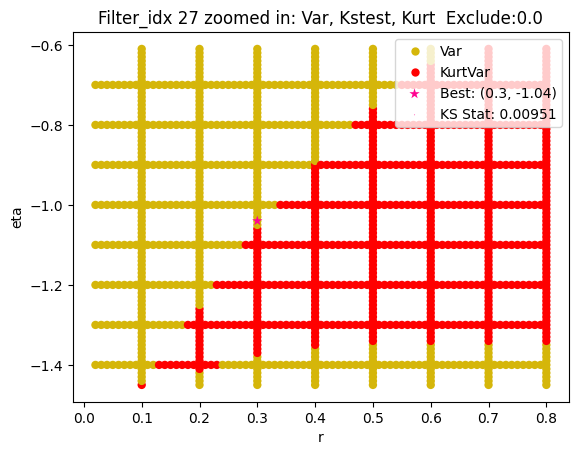

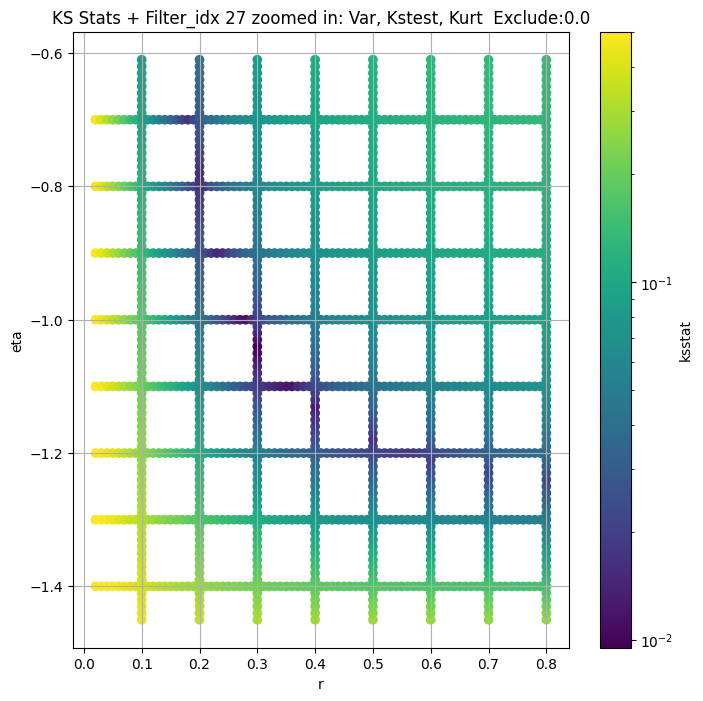

Filter_idx 28


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 28, 0.0 + 100 = 100, ksstat: 0.01023272295405836, var: 3.169636823853883


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 28, 0.0 + 75 = 75, ksstat: 0.01068038039276259, var: 3.2654876628685705


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 28, 0.0 + 50 = 50, ksstat: 0.01042099240130967, var: 3.378691503039166


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 28, 0.0 + 25 = 25, ksstat: 0.009818925836550085, var: 3.5233092145862215


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 28, 0.0 + 0 = 0, ksstat: 0.00941493513678926, var: 3.8401503764735256
Number of samples: 100000, Without approximation : 196608000.0


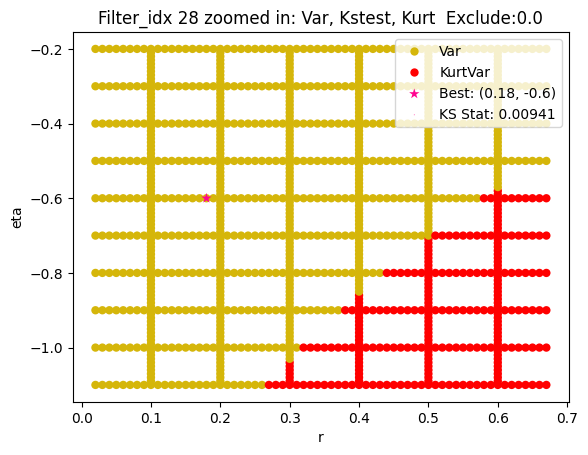

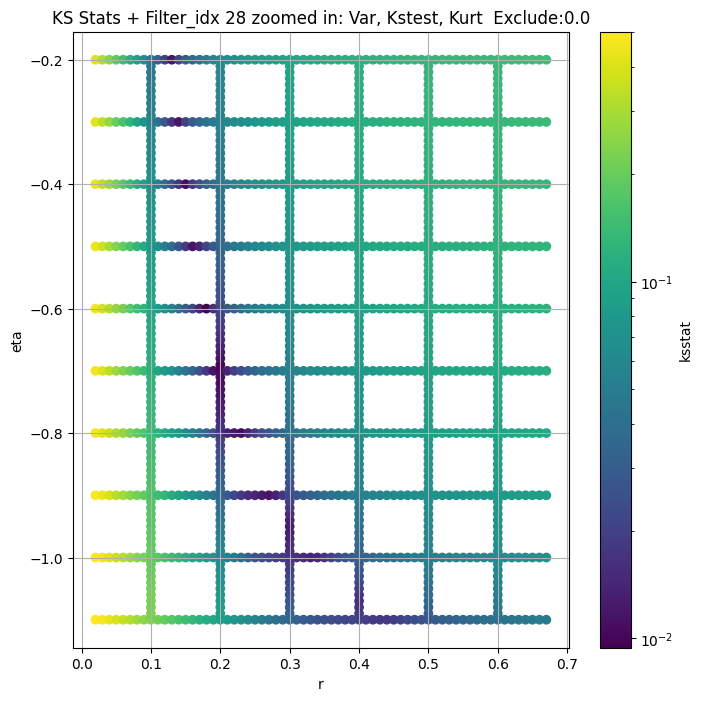

Filter_idx 29


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 29, 50.0 + 100 = 150, ksstat: 0.011782223471032194, var: 1.7573084407934378


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 29, 50.0 + 75 = 125, ksstat: 0.011812645421675469, var: 1.7971390509246157


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 29, 50.0 + 50 = 100, ksstat: 0.01113189597936326, var: 1.8411454484439715


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 29, 50.0 + 25 = 75, ksstat: 0.010979366179620392, var: 1.8908558532969857


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 29, 50.0 + 0 = 50, ksstat: 0.011004383428351333, var: 1.9489666178719744


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 29, 50.0 + -25 = 25, ksstat: 0.011095203338846282, var: 2.0216790180824447


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 29, 50.0 + -50 = 0, ksstat: 0.01164221737723492, var: 2.202851354356995
Number of samples: 100000, Without approximation : 196608000.0


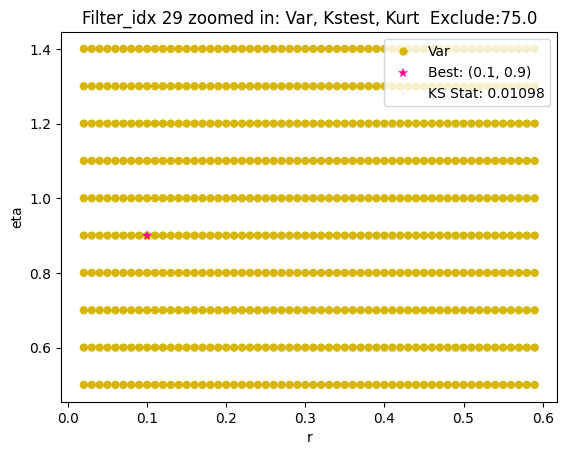

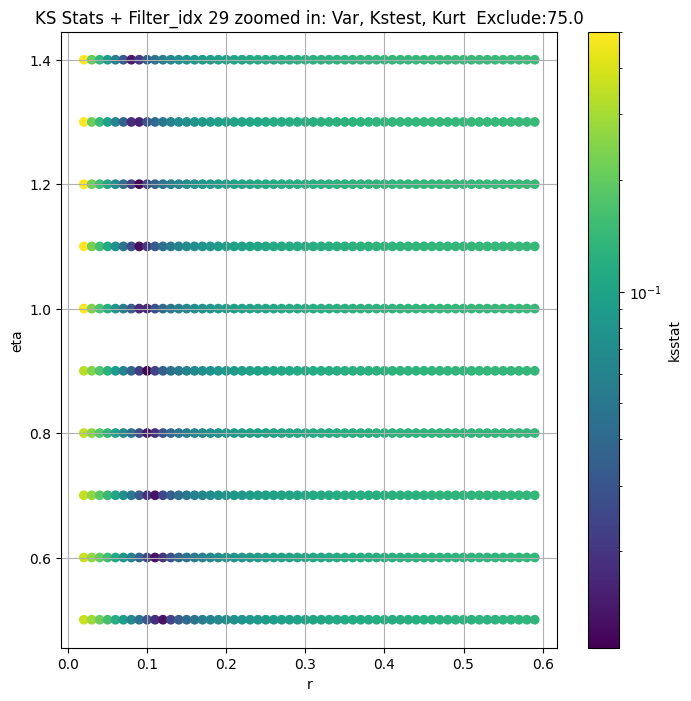

Filter_idx 30


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 30, 0.0 + 100 = 100, ksstat: 0.011645546130335638, var: 2.3975568423547786


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 30, 0.0 + 75 = 75, ksstat: 0.011895648686879756, var: 2.47324069668845


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 30, 0.0 + 50 = 50, ksstat: 0.011332196028751684, var: 2.5629712438928087


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 30, 0.0 + 25 = 25, ksstat: 0.011363947276310793, var: 2.6779471690510435


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 30, 0.0 + 0 = 0, ksstat: 0.011380552194301619, var: 2.9488841180113803
Number of samples: 100000, Without approximation : 196608000.0


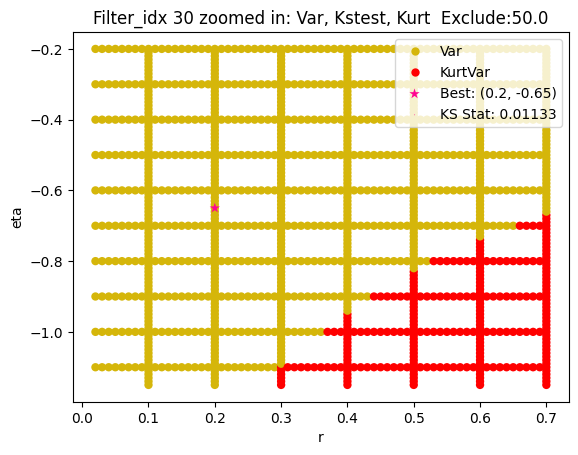

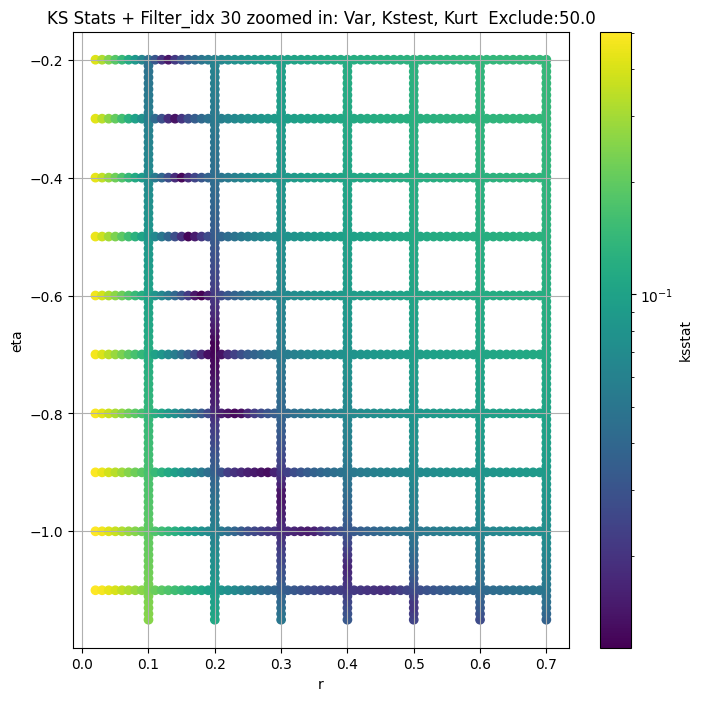

Filter_idx 31


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + 100 = 200, ksstat: 0.01644154814954603, var: 3.5607688315927075


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + 75 = 175, ksstat: 0.016316507703036165, var: 3.6008039382060315


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + 50 = 150, ksstat: 0.01583891467816434, var: 3.643171540386962


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + 25 = 125, ksstat: 0.015810811201166952, var: 3.6883448295236145


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + 0 = 100, ksstat: 0.01592398004605944, var: 3.737013929801641


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + -25 = 75, ksstat: 0.015856143245786103, var: 3.790312111208525


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + -50 = 50, ksstat: 0.01598698433390039, var: 3.850241133545314


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + -75 = 25, ksstat: 0.01585893977083863, var: 3.9214325929621467


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 100.0 + -100 = 0, ksstat: 0.016039589028731205, var: 4.099056218699054
Number of samples: 100000, Without approximation : 196608000.0


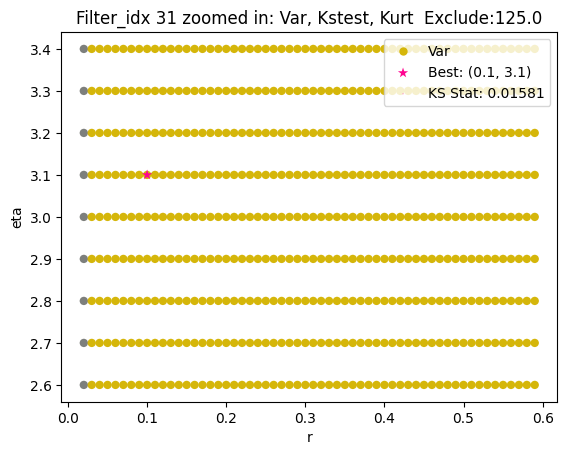

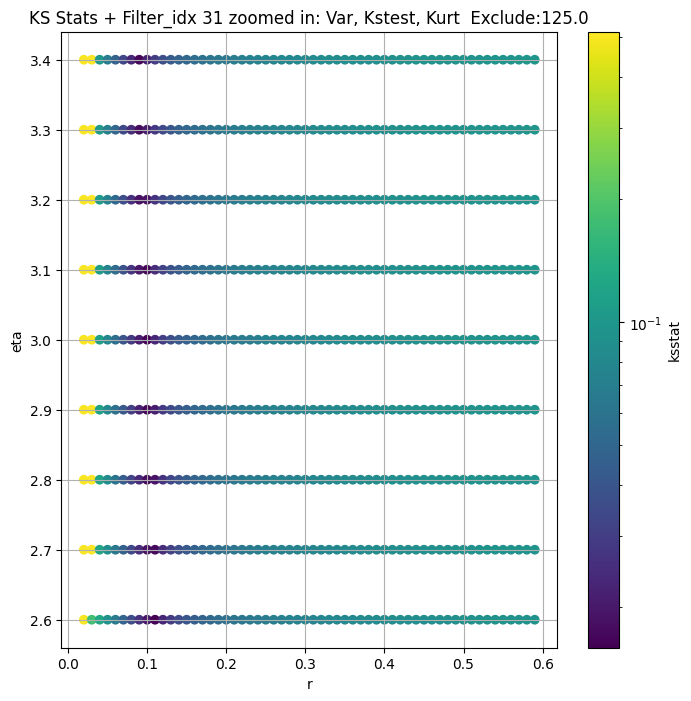

Filter_idx 32


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 50.0 + 100 = 150, ksstat: 0.0073550478998536395, var: 2.5202830444664204


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 50.0 + 75 = 125, ksstat: 0.006806705216582276, var: 2.5701896315269366


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 50.0 + 50 = 100, ksstat: 0.007364639071652523, var: 2.6251271036379906


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 50.0 + 25 = 75, ksstat: 0.007529112492545287, var: 2.686877269995692


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 50.0 + 0 = 50, ksstat: 0.007424997892699958, var: 2.7587746456035345


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 50.0 + -25 = 25, ksstat: 0.006566469534145636, var: 2.8482086565939495


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 32, 50.0 + -50 = 0, ksstat: 0.005379573158396933, var: 3.0903117888517677
Number of samples: 100000, Without approximation : 196608000.0


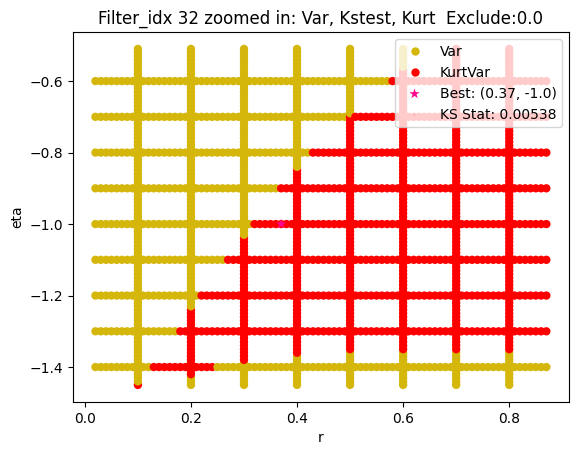

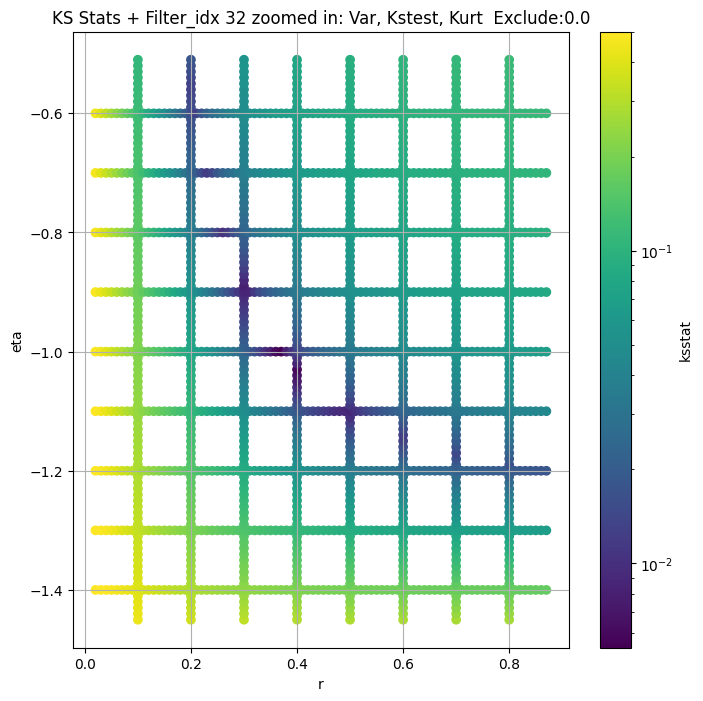

Filter_idx 33


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 100.0 + 100 = 200, ksstat: 0.00914784483739034, var: 1.9245957687166455


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 100.0 + 75 = 175, ksstat: 0.009121118081576451, var: 1.9647709385116137


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 100.0 + 50 = 150, ksstat: 0.008290597345478226, var: 2.0085508426152874


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 100.0 + 25 = 125, ksstat: 0.007815417347422818, var: 2.056814671179106


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 100.0 + 0 = 100, ksstat: 0.007676535514762106, var: 2.1109206816209234


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 100.0 + -25 = 75, ksstat: 0.008295369422473275, var: 2.173098169309386


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 100.0 + -50 = 50, ksstat: 0.007939811403610997, var: 2.2475751097106413


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 100.0 + -75 = 25, ksstat: 0.0069186141971315784, var: 2.3450395776760646


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 33, 100.0 + -100 = 0, ksstat: 0.00673846580036247, var: 2.6272934065461526
Number of samples: 100000, Without approximation : 196608000.0


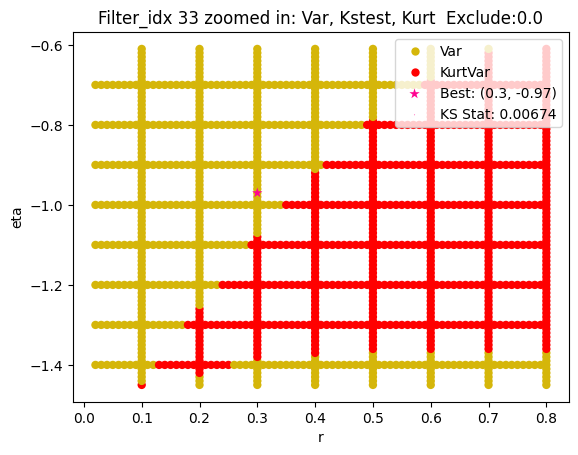

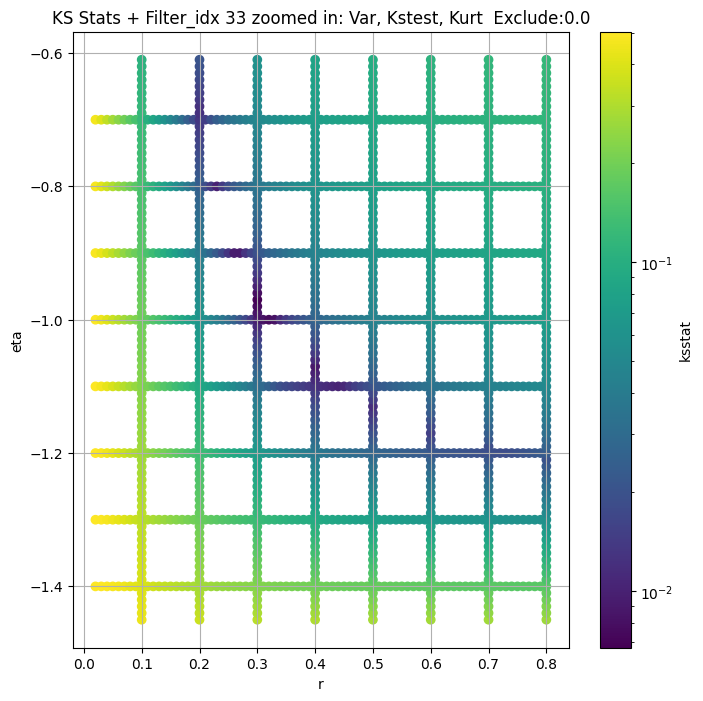

Filter_idx 34


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 34, 200.0 + 100 = 300, ksstat: 0.009971493536732767, var: 2.1299113421639073


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 34, 200.0 + 75 = 275, ksstat: 0.009885985914601436, var: 2.1696580339329166


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 34, 200.0 + 50 = 250, ksstat: 0.009799561962924086, var: 2.2117649613783974


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 34, 200.0 + 25 = 225, ksstat: 0.010059755863865982, var: 2.256554610074047


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 34, 200.0 + 0 = 200, ksstat: 0.009961442024997602, var: 2.304455125758043


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 34, 200.0 + -25 = 175, ksstat: 0.009304552865048943, var: 2.355988656755058


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 34, 200.0 + -50 = 150, ksstat: 0.008980001886871092, var: 2.4119037343168945


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 34, 200.0 + -75 = 125, ksstat: 0.008981812387507226, var: 2.4731784849562373


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 34, 200.0 + -100 = 100, ksstat: 0.008968944304124205, var: 2.5413172523653977
Number of samples: 100000, Without approximation : 196608000.0


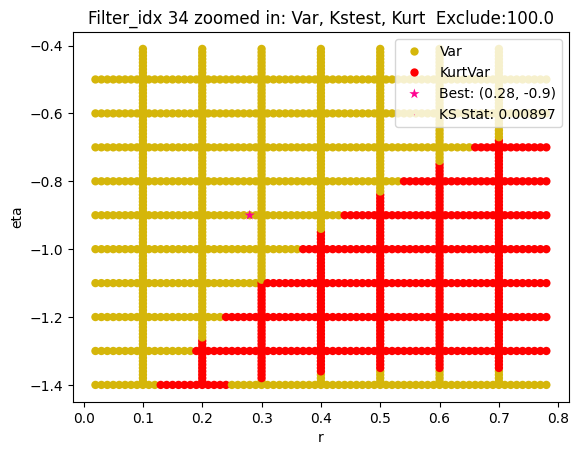

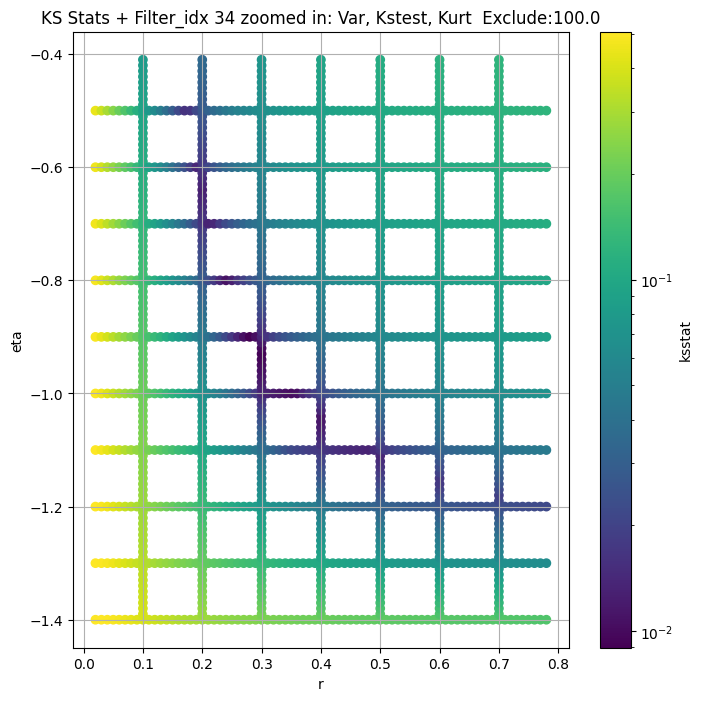

Filter_idx 35


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 35, 0.0 + 100 = 100, ksstat: 0.018638400204217864, var: 12.93278344201746


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 35, 0.0 + 75 = 75, ksstat: 0.01829213705188304, var: 13.03976854319043


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 35, 0.0 + 50 = 50, ksstat: 0.018466131155415177, var: 13.15835036533223


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 35, 0.0 + 25 = 25, ksstat: 0.018186742084513763, var: 13.297518159262694


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 35, 0.0 + 0 = 0, ksstat: 0.018114021955529358, var: 13.555761693055832
Number of samples: 100000, Without approximation : 196608000.0


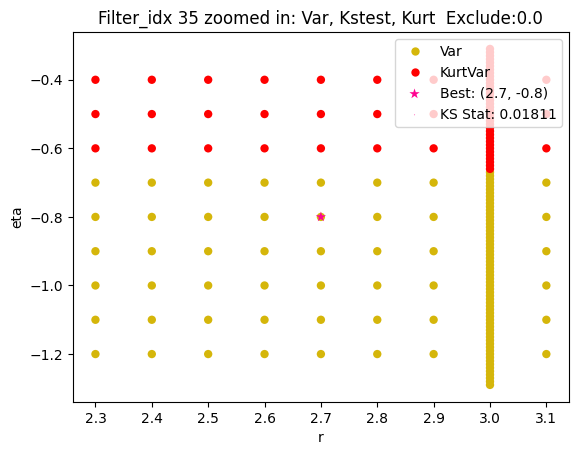

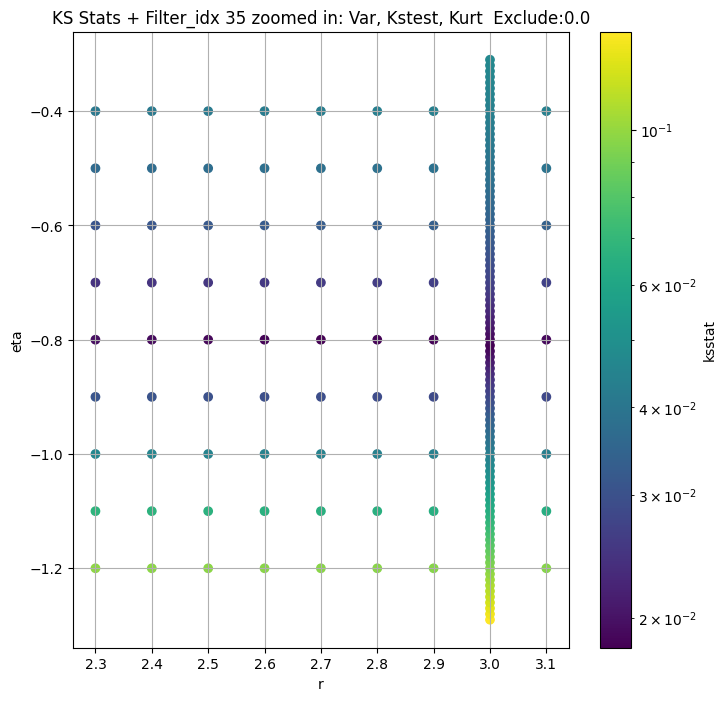

Filter_idx 36


  0%|          | 0/63 [00:00<?, ?it/s]

Finding Minimum after computing 63 CDFs
filter_idx 36, 100.0 + 100 = 200, ksstat: 0.02290839542199119, var: 6.571259135600178


  0%|          | 0/63 [00:00<?, ?it/s]

Finding Minimum after computing 63 CDFs
filter_idx 36, 100.0 + 75 = 175, ksstat: 0.022856568257501653, var: 6.608903797124151


  0%|          | 0/63 [00:00<?, ?it/s]

Finding Minimum after computing 63 CDFs
filter_idx 36, 100.0 + 50 = 150, ksstat: 0.022810195490281182, var: 6.648660091884525


  0%|          | 0/63 [00:00<?, ?it/s]

Finding Minimum after computing 63 CDFs
filter_idx 36, 100.0 + 25 = 125, ksstat: 0.022779014034004563, var: 6.691012940798944


  0%|          | 0/63 [00:00<?, ?it/s]

Finding Minimum after computing 63 CDFs
filter_idx 36, 100.0 + 0 = 100, ksstat: 0.022768005793349866, var: 6.736651758274691


  0%|          | 0/63 [00:00<?, ?it/s]

Finding Minimum after computing 63 CDFs
filter_idx 36, 100.0 + -25 = 75, ksstat: 0.023292387855337937, var: 6.786450237545292


  0%|          | 0/63 [00:00<?, ?it/s]

Finding Minimum after computing 63 CDFs
filter_idx 36, 100.0 + -50 = 50, ksstat: 0.023947029691068322, var: 6.842308551543519


  0%|          | 0/63 [00:00<?, ?it/s]

Finding Minimum after computing 63 CDFs
filter_idx 36, 100.0 + -75 = 25, ksstat: 0.024772425649492114, var: 6.90806947853942


  0%|          | 0/63 [00:00<?, ?it/s]

Finding Minimum after computing 63 CDFs
filter_idx 36, 100.0 + -100 = 0, ksstat: 0.026592631751984952, var: 7.045793526304776
Number of samples: 100000, Without approximation : 196608000.0


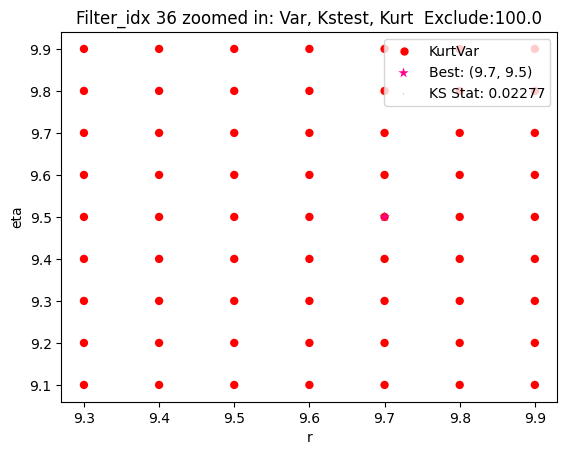

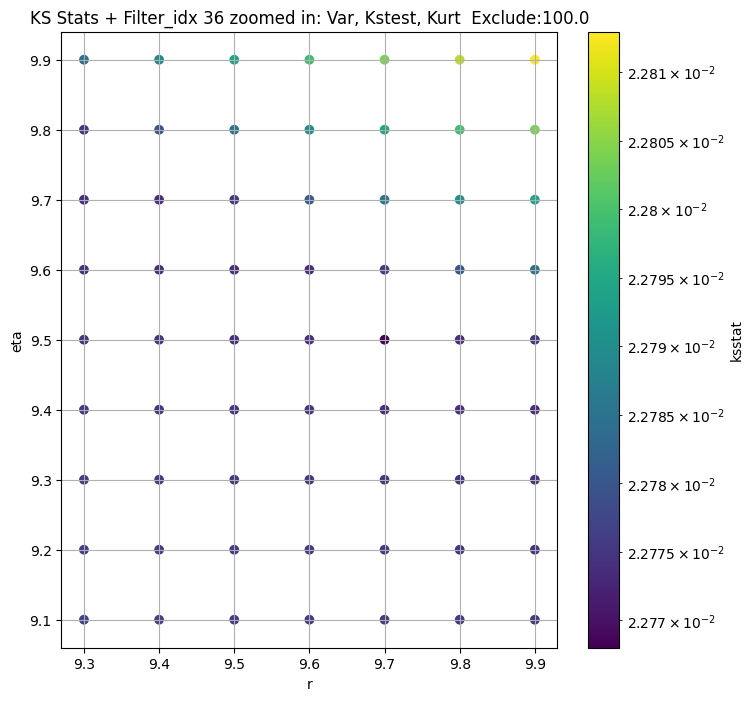

Filter_idx 37


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 37, 0.0 + 100 = 100, ksstat: 0.02263257481193859, var: 14.253317597731234


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 37, 0.0 + 75 = 75, ksstat: 0.02238478854283918, var: 14.37801433311184


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 37, 0.0 + 50 = 50, ksstat: 0.02206139873206514, var: 14.519133372110339


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 37, 0.0 + 25 = 25, ksstat: 0.02159725542597038, var: 14.68803861619732


  0%|          | 0/171 [00:00<?, ?it/s]

Finding Minimum after computing 171 CDFs
filter_idx 37, 0.0 + 0 = 0, ksstat: 0.02073474165164202, var: 15.03236829916976
Number of samples: 100000, Without approximation : 196608000.0


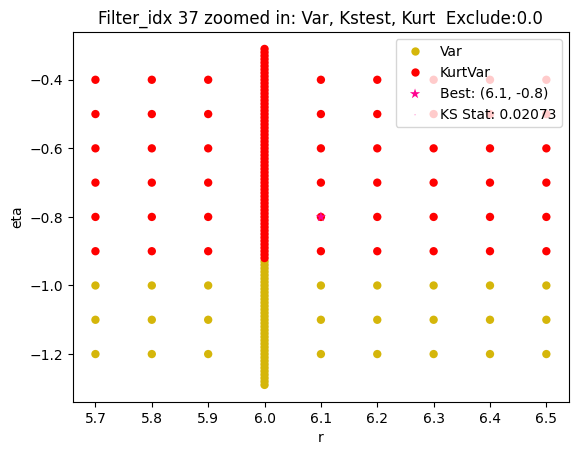

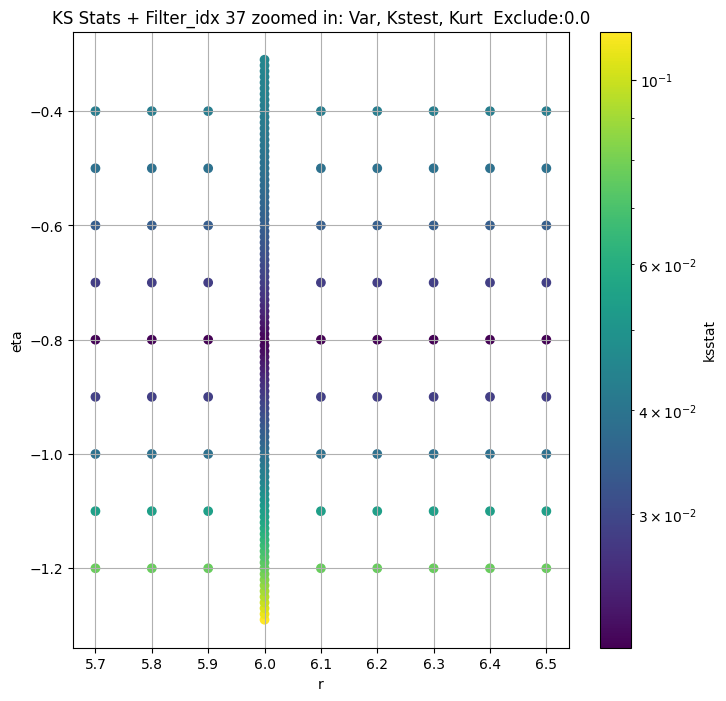

Filter_idx 38


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 0.0 + 100 = 100, ksstat: 0.0088973491749888, var: 5.685442348910336


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 0.0 + 75 = 75, ksstat: 0.008843968581882744, var: 5.8013465132764175


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 0.0 + 50 = 50, ksstat: 0.00875487305926459, var: 5.93380801008433


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 0.0 + 25 = 25, ksstat: 0.008617847886169094, var: 6.093170072462025


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 38, 0.0 + 0 = 0, ksstat: 0.008275770503360258, var: 6.45363780868692
Number of samples: 100000, Without approximation : 196608000.0


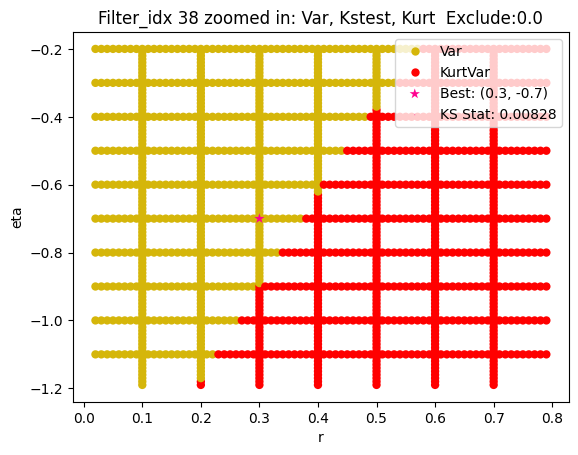

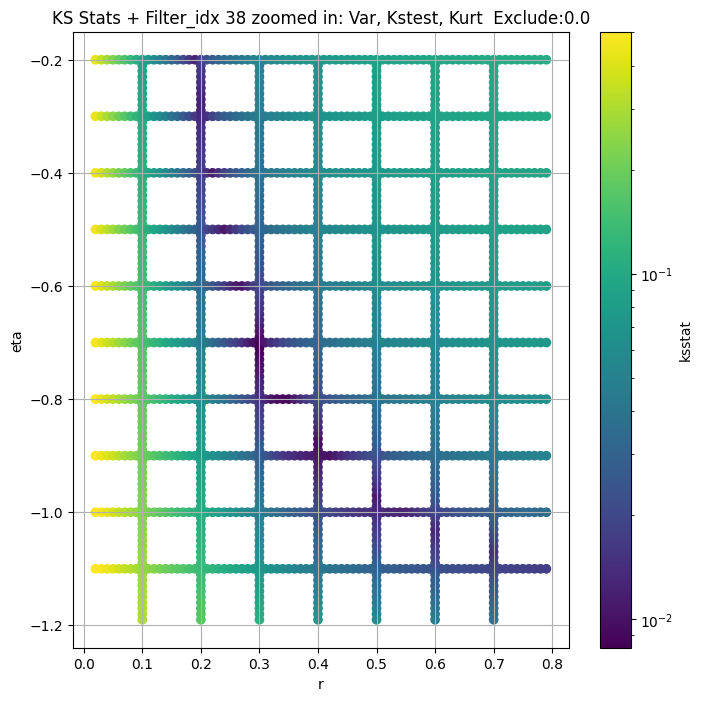

Filter_idx 39


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 50.0 + 100 = 150, ksstat: 0.013069570095380678, var: 4.128919268348789


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 50.0 + 75 = 125, ksstat: 0.0128684382208476, var: 4.182645311799166


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 50.0 + 50 = 100, ksstat: 0.012620041882435706, var: 4.240931794713135


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 50.0 + 25 = 75, ksstat: 0.012398055362920157, var: 4.305255957843038


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 50.0 + 0 = 50, ksstat: 0.011991197955601662, var: 4.37832163509568


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 50.0 + -25 = 25, ksstat: 0.012780765232465463, var: 4.466262874131515


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 50.0 + -50 = 0, ksstat: 0.012668383500526181, var: 4.701398204281019
Number of samples: 100000, Without approximation : 196608000.0


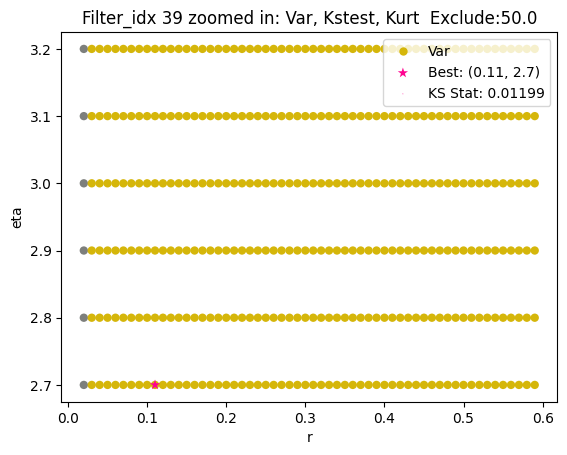

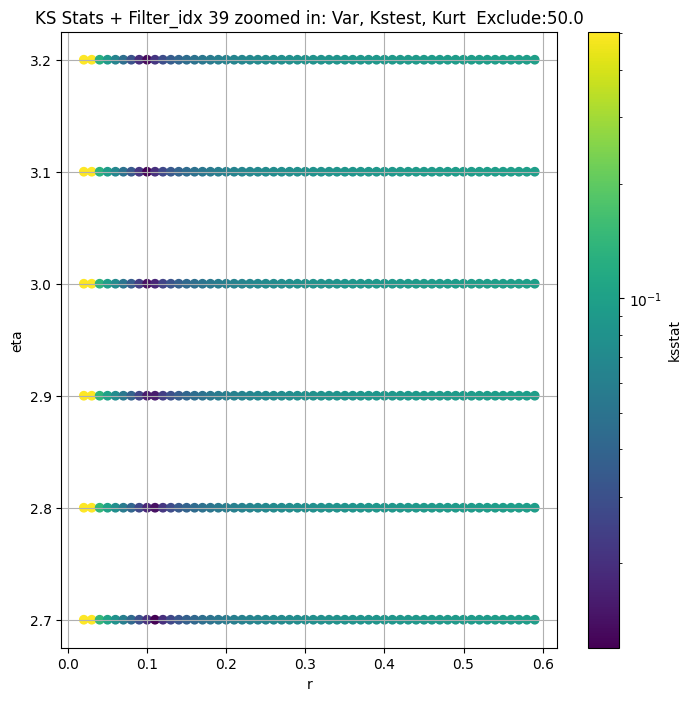

Filter_idx 40


  0%|          | 0/135 [00:00<?, ?it/s]

Finding Minimum after computing 135 CDFs
filter_idx 40, 0.0 + 100 = 100, ksstat: 0.023476755395184734, var: 5.357303086103164


  0%|          | 0/135 [00:00<?, ?it/s]

Finding Minimum after computing 135 CDFs
filter_idx 40, 0.0 + 75 = 75, ksstat: 0.023617280384859662, var: 5.394893205221781


  0%|          | 0/135 [00:00<?, ?it/s]

Finding Minimum after computing 135 CDFs
filter_idx 40, 0.0 + 50 = 50, ksstat: 0.02290835490340648, var: 5.436887778194431


  0%|          | 0/135 [00:00<?, ?it/s]

Finding Minimum after computing 135 CDFs
filter_idx 40, 0.0 + 25 = 25, ksstat: 0.022834718189453262, var: 5.486090494321838


  0%|          | 0/135 [00:00<?, ?it/s]

Finding Minimum after computing 135 CDFs
filter_idx 40, 0.0 + 0 = 0, ksstat: 0.02248229513942862, var: 5.587258246788043
Number of samples: 100000, Without approximation : 196608000.0


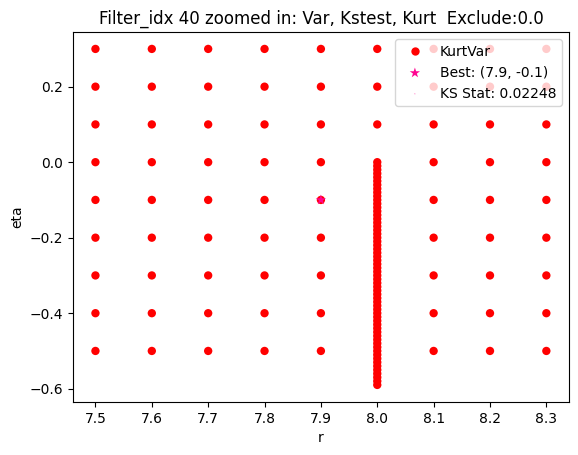

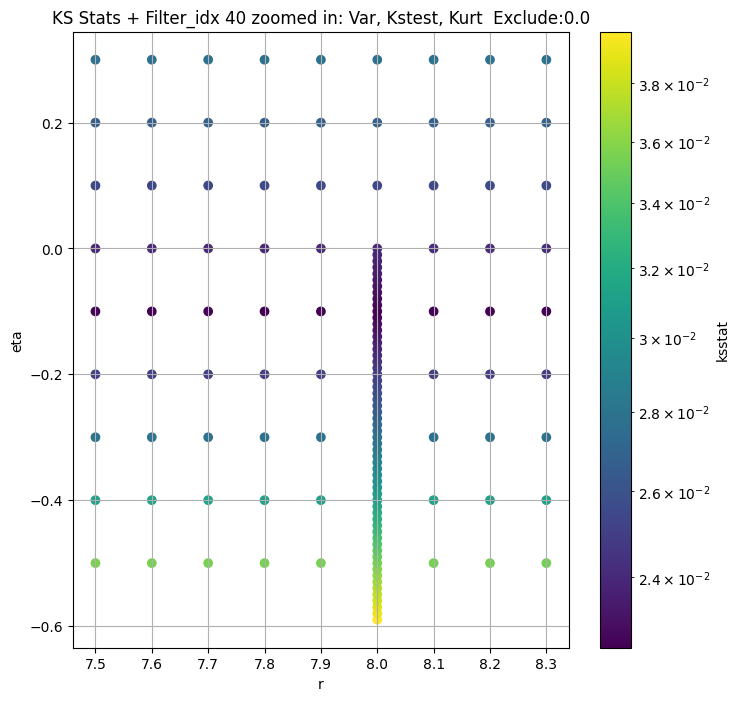

Filter_idx 41


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 41, 50.0 + 100 = 150, ksstat: 0.01036816184314826, var: 2.3336797191509073


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 41, 50.0 + 75 = 125, ksstat: 0.009586432634040465, var: 2.3900042597825375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 41, 50.0 + 50 = 100, ksstat: 0.00982063913845077, var: 2.453094214253551


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 41, 50.0 + 25 = 75, ksstat: 0.00940529640116644, var: 2.5255020849715026


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 41, 50.0 + 0 = 50, ksstat: 0.009343593571957687, var: 2.6120334351527568


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 41, 50.0 + -25 = 25, ksstat: 0.009533388750822436, var: 2.7241511326602783


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 41, 50.0 + -50 = 0, ksstat: 0.009032229708654804, var: 3.029949420860551
Number of samples: 100000, Without approximation : 196608000.0


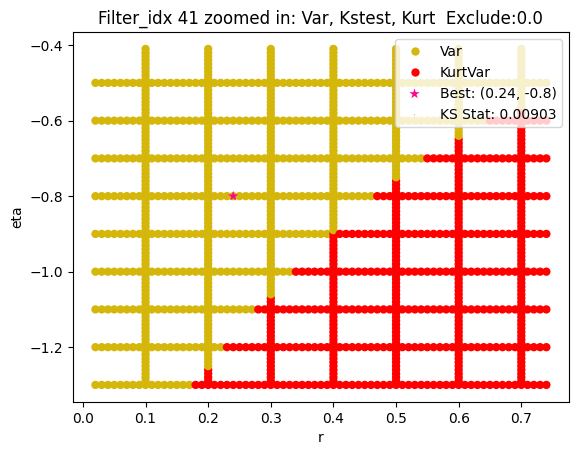

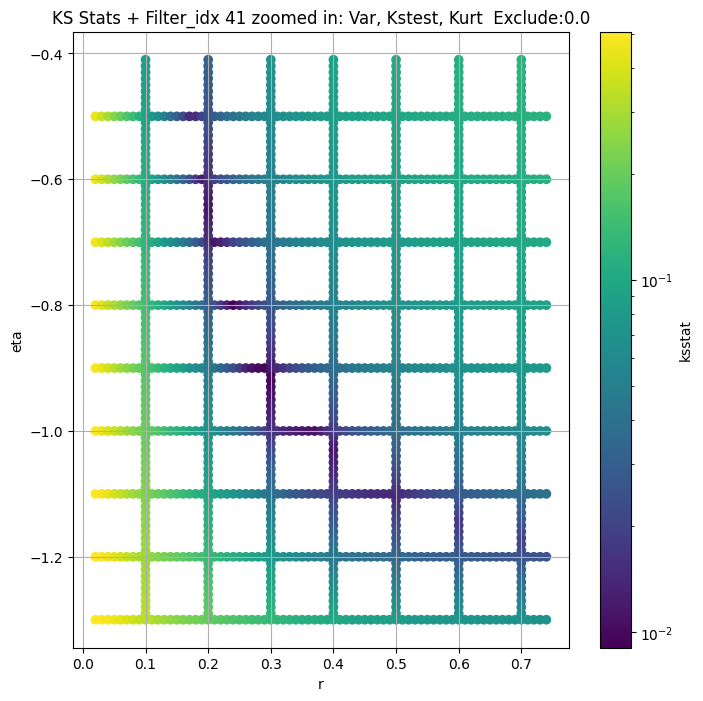

Filter_idx 42


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 42, 100.0 + 100 = 200, ksstat: 0.007967334994431918, var: 5.751719744493269


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 42, 100.0 + 75 = 175, ksstat: 0.007646493564445578, var: 5.874845041929178


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 42, 100.0 + 50 = 150, ksstat: 0.007305497897154678, var: 6.0070721719896305


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 42, 100.0 + 25 = 125, ksstat: 0.007161696840870313, var: 6.150436286288023


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 42, 100.0 + 0 = 100, ksstat: 0.006641362158752273, var: 6.307477724690682


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 42, 100.0 + -25 = 75, ksstat: 0.006483980640931919, var: 6.482311892544777


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 42, 100.0 + -50 = 50, ksstat: 0.006508343965232255, var: 6.6823788534048445


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 42, 100.0 + -75 = 25, ksstat: 0.0065394803750773445, var: 6.92451398066984


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 42, 100.0 + -100 = 0, ksstat: 0.006307576144118976, var: 7.436512547613707
Number of samples: 100000, Without approximation : 196608000.0


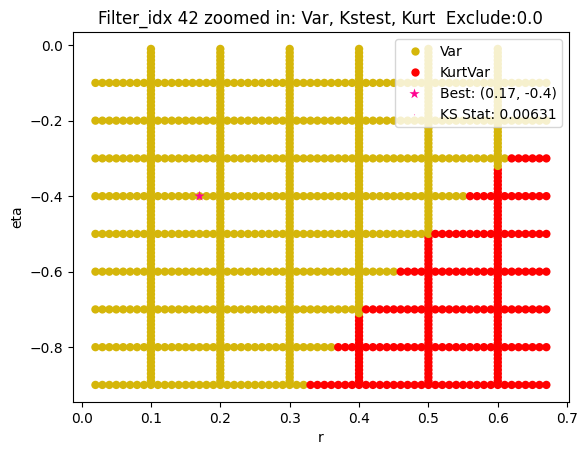

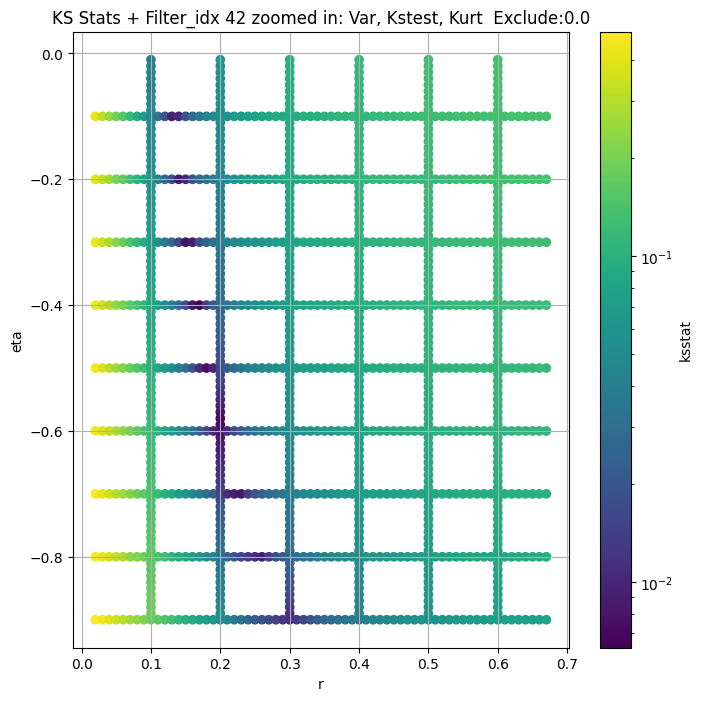

Filter_idx 43


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 43, 0.0 + 100 = 100, ksstat: 0.00717003109263592, var: 2.3783906580062486


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 43, 0.0 + 75 = 75, ksstat: 0.006892338463882264, var: 2.431061447126734


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 43, 0.0 + 50 = 50, ksstat: 0.0068022392961072375, var: 2.4918488085788786


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 43, 0.0 + 25 = 25, ksstat: 0.006658093137108079, var: 2.5664350488850256


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 43, 0.0 + 0 = 0, ksstat: 0.006466011911159808, var: 2.737895469808474
Number of samples: 100000, Without approximation : 196608000.0


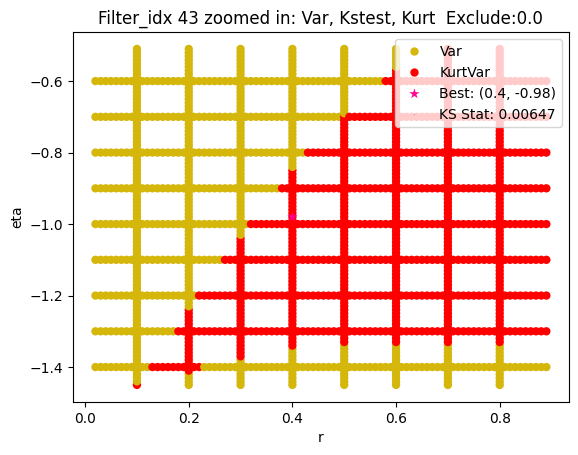

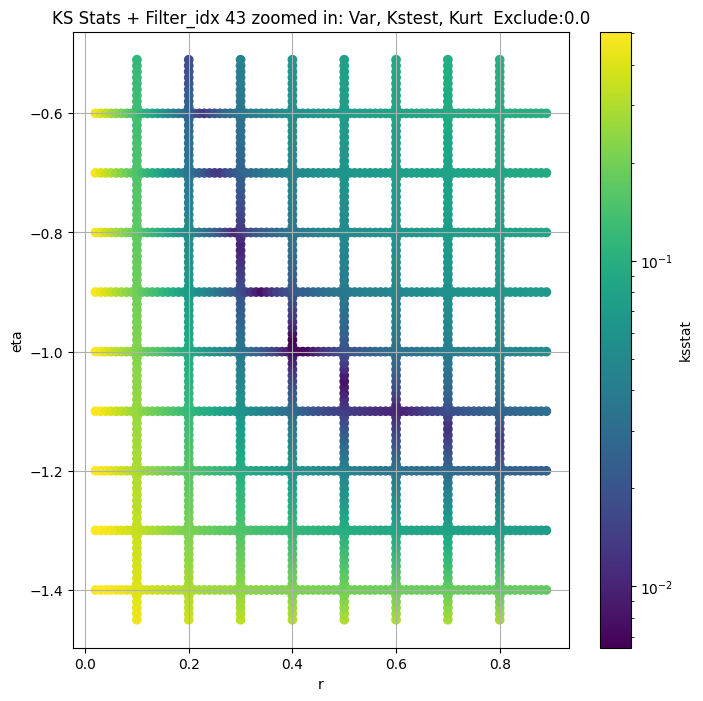

Filter_idx 44


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 44, 100.0 + 100 = 200, ksstat: 0.015503733327727365, var: 5.088684930072415


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 44, 100.0 + 75 = 175, ksstat: 0.015103419971739251, var: 5.188366772504397


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 44, 100.0 + 50 = 150, ksstat: 0.014566167924571605, var: 5.295429686048718


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 44, 100.0 + 25 = 125, ksstat: 0.014511355246021151, var: 5.41142554377648


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 44, 100.0 + 0 = 100, ksstat: 0.014549636328981985, var: 5.538631258150869


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 44, 100.0 + -25 = 75, ksstat: 0.014649609419460419, var: 5.680646631293275


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 44, 100.0 + -50 = 50, ksstat: 0.014574326783697855, var: 5.84370055581932


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 44, 100.0 + -75 = 25, ksstat: 0.01469010427909001, var: 6.042872629271493


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 44, 100.0 + -100 = 0, ksstat: 0.01460018574385269, var: 6.503209747236171
Number of samples: 100000, Without approximation : 196608000.0


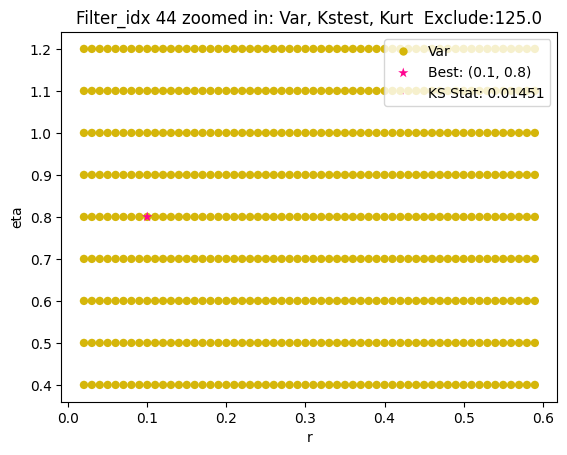

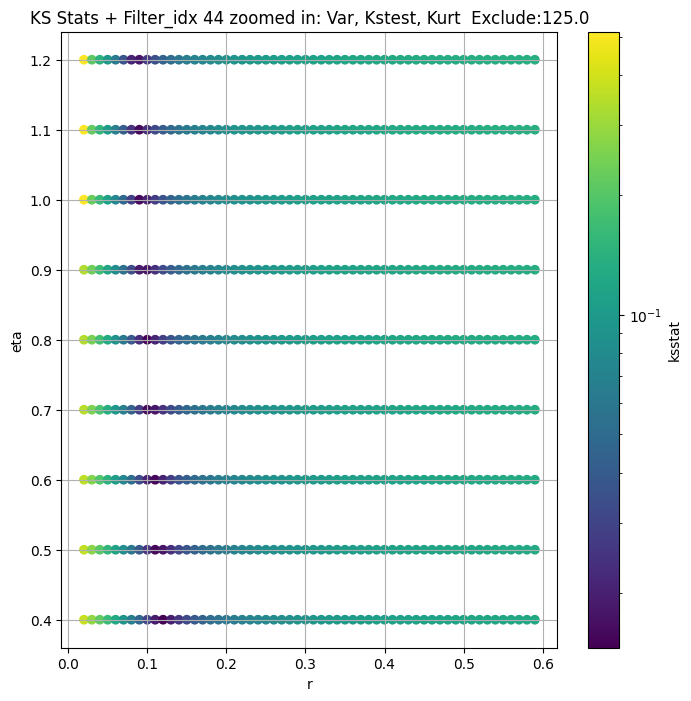

Filter_idx 45


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 45, 100.0 + 100 = 200, ksstat: 0.023422192380255225, var: 2.750679435751055


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 45, 100.0 + 75 = 175, ksstat: 0.02342812204409339, var: 2.790103463290243


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 45, 100.0 + 50 = 150, ksstat: 0.02343152699930673, var: 2.832036511415375


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 45, 100.0 + 25 = 125, ksstat: 0.023422437373360916, var: 2.877025434631491


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 45, 100.0 + 0 = 100, ksstat: 0.023425292377495577, var: 2.925836981117427


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 45, 100.0 + -25 = 75, ksstat: 0.02342442242390419, var: 2.979672684017422


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 45, 100.0 + -50 = 50, ksstat: 0.02345193886689323, var: 3.0406931003539057


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 45, 100.0 + -75 = 25, ksstat: 0.023423635773460405, var: 3.1138763168506003


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 45, 100.0 + -100 = 0, ksstat: 0.02345360786141243, var: 3.317265195111866
Number of samples: 100000, Without approximation : 196608000.0


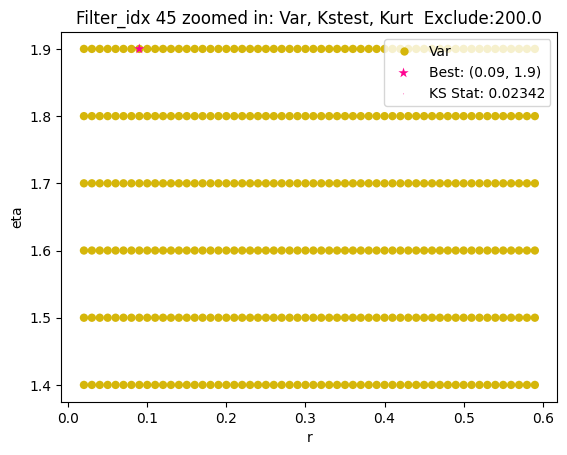

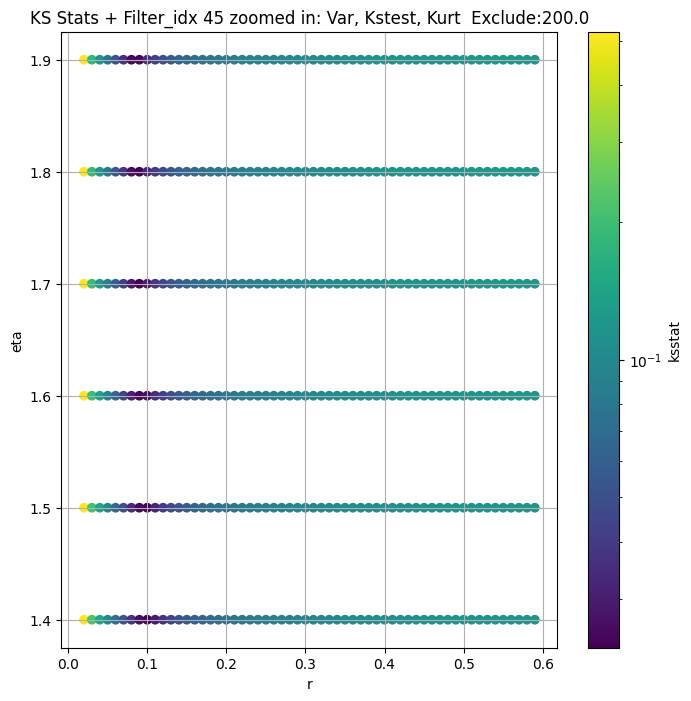

Filter_idx 46


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + 100 = 300, ksstat: 0.007685470866974086, var: 2.063683205865213


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + 75 = 275, ksstat: 0.007341990369080807, var: 2.0832151993733907


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + 50 = 250, ksstat: 0.006982444669400373, var: 2.1035986591643443


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + 25 = 225, ksstat: 0.0066175193715742875, var: 2.124941974502958


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + 0 = 200, ksstat: 0.0064036670278831975, var: 2.1473727744592637


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + -25 = 175, ksstat: 0.0067836567990445795, var: 2.1710489212832598


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + -50 = 150, ksstat: 0.007197226000340562, var: 2.196179281342855


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + -75 = 125, ksstat: 0.007246161311917021, var: 2.223051828030543


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + -100 = 100, ksstat: 0.007575328612048238, var: 2.2520857787326394
Number of samples: 100000, Without approximation : 196608000.0


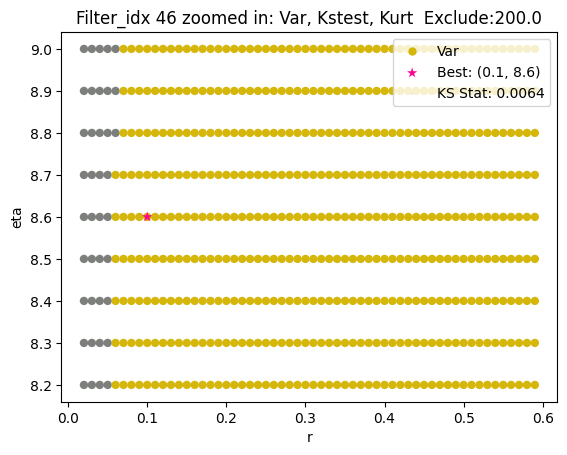

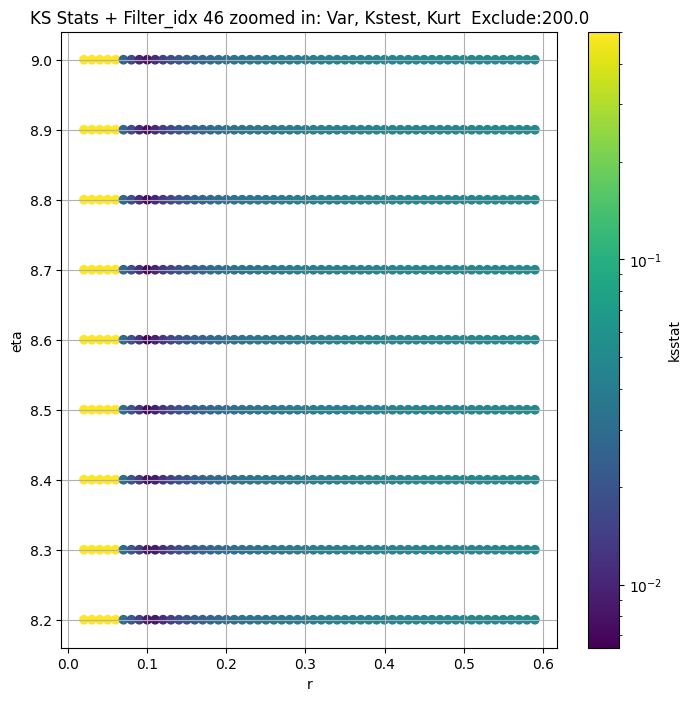

Filter_idx 47


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 47, 200.0 + 100 = 300, ksstat: 0.008253837153689415, var: 3.7456811712334543


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 47, 200.0 + 75 = 275, ksstat: 0.007764336980189024, var: 3.796599885636793


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 47, 200.0 + 50 = 250, ksstat: 0.007967291424830769, var: 3.8497930150266546


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 47, 200.0 + 25 = 225, ksstat: 0.008259818316751322, var: 3.905532546242413


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 47, 200.0 + 0 = 200, ksstat: 0.008189185066794558, var: 3.9641345186024015


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 47, 200.0 + -25 = 175, ksstat: 0.007551723300282989, var: 4.026006973843291


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 47, 200.0 + -50 = 150, ksstat: 0.007325782967390393, var: 4.091675652048506


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 47, 200.0 + -75 = 125, ksstat: 0.007257977089473733, var: 4.161822409020504


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 47, 200.0 + -100 = 100, ksstat: 0.007237235334959929, var: 4.237399615092361
Number of samples: 100000, Without approximation : 196608000.0


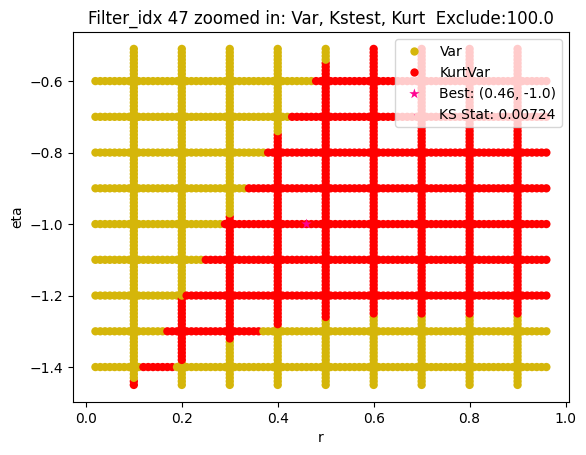

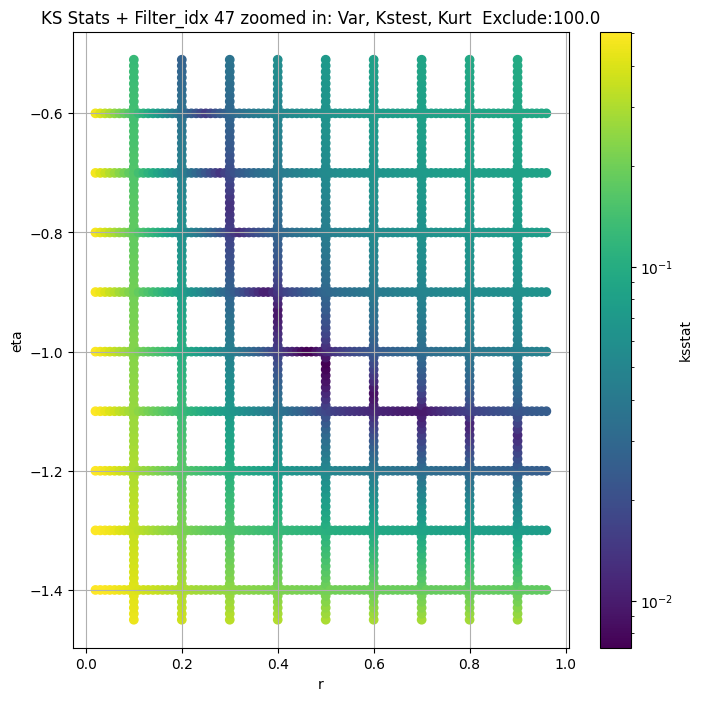

Filter_idx 48


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 0.0 + 100 = 100, ksstat: 0.013248239938700446, var: 2.3400125144794375


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 0.0 + 75 = 75, ksstat: 0.012560413574683182, var: 2.4056722073307726


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 0.0 + 50 = 50, ksstat: 0.012965584927550636, var: 2.4830275122020558


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 0.0 + 25 = 25, ksstat: 0.012009167107030552, var: 2.5812782656938142


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 0.0 + 0 = 0, ksstat: 0.011094902971802878, var: 2.866599742049477
Number of samples: 100000, Without approximation : 196608000.0


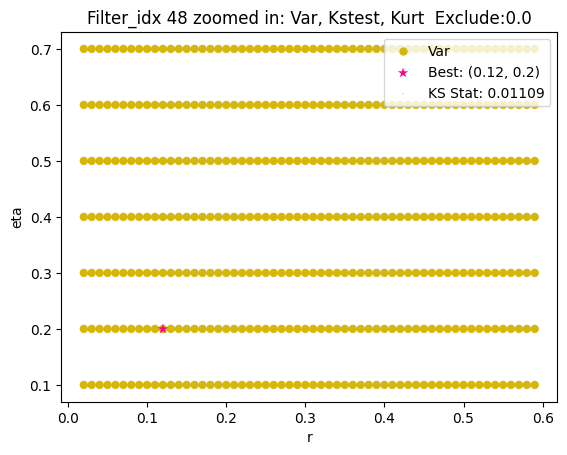

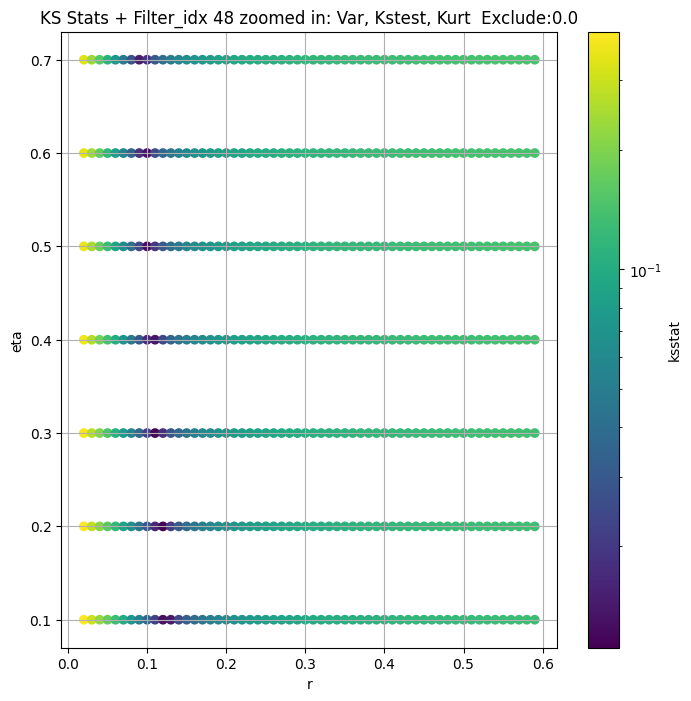

Filter_idx 49


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 49, 0.0 + 100 = 100, ksstat: 0.008772081849808822, var: 4.778322771749875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 49, 0.0 + 75 = 75, ksstat: 0.008962663627004597, var: 4.888650599114242


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 49, 0.0 + 50 = 50, ksstat: 0.008929279387519862, var: 5.015944251951692


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 49, 0.0 + 25 = 25, ksstat: 0.008033239930633734, var: 5.171943493624246


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 49, 0.0 + 0 = 0, ksstat: 0.007670208632055753, var: 5.535145744993295
Number of samples: 100000, Without approximation : 196608000.0


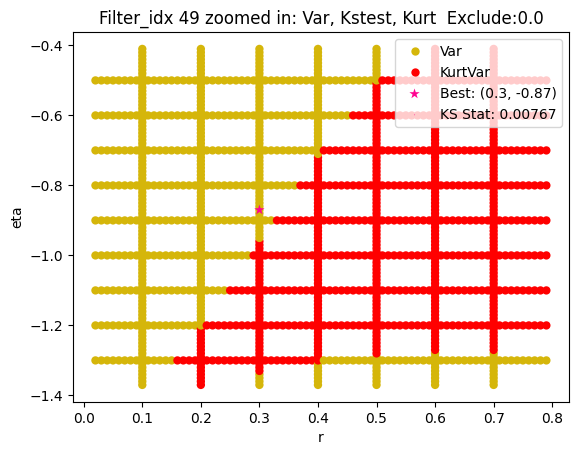

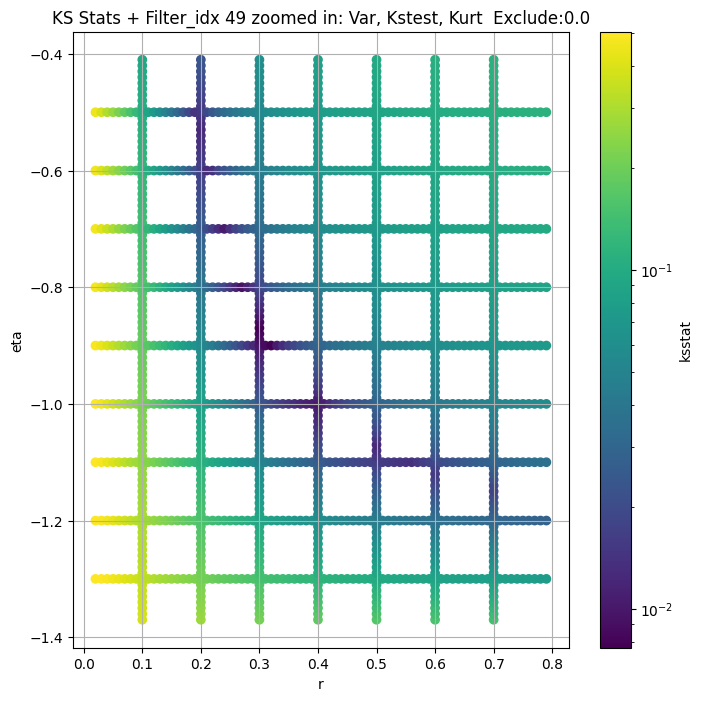

Filter_idx 50


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 50, 0.0 + 100 = 100, ksstat: 0.009502342186869406, var: 2.841410981325586


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 50, 0.0 + 75 = 75, ksstat: 0.00877075394941862, var: 2.9135255135199984


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 50, 0.0 + 50 = 50, ksstat: 0.008642223756390233, var: 2.9980743113142503


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 50, 0.0 + 25 = 25, ksstat: 0.008666349889211777, var: 3.1049759058603312


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 50, 0.0 + 0 = 0, ksstat: 0.00816544615096021, var: 3.3415120807406677
Number of samples: 100000, Without approximation : 196608000.0


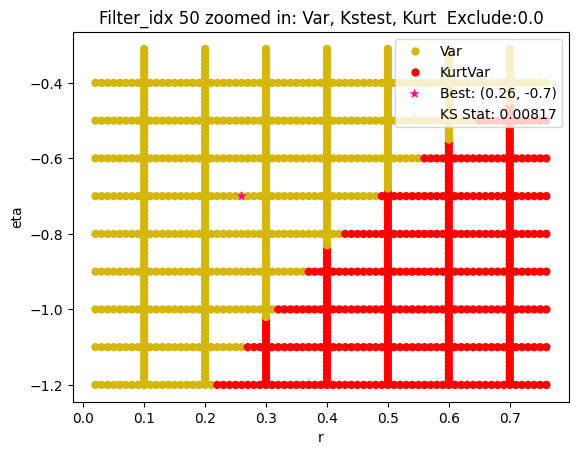

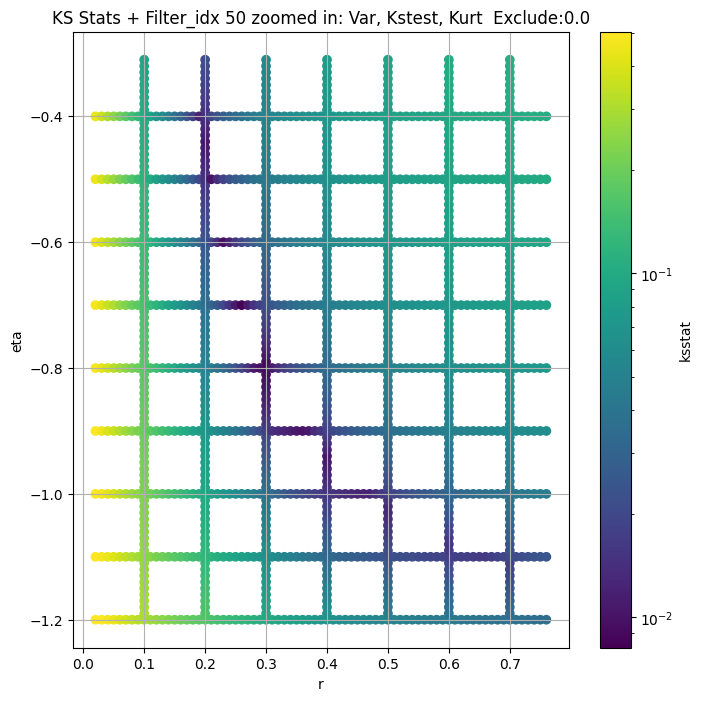

Filter_idx 51


  0%|          | 0/1 [00:00<?, ?it/s]

Finding Minimum after computing 1 CDFs
filter_idx 51, 0.0 + 100 = 100, ksstat: 0.025691522800542377, var: 7.077233835919955


  0%|          | 0/1 [00:00<?, ?it/s]

Finding Minimum after computing 1 CDFs
filter_idx 51, 0.0 + 75 = 75, ksstat: 0.025169167725371033, var: 7.119084998330045


  0%|          | 0/1 [00:00<?, ?it/s]

Finding Minimum after computing 1 CDFs
filter_idx 51, 0.0 + 50 = 50, ksstat: 0.024594523923382128, var: 7.165814548780171


  0%|          | 0/1 [00:00<?, ?it/s]

Finding Minimum after computing 1 CDFs
filter_idx 51, 0.0 + 25 = 25, ksstat: 0.023921424471341823, var: 7.2212152936182665


  0%|          | 0/1 [00:00<?, ?it/s]

Finding Minimum after computing 1 CDFs
filter_idx 51, 0.0 + 0 = 0, ksstat: 0.022607094938112637, var: 7.332507084360567
Number of samples: 100000, Without approximation : 196608000.0


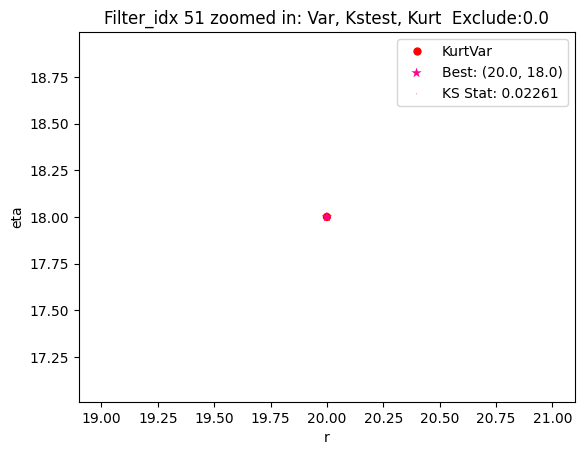

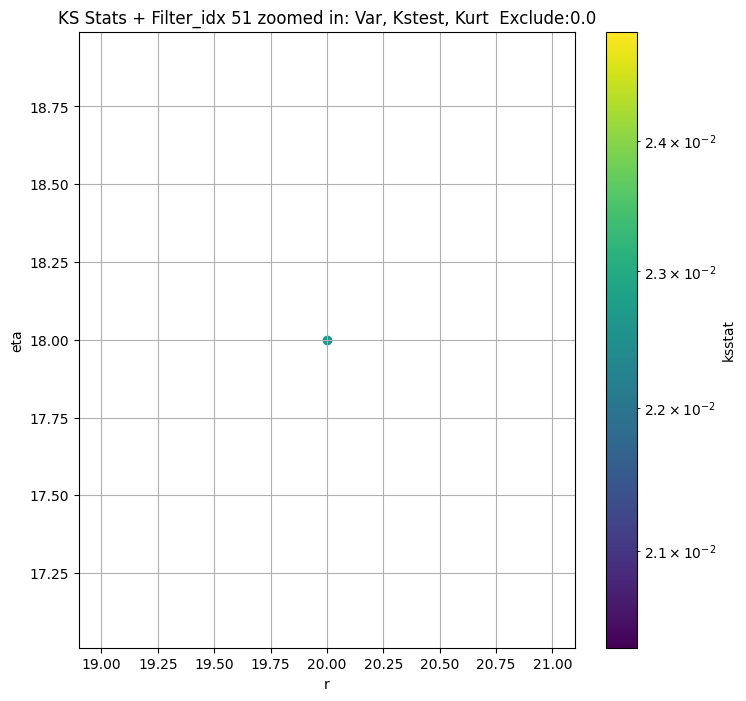

Filter_idx 52


  0%|          | 0/135 [00:00<?, ?it/s]

Finding Minimum after computing 135 CDFs
filter_idx 52, 0.0 + 100 = 100, ksstat: 0.021984344850894788, var: 5.039675424763914


  0%|          | 0/135 [00:00<?, ?it/s]

Finding Minimum after computing 135 CDFs
filter_idx 52, 0.0 + 75 = 75, ksstat: 0.022395000710889512, var: 5.077709637867946


  0%|          | 0/135 [00:00<?, ?it/s]

Finding Minimum after computing 135 CDFs
filter_idx 52, 0.0 + 50 = 50, ksstat: 0.021990593739003694, var: 5.120323092988881


  0%|          | 0/135 [00:00<?, ?it/s]

Finding Minimum after computing 135 CDFs
filter_idx 52, 0.0 + 25 = 25, ksstat: 0.021632618130623227, var: 5.170883918516654


  0%|          | 0/135 [00:00<?, ?it/s]

Finding Minimum after computing 135 CDFs
filter_idx 52, 0.0 + 0 = 0, ksstat: 0.021321323109089074, var: 5.278592211937019
Number of samples: 100000, Without approximation : 196608000.0


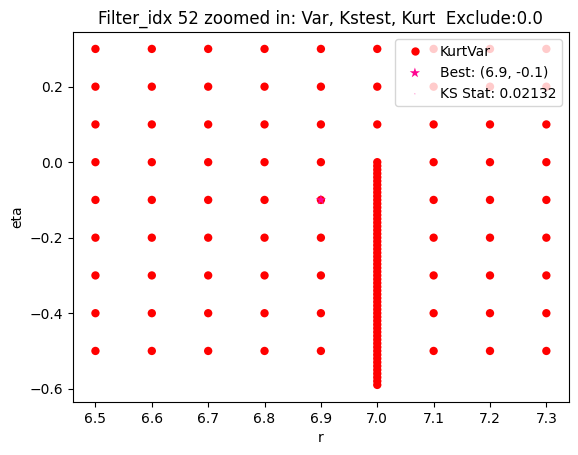

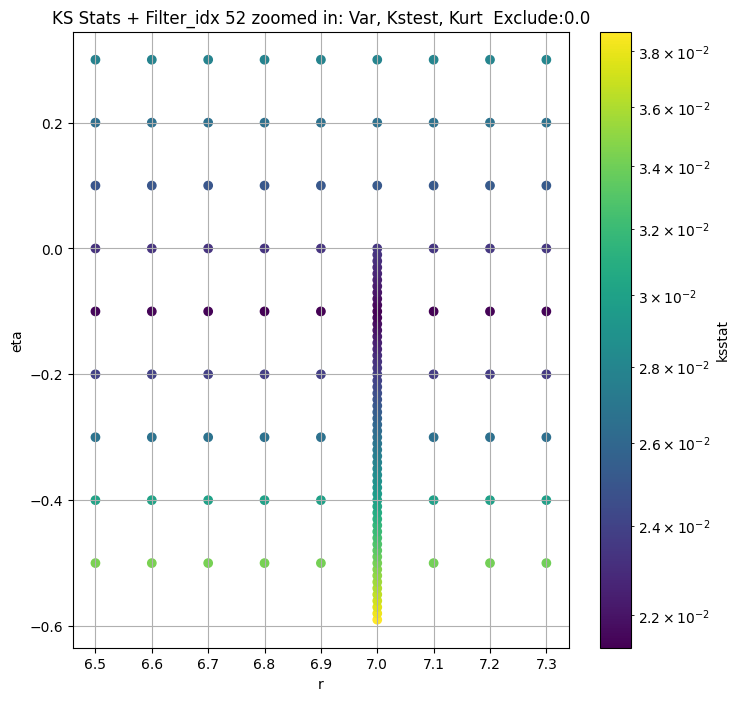

Filter_idx 53


  0%|          | 0/180 [00:00<?, ?it/s]

Finding Minimum after computing 180 CDFs
filter_idx 53, 0.0 + 100 = 100, ksstat: 0.020815495316399146, var: 1.4909071326606604


  0%|          | 0/180 [00:00<?, ?it/s]

Finding Minimum after computing 180 CDFs
filter_idx 53, 0.0 + 75 = 75, ksstat: 0.02043188991062772, var: 1.502722720135475


  0%|          | 0/180 [00:00<?, ?it/s]

Finding Minimum after computing 180 CDFs
filter_idx 53, 0.0 + 50 = 50, ksstat: 0.020058851356661744, var: 1.5159642034773944


  0%|          | 0/180 [00:00<?, ?it/s]

Finding Minimum after computing 180 CDFs
filter_idx 53, 0.0 + 25 = 25, ksstat: 0.019871200263268607, var: 1.5316752760717225


  0%|          | 0/180 [00:00<?, ?it/s]

Finding Minimum after computing 180 CDFs
filter_idx 53, 0.0 + 0 = 0, ksstat: 0.018906902214310906, var: 1.5653685412774074
Number of samples: 100000, Without approximation : 196608000.0


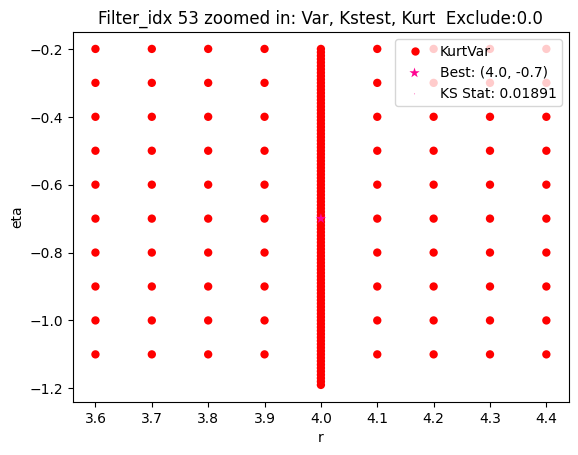

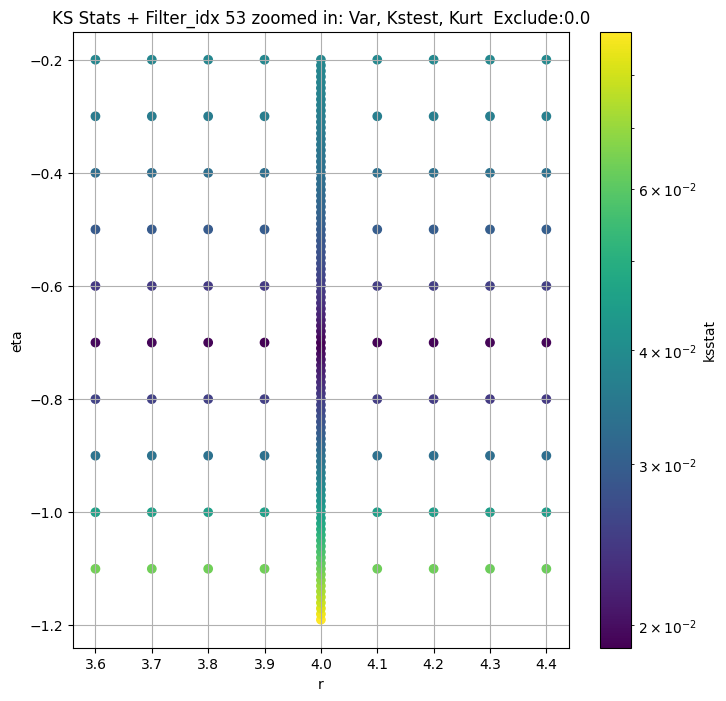

Filter_idx 54


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 54, 200.0 + 100 = 300, ksstat: 0.010825129387111873, var: 2.8889746363593303


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 54, 200.0 + 75 = 275, ksstat: 0.011346753363833284, var: 2.937225340254313


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 54, 200.0 + 50 = 250, ksstat: 0.011160233801625896, var: 2.9883125061167184


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 54, 200.0 + 25 = 225, ksstat: 0.011431457618301999, var: 3.042637101267474


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 54, 200.0 + 0 = 200, ksstat: 0.011225296196928358, var: 3.100758081228067


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 54, 200.0 + -25 = 175, ksstat: 0.011496659000230003, var: 3.163350487208732


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 54, 200.0 + -50 = 150, ksstat: 0.010600037889031452, var: 3.231380630916555


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 54, 200.0 + -75 = 125, ksstat: 0.010244482316643516, var: 3.30619933479883


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 54, 200.0 + -100 = 100, ksstat: 0.00974300804548267, var: 3.389797709367561
Number of samples: 100000, Without approximation : 196608000.0


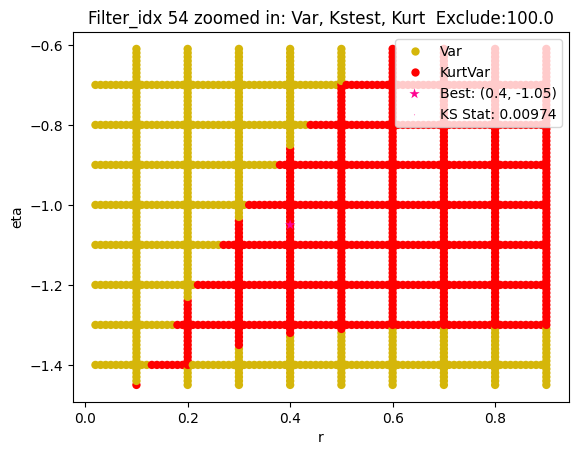

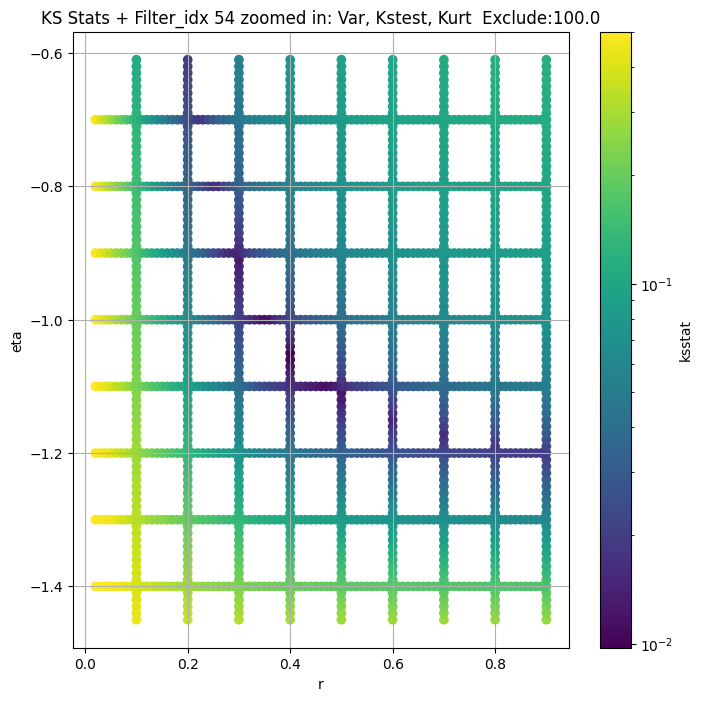

Filter_idx 55


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 55, 50.0 + 100 = 150, ksstat: 0.009387907169135401, var: 2.2535846175371166


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 55, 50.0 + 75 = 125, ksstat: 0.009579874310791436, var: 2.3042951227168658


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 55, 50.0 + 50 = 100, ksstat: 0.009470715892821557, var: 2.3609935855558537


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 55, 50.0 + 25 = 75, ksstat: 0.009660565441302005, var: 2.425892645266923


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 55, 50.0 + 0 = 50, ksstat: 0.009258371408221167, var: 2.503179705202855


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 55, 50.0 + -25 = 25, ksstat: 0.009082394987808162, var: 2.6026458558755317


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 55, 50.0 + -50 = 0, ksstat: 0.009267367503010049, var: 2.850806564374326
Number of samples: 100000, Without approximation : 196608000.0


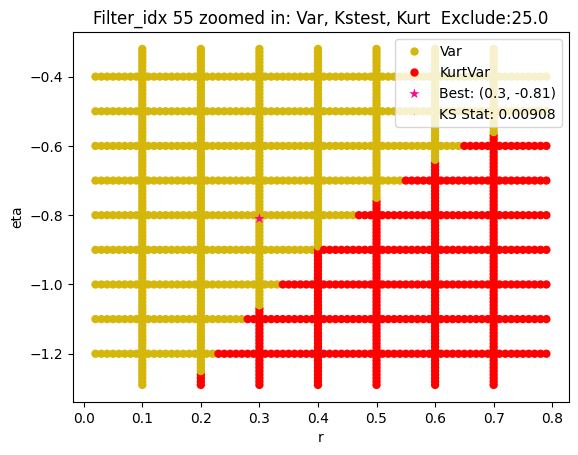

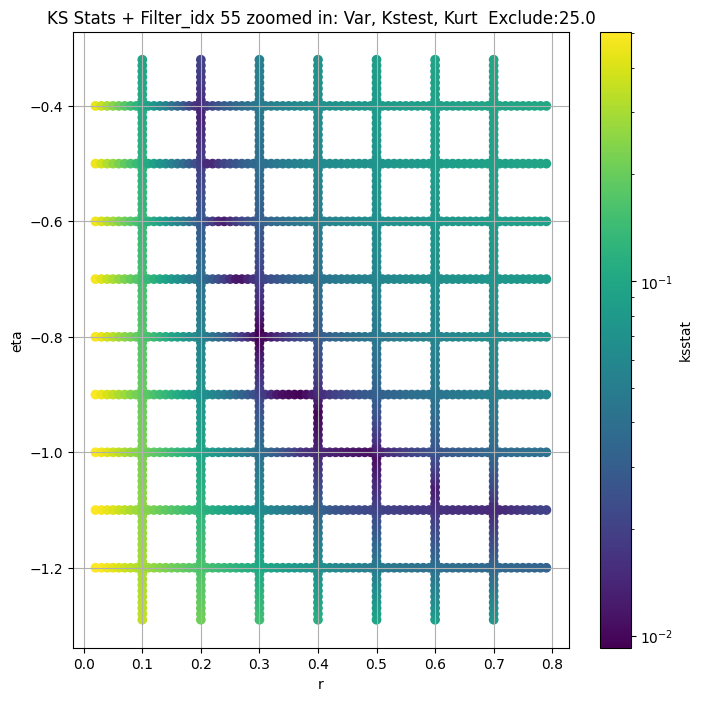

Filter_idx 56


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 56, 100.0 + 100 = 200, ksstat: 0.009803783746551553, var: 4.878884931955164


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 56, 100.0 + 75 = 175, ksstat: 0.01028674989772882, var: 4.972379374836368


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 56, 100.0 + 50 = 150, ksstat: 0.00992148769217216, var: 5.072561274569895


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 56, 100.0 + 25 = 125, ksstat: 0.009909030773403271, var: 5.180691524052777


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 56, 100.0 + 0 = 100, ksstat: 0.010048732626649293, var: 5.298606280534825


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 56, 100.0 + -25 = 75, ksstat: 0.009517416739230233, var: 5.429105073171894


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 56, 100.0 + -50 = 50, ksstat: 0.008924153267280632, var: 5.57690113048974


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 56, 100.0 + -75 = 25, ksstat: 0.008547266019855337, var: 5.752328997777015


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 56, 100.0 + -100 = 0, ksstat: 0.008361081793838654, var: 6.159066823729277
Number of samples: 100000, Without approximation : 196608000.0


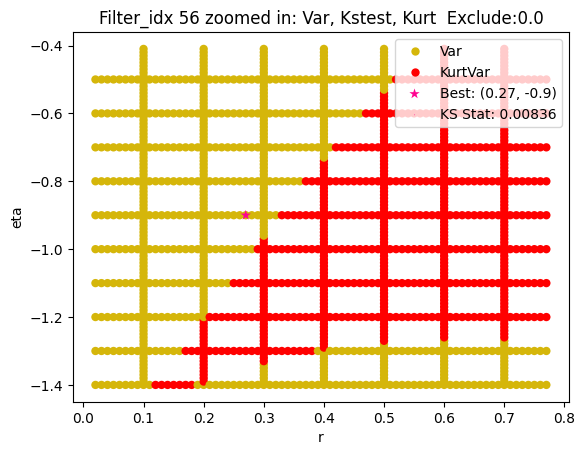

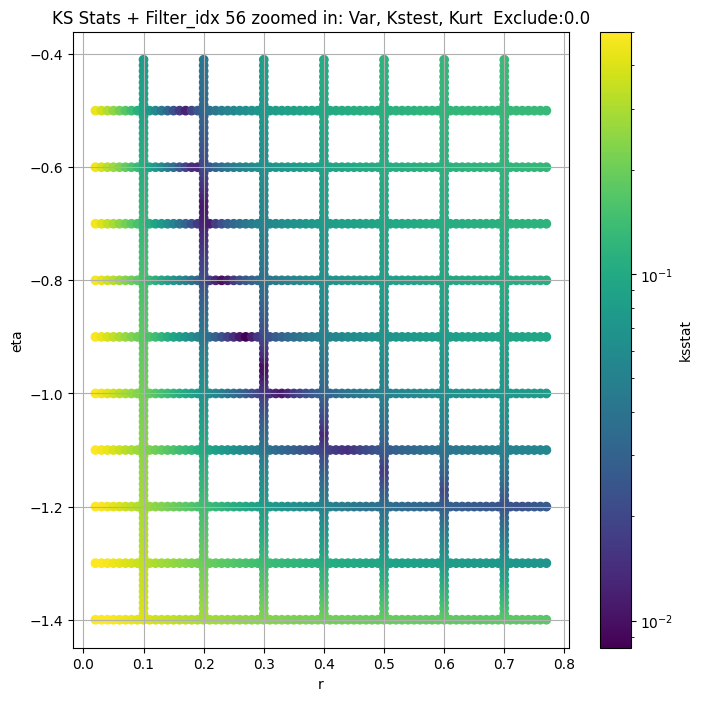

Filter_idx 57


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 57, 200.0 + 100 = 300, ksstat: 0.007447894657077868, var: 2.2758895981337943


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 57, 200.0 + 75 = 275, ksstat: 0.006940516859681334, var: 2.3104218783350077


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 57, 200.0 + 50 = 250, ksstat: 0.006904595675425562, var: 2.346912198124614


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 57, 200.0 + 25 = 225, ksstat: 0.007468416376571085, var: 2.3856460281069087


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 57, 200.0 + 0 = 200, ksstat: 0.0069329094424243065, var: 2.4269891195150928


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 57, 200.0 + -25 = 175, ksstat: 0.006385099649192427, var: 2.4714156078636247


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 57, 200.0 + -50 = 150, ksstat: 0.006107789346447845, var: 2.519557383158886


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 57, 200.0 + -75 = 125, ksstat: 0.006235423961625464, var: 2.572292645480567


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 57, 200.0 + -100 = 100, ksstat: 0.006113728114929162, var: 2.630961539800639
Number of samples: 100000, Without approximation : 196608000.0


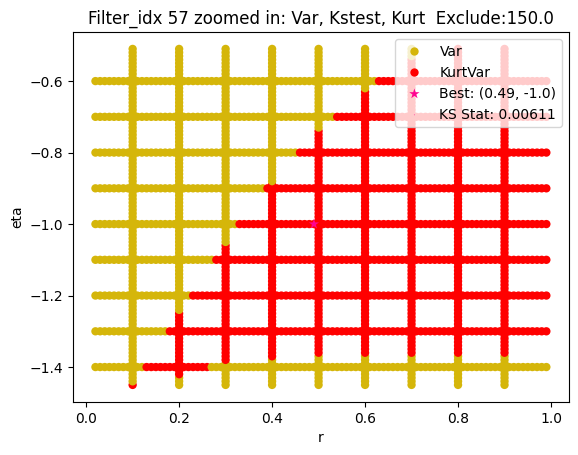

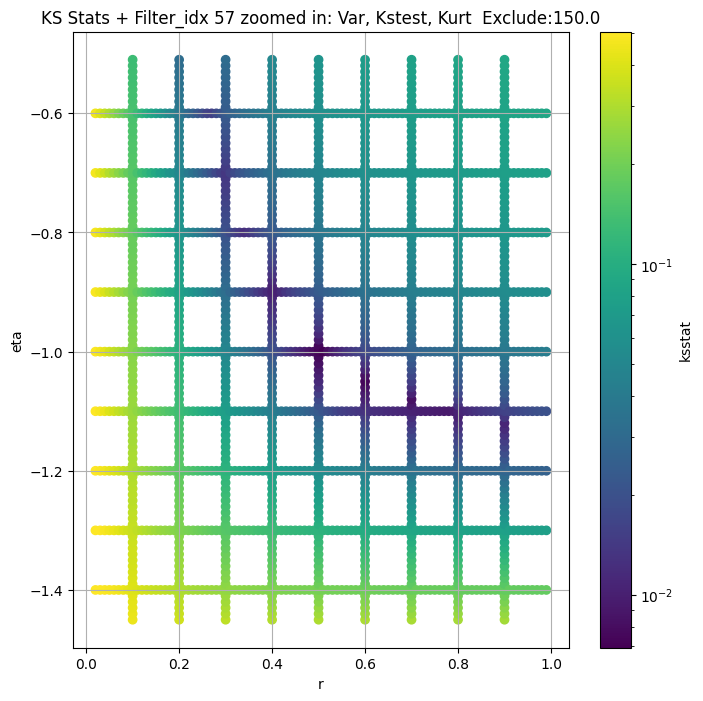

Filter_idx 58


  0%|          | 0/99 [00:00<?, ?it/s]

Finding Minimum after computing 99 CDFs
filter_idx 58, 0.0 + 100 = 100, ksstat: 0.023839545264422723, var: 2.7251143289022135


  0%|          | 0/99 [00:00<?, ?it/s]

Finding Minimum after computing 99 CDFs
filter_idx 58, 0.0 + 75 = 75, ksstat: 0.023277183407146407, var: 2.7453777581294894


  0%|          | 0/99 [00:00<?, ?it/s]

Finding Minimum after computing 99 CDFs
filter_idx 58, 0.0 + 50 = 50, ksstat: 0.02264992608859734, var: 2.768315212099537


  0%|          | 0/99 [00:00<?, ?it/s]

Finding Minimum after computing 99 CDFs
filter_idx 58, 0.0 + 25 = 25, ksstat: 0.02191322762584552, var: 2.7959603819526673


  0%|          | 0/99 [00:00<?, ?it/s]

Finding Minimum after computing 99 CDFs
filter_idx 58, 0.0 + 0 = 0, ksstat: 0.02080313386354493, var: 2.8596056017484406
Number of samples: 100000, Without approximation : 196608000.0


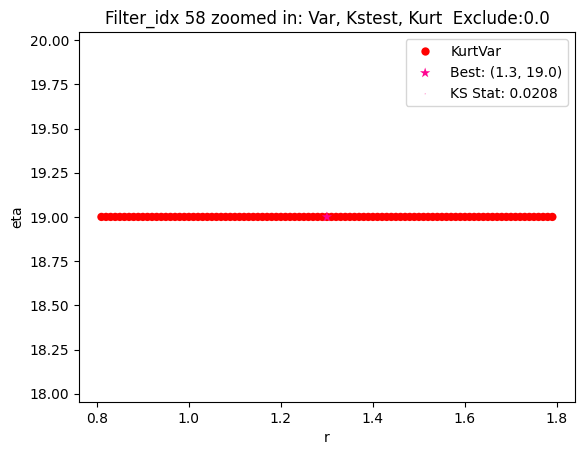

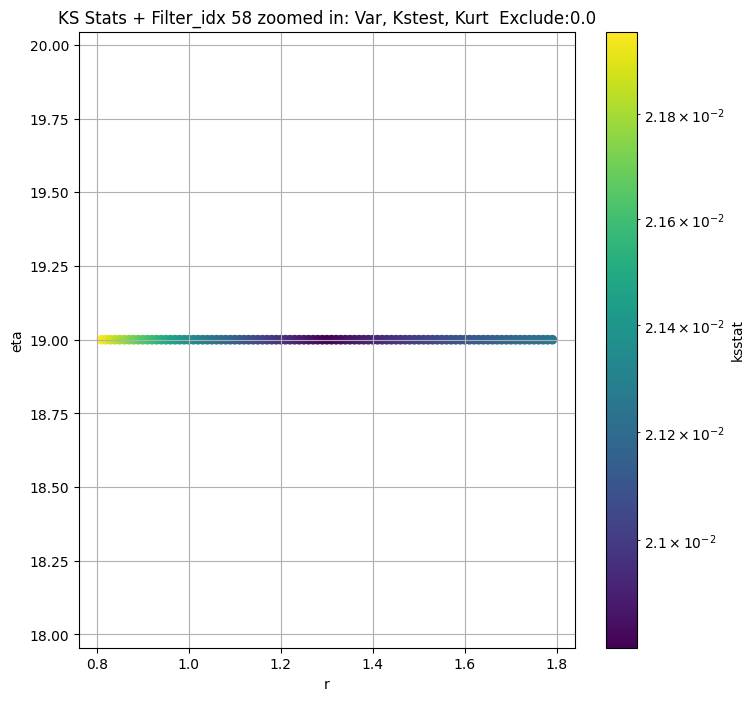

Filter_idx 59


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 59, 0.0 + 100 = 100, ksstat: 0.008884180811809472, var: 6.277027509775488


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 59, 0.0 + 75 = 75, ksstat: 0.00876706854001913, var: 6.392698599371405


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 59, 0.0 + 50 = 50, ksstat: 0.008740194619071884, var: 6.523877216494874


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 59, 0.0 + 25 = 25, ksstat: 0.008820449840534927, var: 6.6806091635080955


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 59, 0.0 + 0 = 0, ksstat: 0.008626618757662963, var: 6.9931679208625654
Number of samples: 100000, Without approximation : 196608000.0


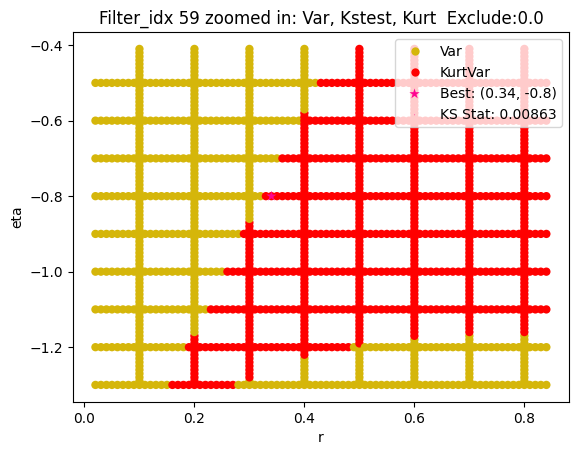

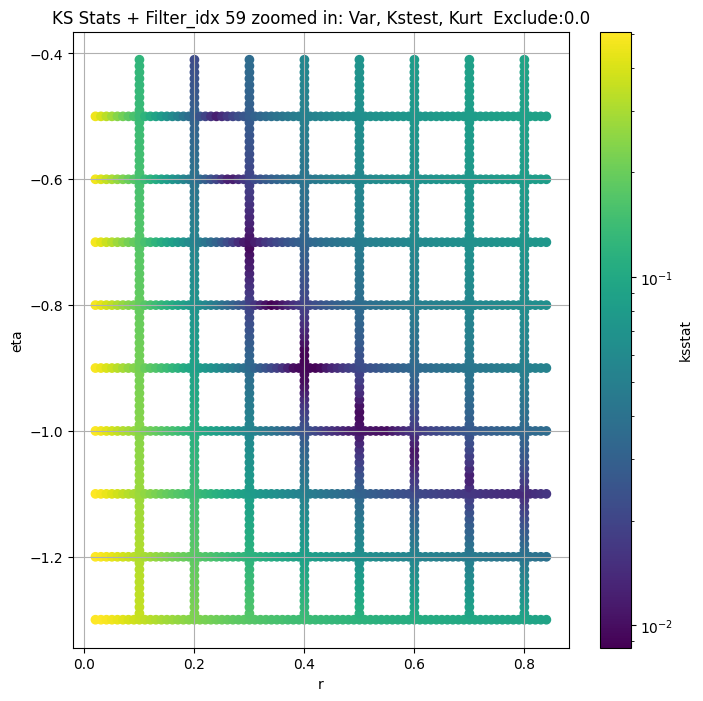

Filter_idx 60


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 50.0 + 100 = 150, ksstat: 0.008912194993488942, var: 0.7209152457063975


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 50.0 + 75 = 125, ksstat: 0.008742537669180539, var: 0.7347160123777681


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 50.0 + 50 = 100, ksstat: 0.00795251673306352, var: 0.7499865191436581


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 50.0 + 25 = 75, ksstat: 0.007580911740165064, var: 0.7672688876856388


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 50.0 + 0 = 50, ksstat: 0.007120852638722308, var: 0.7875493226256042


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 50.0 + -25 = 25, ksstat: 0.0070738689339135685, var: 0.8131919108545101


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 50.0 + -50 = 0, ksstat: 0.007993353888472554, var: 0.8953706362141154
Number of samples: 100000, Without approximation : 196608000.0


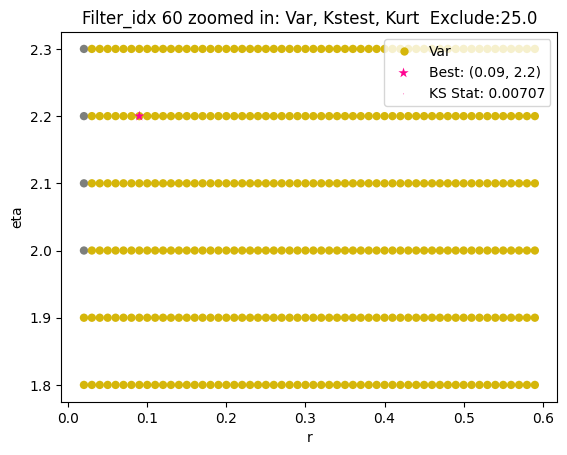

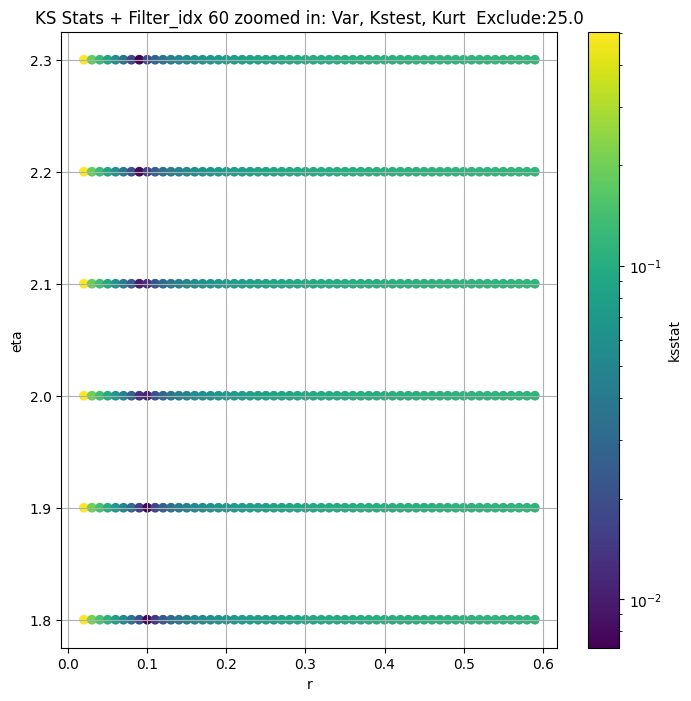

Filter_idx 61


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 61, 200.0 + 100 = 300, ksstat: 0.014204652955466468, var: 1.9413666230904445


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 61, 200.0 + 75 = 275, ksstat: 0.014582591168851133, var: 1.9742068651377758


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 61, 200.0 + 50 = 250, ksstat: 0.014646422752031207, var: 2.0089450045203825


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 61, 200.0 + 25 = 225, ksstat: 0.014127690362312095, var: 2.0458311121720314


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 61, 200.0 + 0 = 200, ksstat: 0.014212863948242338, var: 2.0852106846246885


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 61, 200.0 + -25 = 175, ksstat: 0.013902265747335635, var: 2.1275359895168355


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 61, 200.0 + -50 = 150, ksstat: 0.013895794307288767, var: 2.173341008112097


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 61, 200.0 + -75 = 125, ksstat: 0.013931923162516346, var: 2.2234278914508656


  0%|          | 0/1125 [00:00<?, ?it/s]

Finding Minimum after computing 1125 CDFs
filter_idx 61, 200.0 + -100 = 100, ksstat: 0.013952376868083927, var: 2.2789464985928003
Number of samples: 100000, Without approximation : 196608000.0


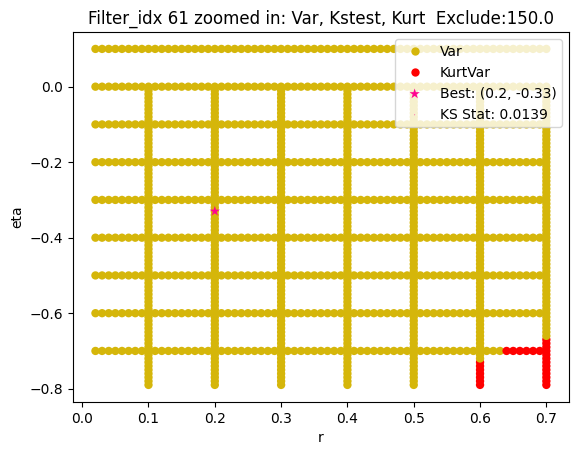

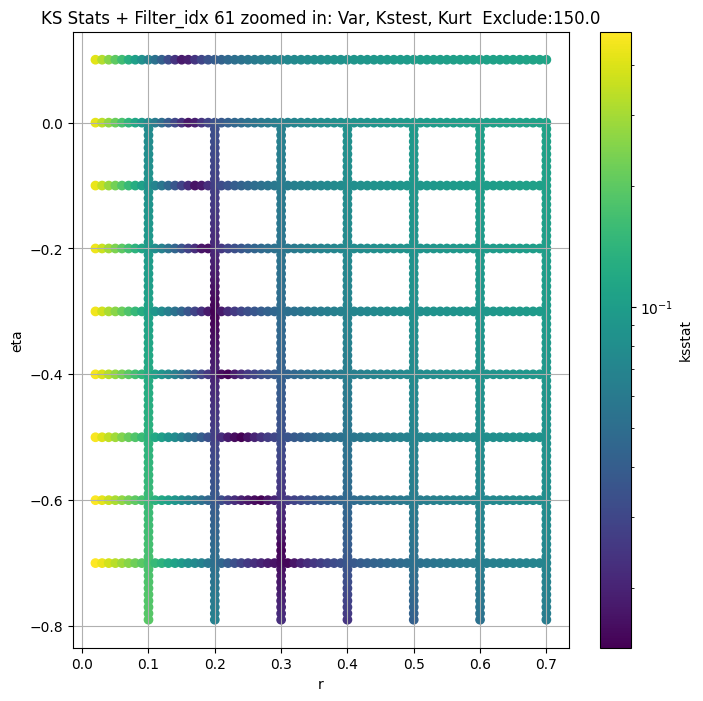

Filter_idx 62


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 62, 200.0 + 100 = 300, ksstat: 0.019496137808723946, var: 4.664699035288638


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 62, 200.0 + 75 = 275, ksstat: 0.019440576155551503, var: 4.728258228373038


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 62, 200.0 + 50 = 250, ksstat: 0.019311407211170417, var: 4.794529858392684


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 62, 200.0 + 25 = 225, ksstat: 0.019065219999286454, var: 4.863862734939975


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 62, 200.0 + 0 = 200, ksstat: 0.018979823396177042, var: 4.9366865958391015


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 62, 200.0 + -25 = 175, ksstat: 0.01911477409700868, var: 5.013491008129709


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 62, 200.0 + -50 = 150, ksstat: 0.018941968108429963, var: 5.0949404449172295


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 62, 200.0 + -75 = 125, ksstat: 0.019096825436603626, var: 5.181928455446516


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 62, 200.0 + -100 = 100, ksstat: 0.019220731155243476, var: 5.275797653225952
Number of samples: 100000, Without approximation : 196608000.0


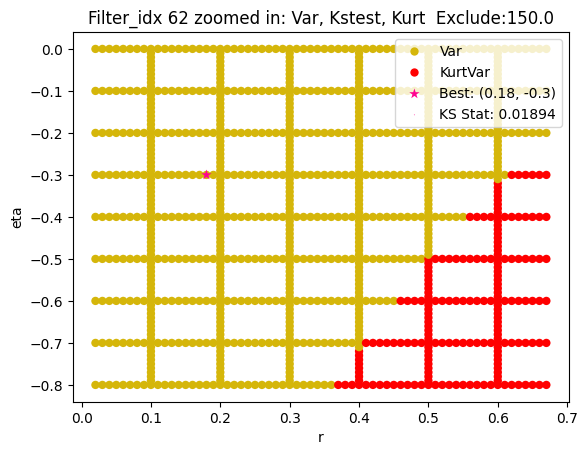

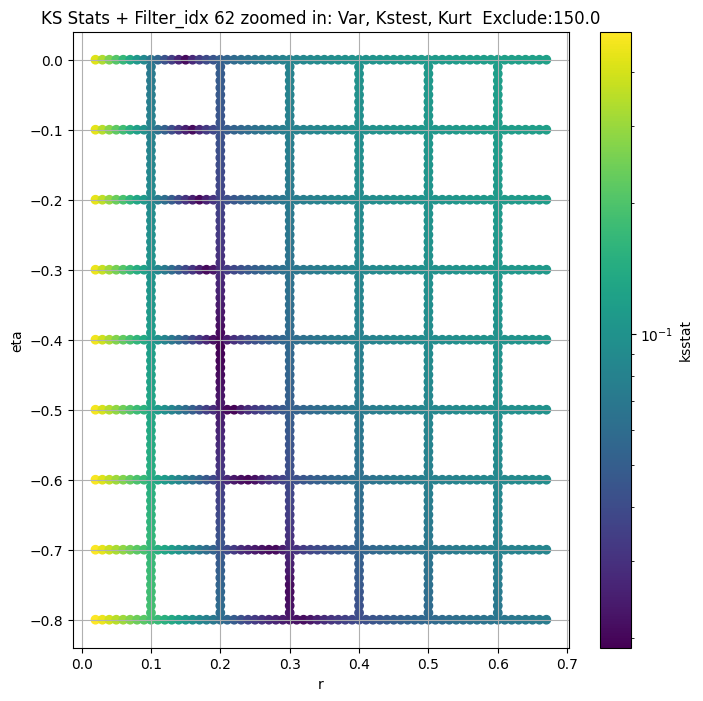

Filter_idx 63


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 63, 50.0 + 100 = 150, ksstat: 0.01307785924285032, var: 2.049176694390273


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 63, 50.0 + 75 = 125, ksstat: 0.012861101526694244, var: 2.094763858301519


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 63, 50.0 + 50 = 100, ksstat: 0.012641102803406912, var: 2.145631415952161


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 63, 50.0 + 25 = 75, ksstat: 0.012077363519952145, var: 2.203772781723584


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 63, 50.0 + 0 = 50, ksstat: 0.011941261532319392, var: 2.2728803610154826


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 63, 50.0 + -25 = 25, ksstat: 0.012098508982715694, var: 2.3620536080080177


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 63, 50.0 + -50 = 0, ksstat: 0.012295314465695206, var: 2.624194787334652
Number of samples: 100000, Without approximation : 196608000.0


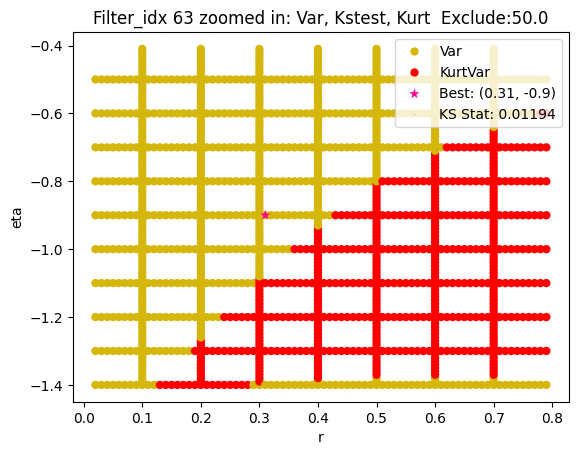

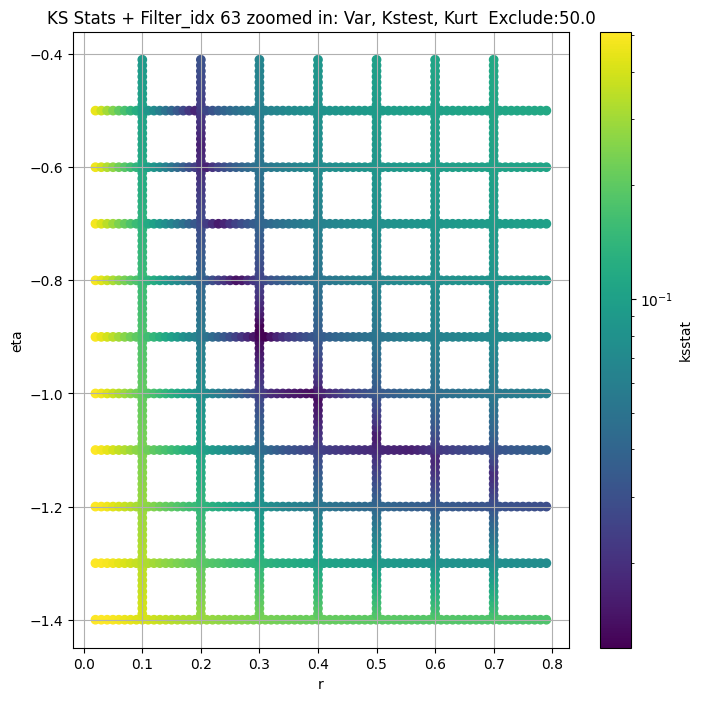

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,5.587389,3.885470,13.307504,43.956472,5.678748,345.988257,196608000.0,dual_color,0.011997,0.2,...,1.228525e-04,50.0,4.955935,0.000097,0.011840,0.21,-0.20,2.544954e-04,75.0,13500
1,6.543445,5.507461,8.010498,2.258367,0.206318,46.515398,196608000.0,misc,0.011271,5.1,...,1.287905e+01,0.0,6.543445,0.000097,0.011271,5.10,-0.40,1.287905e+01,0.0,15187
2,6.842030,4.740584,16.758177,50.019856,7.108069,371.586526,196608000.0,dual_color,0.008743,0.3,...,1.705011e-01,0.0,6.134035,0.000097,0.006579,0.30,-0.85,1.268390e-01,50.0,40500
3,4.693403,3.106138,13.014913,80.960090,7.116940,401.350471,196608000.0,single_edge,0.008430,0.4,...,7.931570e-01,100.0,4.693403,0.000097,0.005978,0.30,-0.93,1.315680e-01,0.0,54000
4,8.801267,6.170591,16.023569,23.755599,7.612705,220.589878,196608000.0,dual_color,0.010902,0.3,...,1.940891e-01,100.0,8.801267,0.000097,0.009306,0.24,-0.80,1.938382e-02,0.0,20250
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59,6.993168,5.147639,11.589897,17.092017,4.888674,185.352867,196608000.0,dual_color,0.009239,0.4,...,1.032922e+00,0.0,6.993168,0.000097,0.008627,0.34,-0.80,2.990489e-01,0.0,24000
60,0.895371,0.619209,2.922394,107.248915,6.033080,506.367796,196608000.0,misc,0.007400,0.1,...,1.131923e-16,50.0,0.813192,0.000097,0.007074,0.09,2.20,2.686925e-19,25.0,36000
61,2.702530,1.776317,5.629499,40.835927,7.272000,295.428482,196608000.0,misc,0.014409,0.2,...,6.895538e-05,200.0,2.173341,0.000097,0.013896,0.20,-0.33,7.925602e-05,150.0,9607


In [14]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group} zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

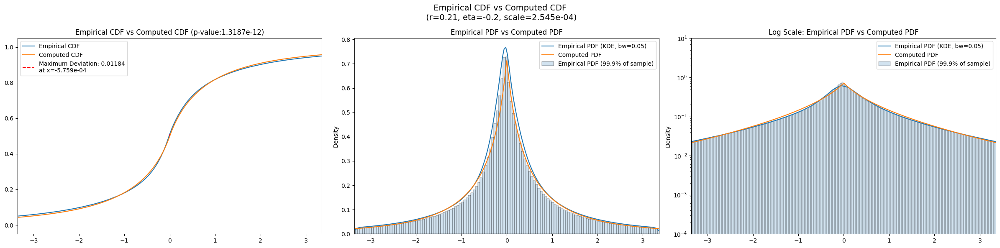

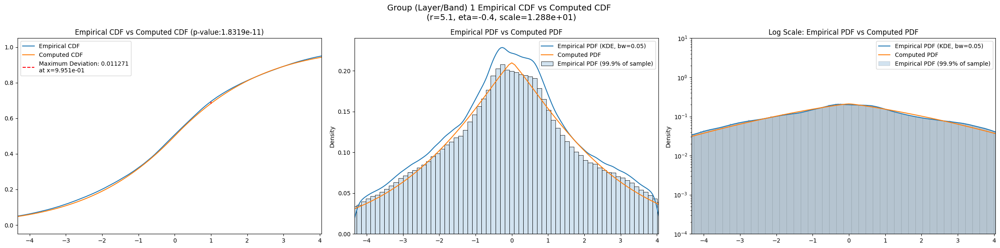

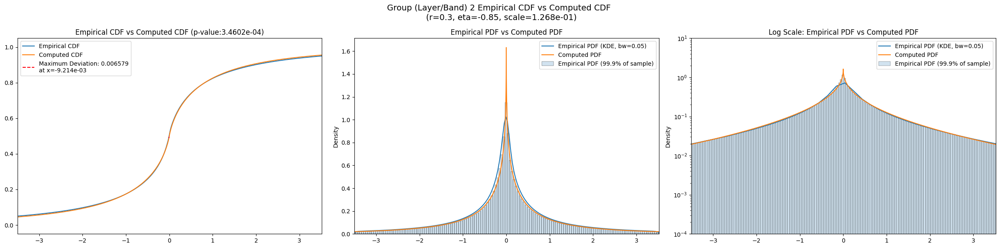

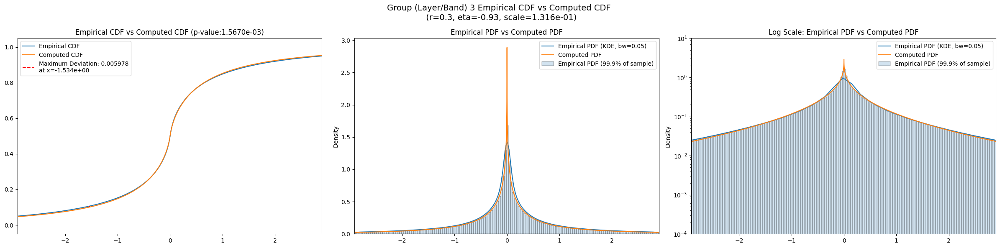

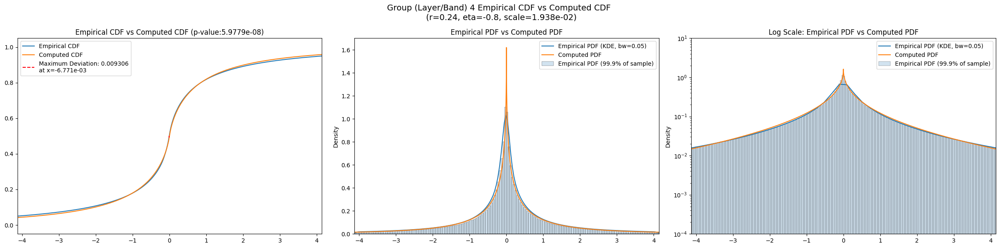

...

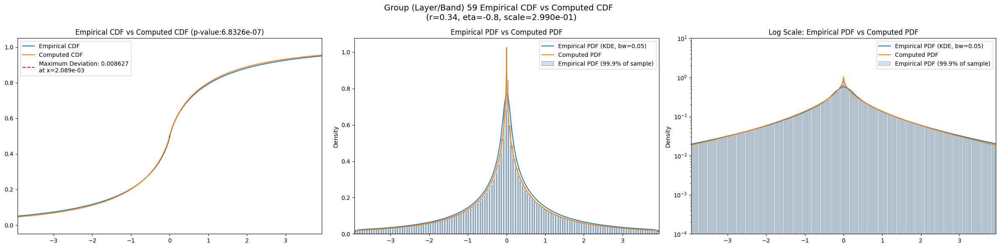

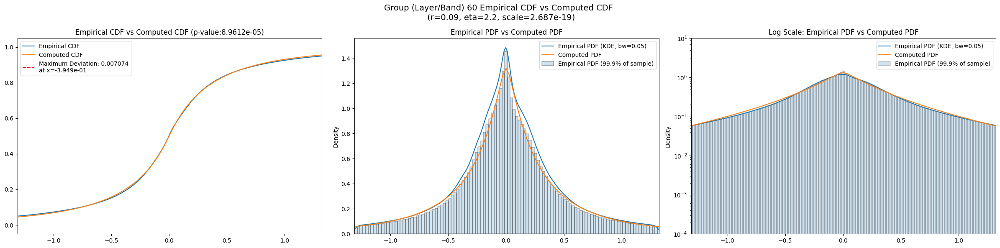

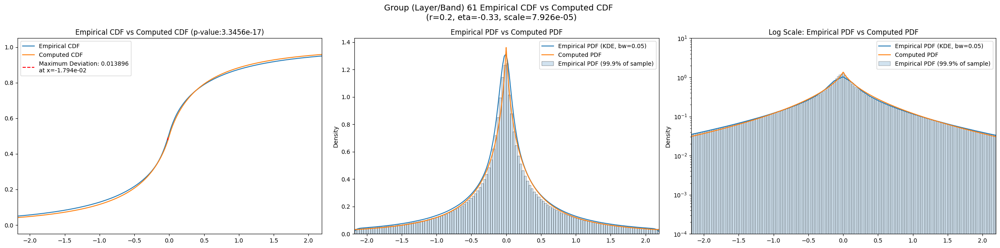

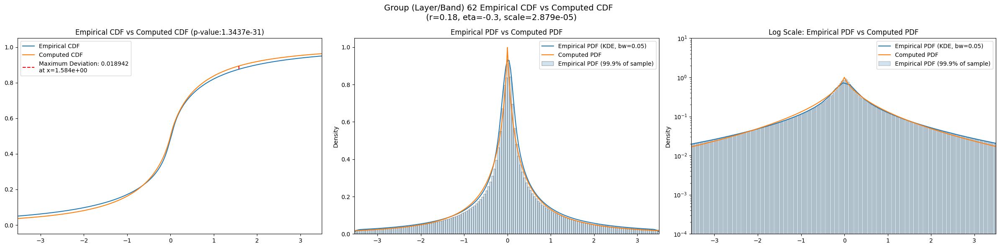

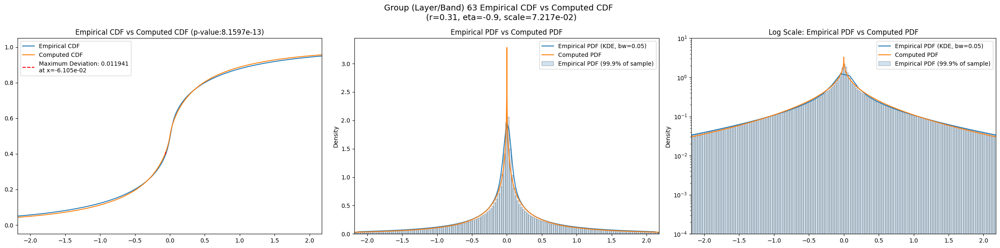

In [15]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = group)
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [16]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [17]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,5.587389,3.885470,13.307504,43.956472,5.678748,345.988257,196608000.0,dual_color,0.011997,0.2,...,1.133550,0.062610,0.0,0.995991,0.035361,0.0,0.787691,0.035127,0.0,0.0
1,6.543445,5.507461,8.010498,2.258367,0.206318,46.515398,196608000.0,misc,0.011271,5.1,...,2.274360,0.024669,0.0,2.011490,0.019153,0.0,1.667970,0.025591,0.0,0.0
2,6.842030,4.740584,16.758177,50.019856,7.108069,371.586526,196608000.0,dual_color,0.008743,0.3,...,1.055490,0.070955,0.0,0.915630,0.045134,0.0,0.711839,0.045962,0.0,0.0
3,4.693403,3.106138,13.014913,80.960090,7.116940,401.350471,196608000.0,single_edge,0.008430,0.4,...,0.836286,0.075557,0.0,0.719216,0.050276,0.0,0.559433,0.051607,0.0,0.0
4,8.801267,6.170591,16.023569,23.755599,7.612705,220.589878,196608000.0,dual_color,0.010902,0.3,...,1.089770,0.078592,0.0,0.950070,0.053017,0.0,0.734857,0.052571,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59,6.993168,5.147639,11.589897,17.092017,4.888674,185.352867,196608000.0,dual_color,0.009239,0.4,...,1.305000,0.065763,0.0,1.125810,0.039713,0.0,0.887454,0.041936,0.0,0.0
60,0.895371,0.619209,2.922394,107.248915,6.033080,506.367796,196608000.0,misc,0.007400,0.1,...,0.505945,0.051148,0.0,0.444119,0.025008,0.0,0.357684,0.021034,0.0,0.0
61,2.702530,1.776317,5.629499,40.835927,7.272000,295.428482,196608000.0,misc,0.014409,0.2,...,0.698056,0.068125,0.0,0.602944,0.041983,0.0,0.475187,0.043972,0.0,0.0


## Results

In [18]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [19]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.011997,0.000097,0.011840,0.062610,0.035361,0.035127
1,0.011271,0.000097,0.011271,0.024669,0.019153,0.025591
2,0.008743,0.000097,0.006579,0.070955,0.045134,0.045962
3,0.008430,0.000097,0.005978,0.075557,0.050276,0.051607
4,0.010902,0.000097,0.009306,0.078592,0.053017,0.052571
...,...,...,...,...,...,...
59,0.009239,0.000097,0.008627,0.065763,0.039713,0.041936
60,0.007400,0.000097,0.007074,0.051148,0.025008,0.021034
61,0.014409,0.000097,0.013896,0.068125,0.041983,0.043972


In [20]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,4.955935,0.011840,0.21,-0.20,2.544954e-04,75.0
1,6.543445,0.011271,5.10,-0.40,1.287905e+01,0.0
2,6.134035,0.006579,0.30,-0.85,1.268390e-01,50.0
3,4.693403,0.005978,0.30,-0.93,1.315680e-01,0.0
4,8.801267,0.009306,0.24,-0.80,1.938382e-02,0.0
...,...,...,...,...,...,...
59,6.993168,0.008627,0.34,-0.80,2.990489e-01,0.0
60,0.813192,0.007074,0.09,2.20,2.686925e-19,25.0
61,2.173341,0.013896,0.20,-0.33,7.925602e-05,150.0
